In [1]:
library(spatstat.explore)
library(Seurat)
library(dplyr)
library(repr)
library(ggplot2)
library(patchwork)
library(stringr)
library(RColorBrewer)
library(tidyr)

Loading required package: spatstat.data

Loading required package: spatstat.univar

spatstat.univar 3.1-1

Loading required package: spatstat.geom

spatstat.geom 3.3-5

Loading required package: spatstat.random

spatstat.random 3.3-2

Loading required package: nlme

spatstat.explore 3.3-4

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t



Attaching package: ‘dplyr’


The following object is masked from ‘package:nlme’:

    collapse


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘patchwork’


The following object is masked from ‘package:spatstat.geom’:

    area




# Read data

In [28]:
library(Matrix)
dir <- ("/sc-projects/sc-proj-dh-promethion/epi2me-labs_wf-single-cell/ONT_wf_krissi/wf_v2.0.2/")
ont_list <- list()
for(sample in c(paste0("COVID", 0:12),"C133", "C137", "C21")){
    if(file.exists(paste0(dir,sample, "_output/", sample, "/gene.expression.mito-per-cell.tsv"))){
        message(sample)
        
        ##read gene expression into seurat object
        tmp_geneCounts <-readMM(paste0(dir,sample,"_output/", sample, "/gene_raw_feature_bc_matrix/matrix.mtx.gz"))
        rownames(tmp_geneCounts) <- read.table(paste0(dir,sample,"_output/", sample, "/gene_raw_feature_bc_matrix/features.tsv.gz"))$V2
        cols <- read.table(paste0(dir,sample,"_output/", sample,"/gene_raw_feature_bc_matrix/barcodes.tsv.gz"))$V1
        colnames(tmp_geneCounts) <- str_replace(cols, "-1", "")
        tmp_seurat_object <- CreateSeuratObject(counts = tmp_geneCounts, min.features = 200, project = sample)

        ##read transcript expression and filter cells based on gene-level seurat object
        tmp_transcriptCounts <-readMM(paste0(dir,sample,"_output/", sample, "/transcript_raw_feature_bc_matrix/matrix.mtx.gz"))
        rownames(tmp_transcriptCounts) <- read.table(paste0(dir,sample,"_output/", sample, "/transcript_raw_feature_bc_matrix/features.tsv.gz"))$V2
        cols <- read.table(paste0(dir,sample,"_output/", sample,"/transcript_raw_feature_bc_matrix/barcodes.tsv.gz"))$V1
        colnames(tmp_transcriptCounts) <- str_replace(cols, "-1", "")

        ##weirdly not all BCs present in gene expression matrix are present in transcript exp matrix
        presentBCs <- colnames(tmp_seurat_object)[colnames(tmp_seurat_object) %in% colnames(tmp_transcriptCounts)]
        tmp_transcriptCounts <- tmp_transcriptCounts[,presentBCs]
        
        ##add transcript expression as new assay
        tmp_seurat_object[["Transcript"]] <- CreateAssayObject(tmp_transcriptCounts)

        ont_list[[sample]] <- tmp_seurat_object
    }
}


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


COVID0

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID1

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID2

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID3

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID4

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID5

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID6

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID7

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID8

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID9

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID10

Warning message:
“Data is of class dgTMatrix. Coercing to dgCMatrix.”
COVID11

Warning message:
“

In [29]:
##short read information

cellType_COVID = read.table('/home/koehlk/wf-sc/short_read_annotation/COVID19_NBT1_cellID_celltype_sample.csv', sep = ',', header = TRUE)
cellType_COVID$cellID_general <- sapply(strsplit(cellType_COVID$cellID,"_"), `[`, 1)

cellType_C133_137 = read.table('/home/koehlk/wf-sc/short_read_annotation/COVID19_RECAST_cellID_celltype_sample.csv', sep = ',', header = TRUE)
cellType_C133_137$cellID_general <- sapply(strsplit(cellType_C133_137$cellID,"-"), `[`, 1)

cellType_C21 = read.table('/home/koehlk/wf-sc/short_read_annotation/COVID19_LC_nasal_swab_cellID_celltype.csv', sep = ',', header = TRUE)
cellType_C21$sample <- 'C21'
cellType_C21$cellID_general <- sapply(strsplit(cellType_C21$cellID,"-"), `[`, 1)

cellTypes_total <- rbind(cellType_COVID, cellType_C133_137, cellType_C21)

dict <- c('c8_3'='COVID0', 'c5_2'='COVID1', 'c7_3'='COVID2', 'c19_5'='COVID3', 'c24_5'='COVID4', 
          'c15_5'='COVID5', 'c25_5'='COVID6','bicu_1'='COVID9', 'bicu_2'='COVID11', 
          'SC2-50137-NS01'='C133', 'SC2-50133-NS01'='C137', 'C21'='C21')

cellTypes_total <- cellTypes_total %>% subset(sample %in% names(dict))
cellTypes_total <- cellTypes_total %>%
  mutate(mySampleID = sapply(sample, function(x) dict[[x]]))

cellTypes_total <- cellTypes_total %>% dplyr::select(mySampleID, cellID_general, celltype)

for(sample in names(ont_list)){
    message(sample)
    cellTypes_subset <- cellTypes_total %>% subset(mySampleID==sample)
    cellType_ordered <- cellTypes_subset[match(colnames(ont_list[[sample]]), cellTypes_subset$cellID_general),]$celltype
    cellType_ordered[is.na(cellType_ordered)] <- 'NotInSRs'
    ont_list[[sample]] <- AddMetaData(ont_list[[sample]], 
                                                  cellType_ordered,
                                                  col.name = 'short_read_annotation')
    
}


COVID0

COVID1

COVID2

COVID3

COVID4

COVID5

COVID6

COVID7

COVID8

COVID9

COVID10

COVID11

COVID12

C133

C137

C21



In [ ]:
ont_list$COVID11[[]] |> group_by(short_read_annotation) |> summarise(n())

# QC and filtering 

In [11]:
summary(ont_list$C133[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    200     984    1591    1578    2123    5163 

In [12]:
summary(ont_list$C137[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    200    1805    2726    2664    3511    7600 

In [13]:
summary(ont_list$C21[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    200    1458    2136    2108    2735    6238 

In [14]:
summary(ont_list$COVID1[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    200    2873    5820    5792    8728   13627 

In [15]:
summary(ont_list$COVID2[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    200    1437    3132    3256    4746   11443 

In [16]:
summary(ont_list$COVID3[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  201.0   314.5   578.0  2324.4  3994.5 12959.0 

In [17]:
summary(ont_list$COVID4[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  200.0   932.5  3336.5  3341.7  4975.8 13237.0 

In [18]:
summary(ont_list$COVID5[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    200     344    2872    3428    6238   10727 

In [19]:
summary(ont_list$COVID6[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  201.0   294.5   785.0  2227.1  3686.5 11117.0 

In [20]:
summary(ont_list$COVID9[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  200.0   570.0   737.0   977.4  1081.2  9345.0 

In [21]:
summary(ont_list$COVID12[[]]$nFeature_RNA)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  202.0   799.8   966.5  1464.8  1314.2 12872.0 

In [30]:
vln_list = list()
scatter_list = list()
##add QC metrics and plot
for (i in names(ont_list)){
    ont_list[[i]][["percent.mt"]] <- PercentageFeatureSet(ont_list[[i]], pattern = "^MT-")

    vln_list[[i]] = VlnPlot(ont_list[[i]], features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), pt.size = 0.1, ncol = 3) + NoLegend()
    scatter_list[[i]] = FeatureScatter(ont_list[[i]], "nCount_RNA", "nFeature_RNA", pt.size = 0.5)
}

Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Warning message:
“Default search for "da

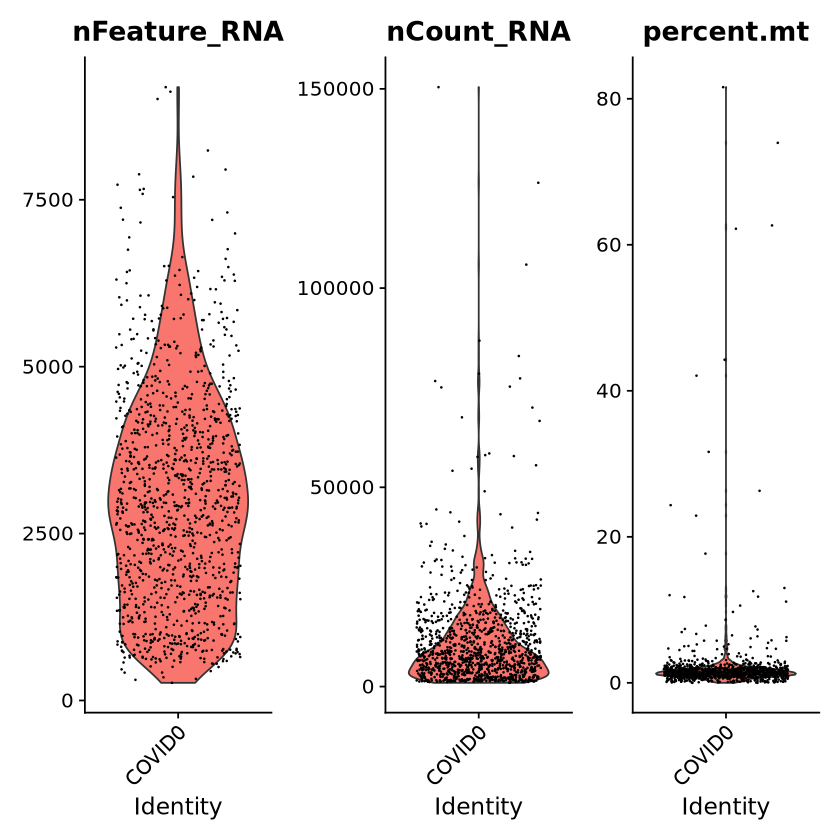

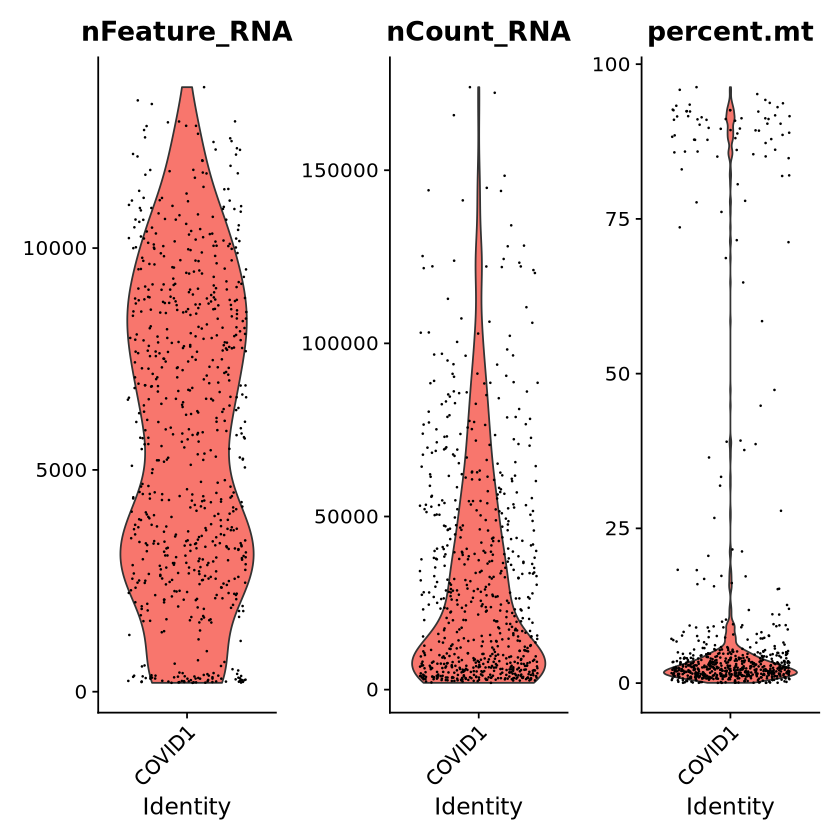

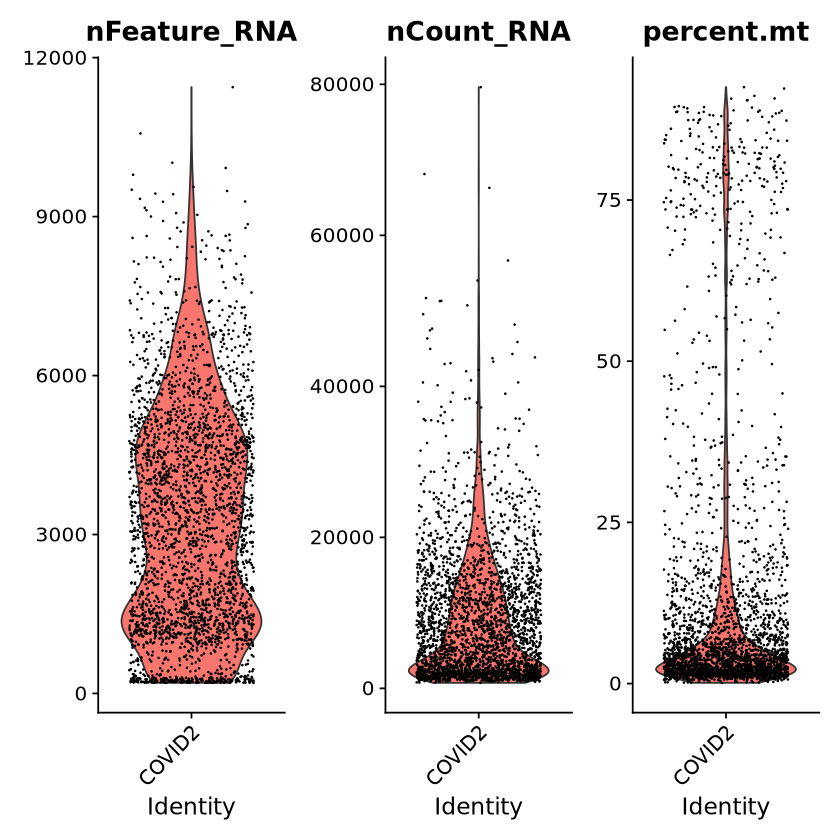

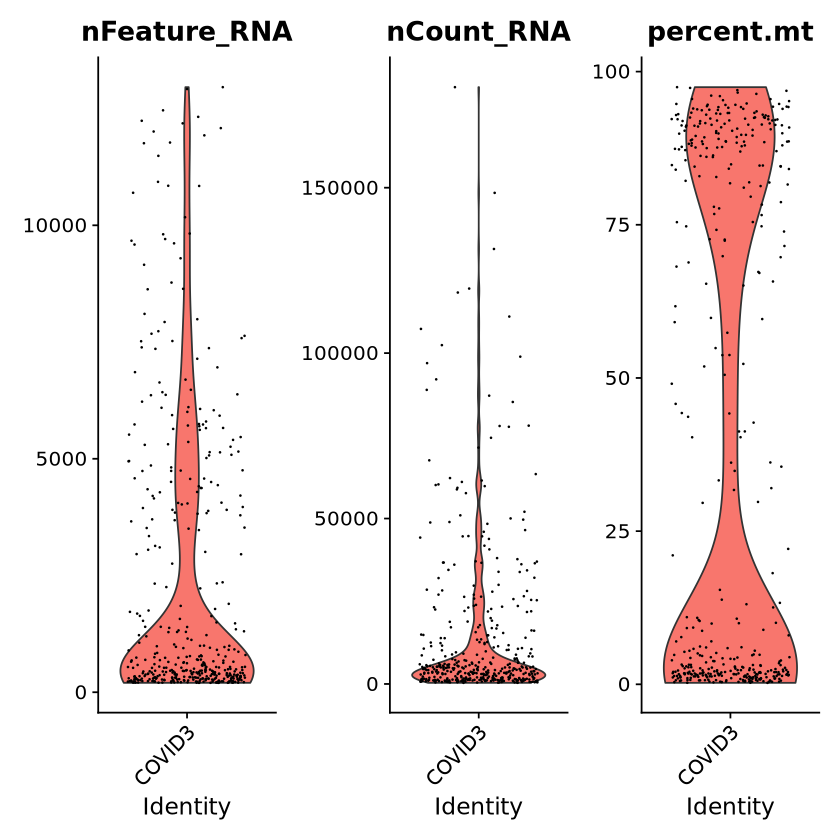

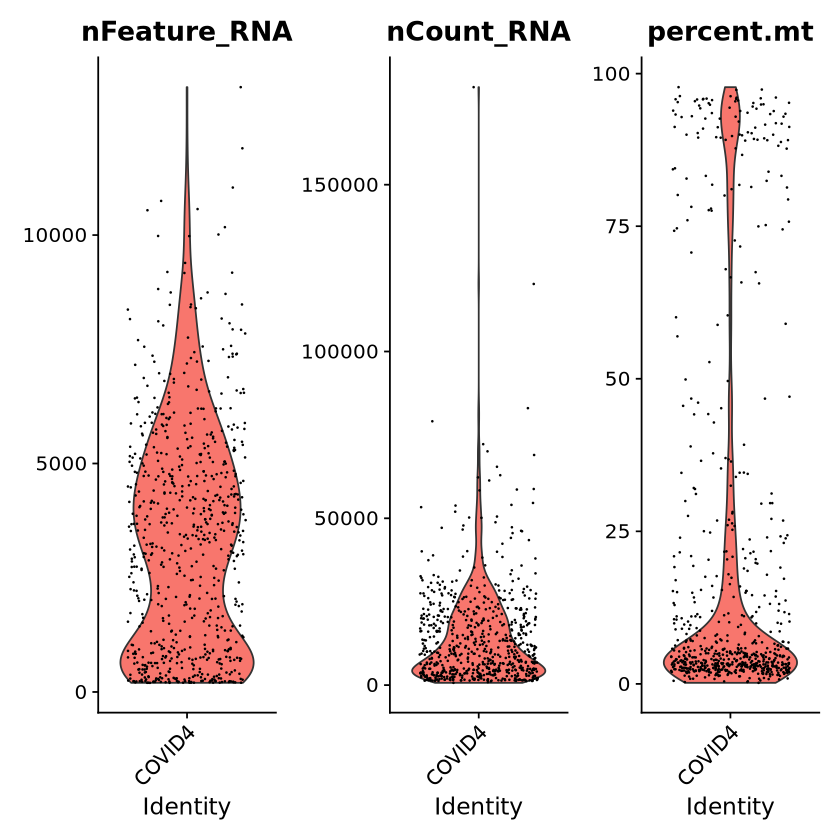

...

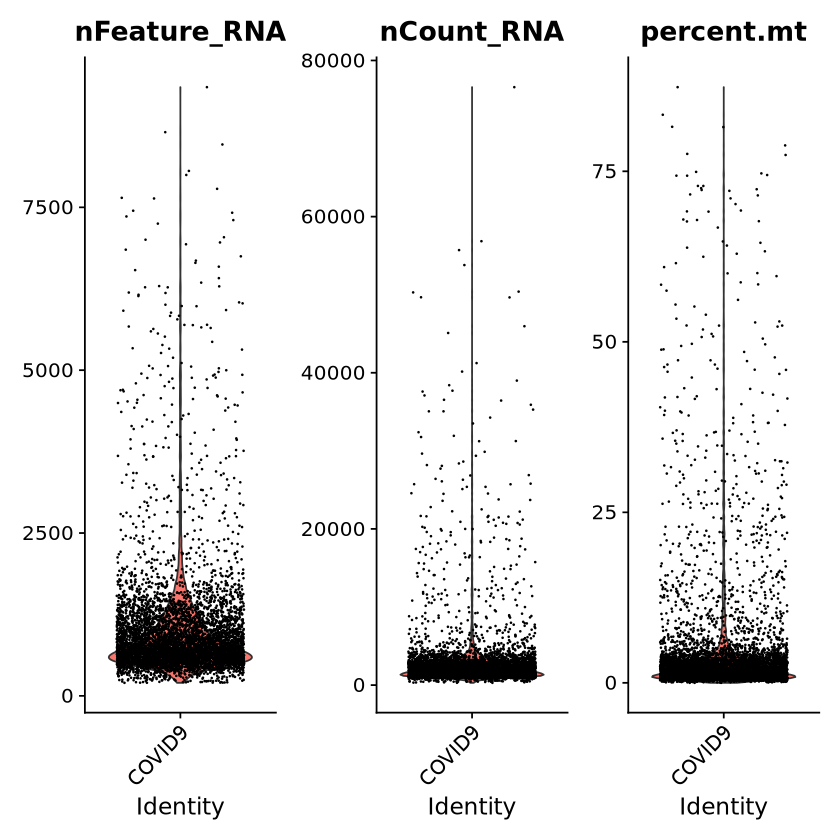

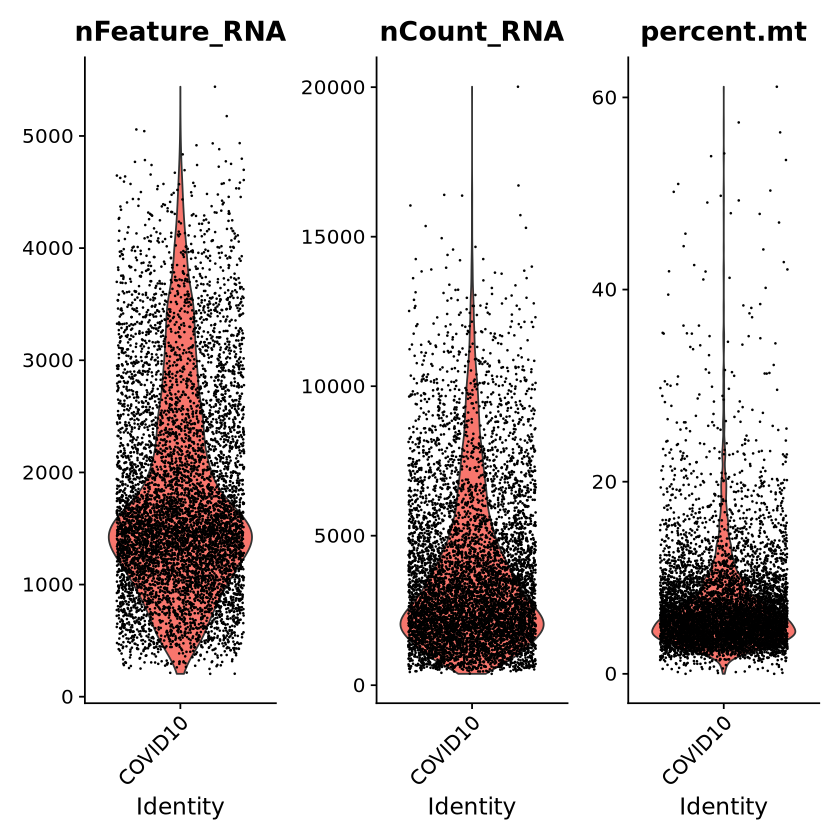

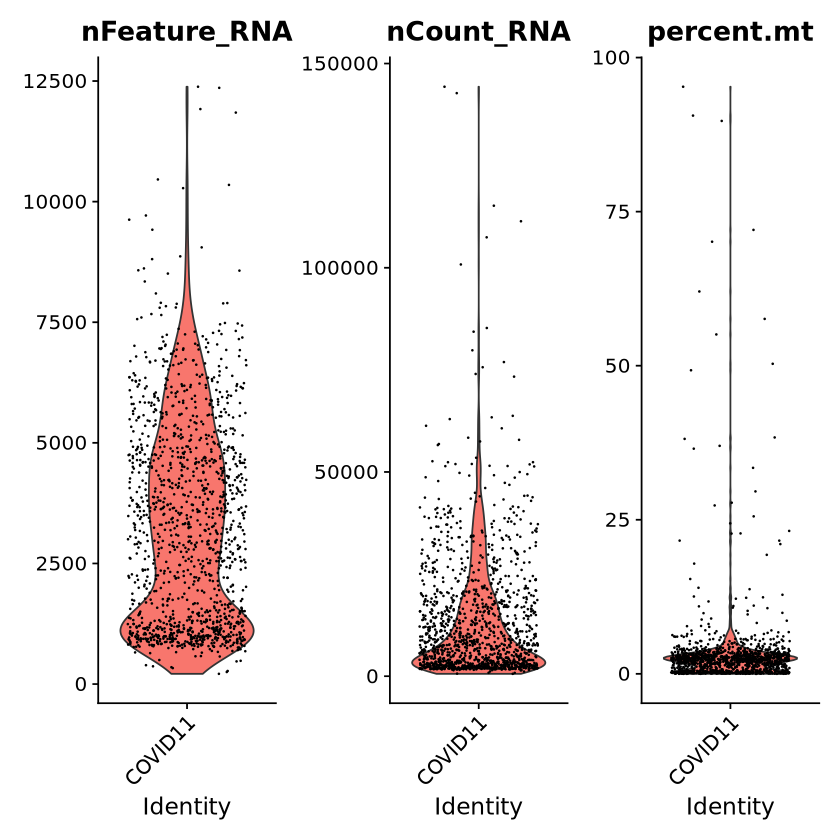

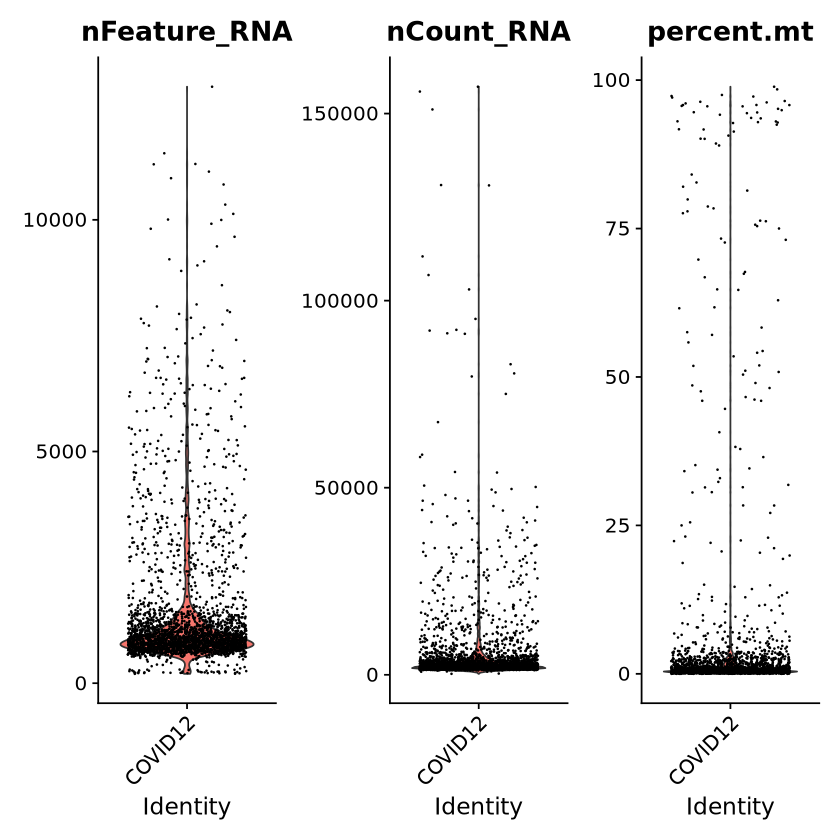

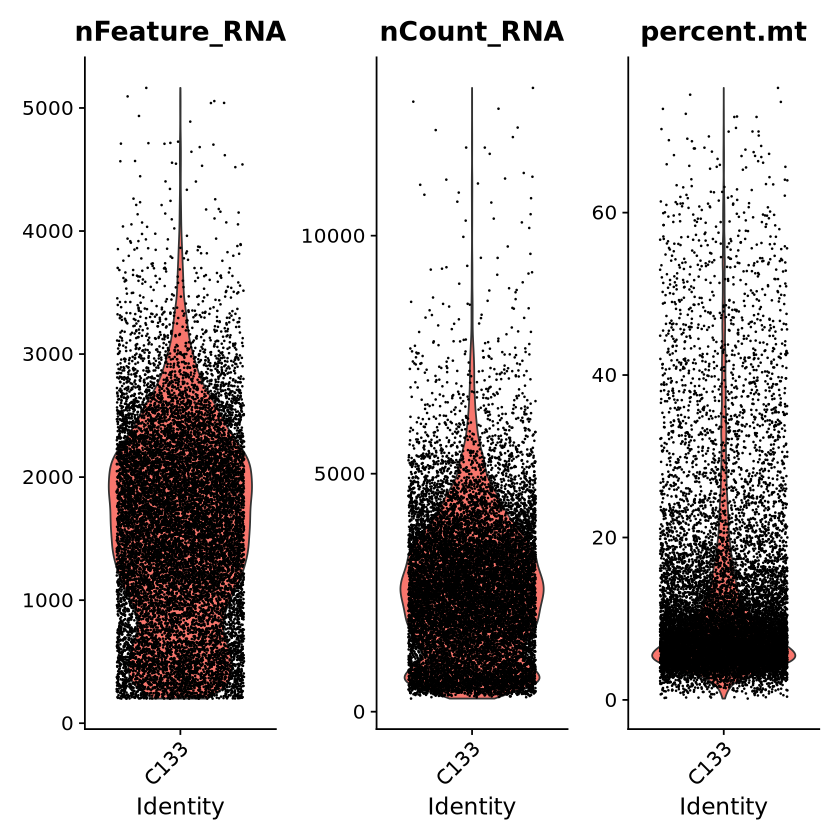

$COVID0

$COVID1

$COVID2

$COVID3

$COVID4

$COVID5

$COVID6

$COVID7

$COVID8

$COVID9

$COVID10

$COVID11

$COVID12

$C133

$C137

$C21


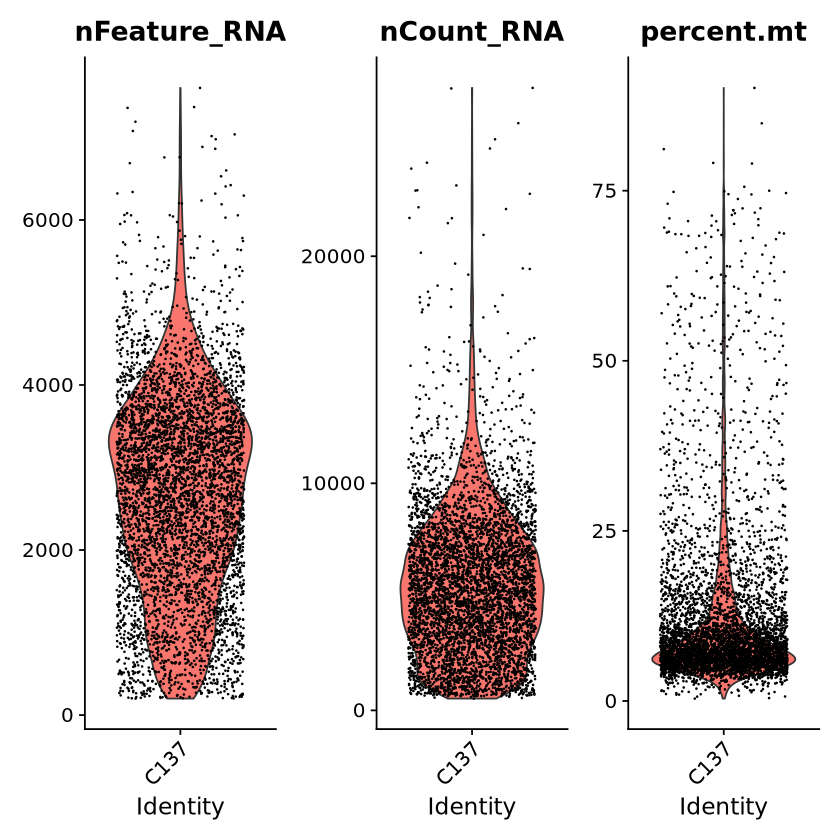

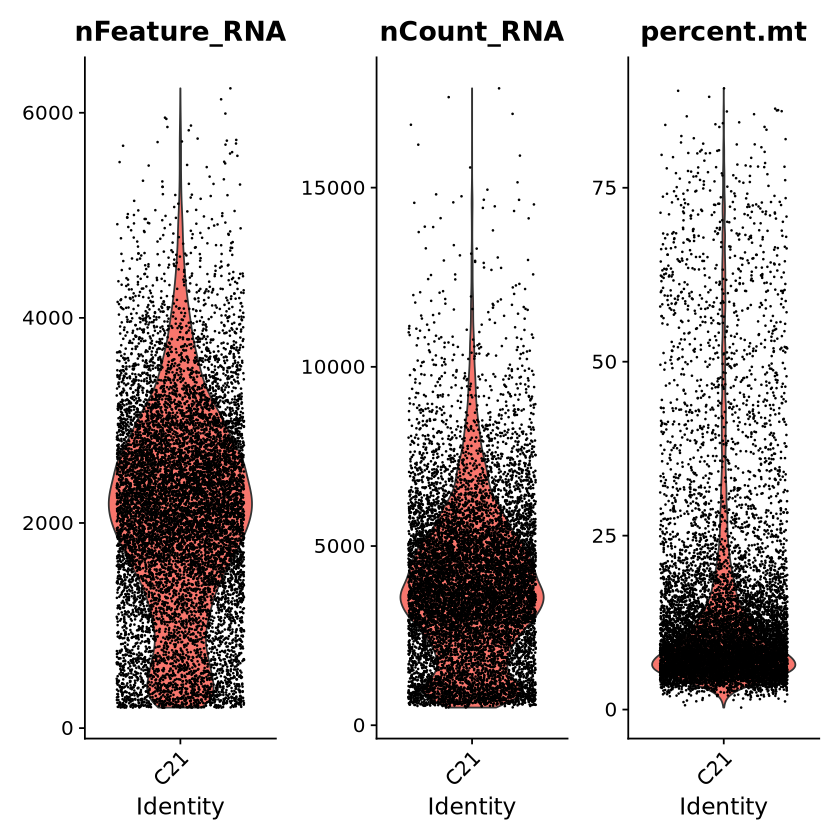

In [23]:
vln_list

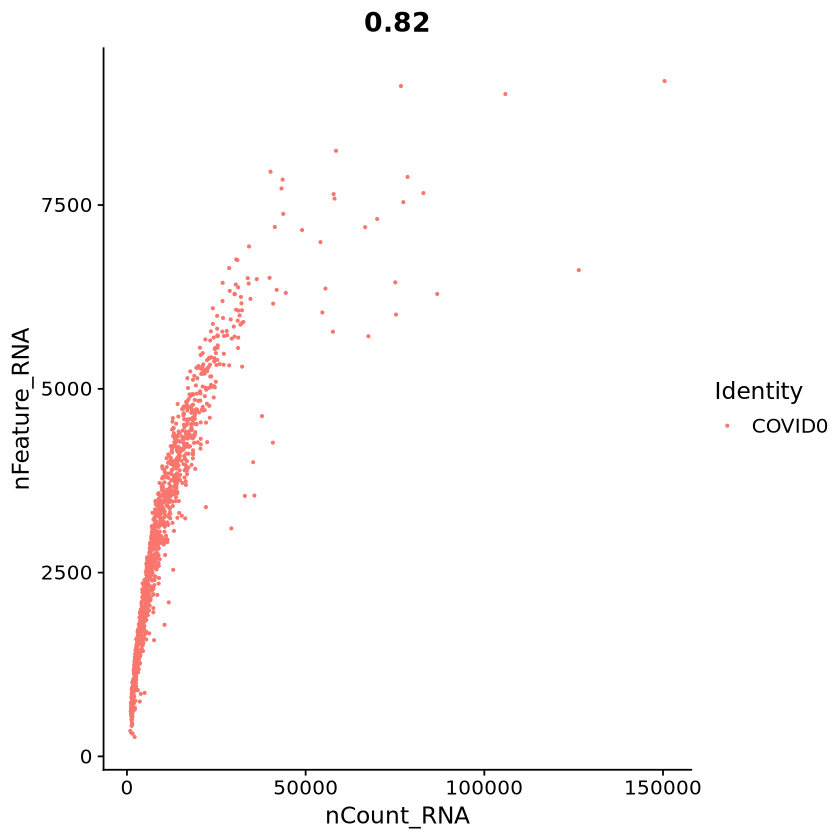

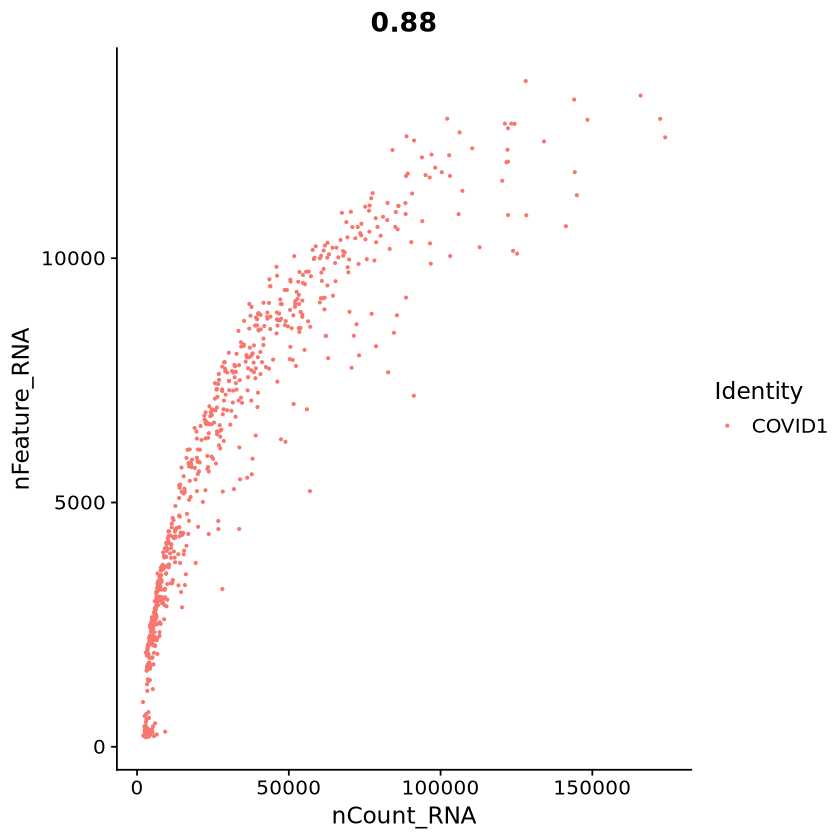

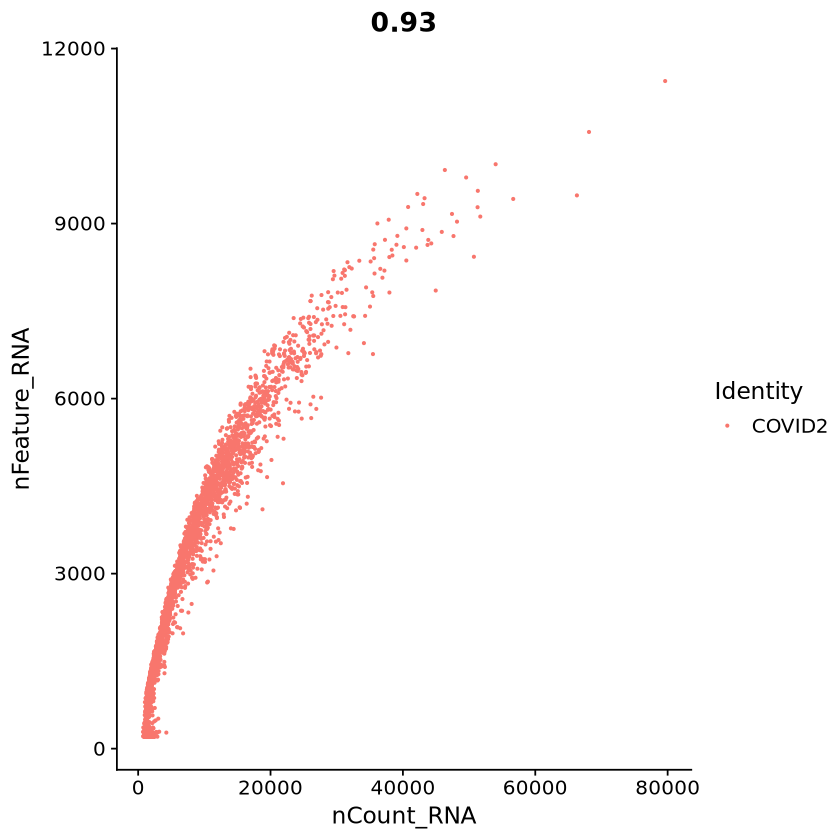

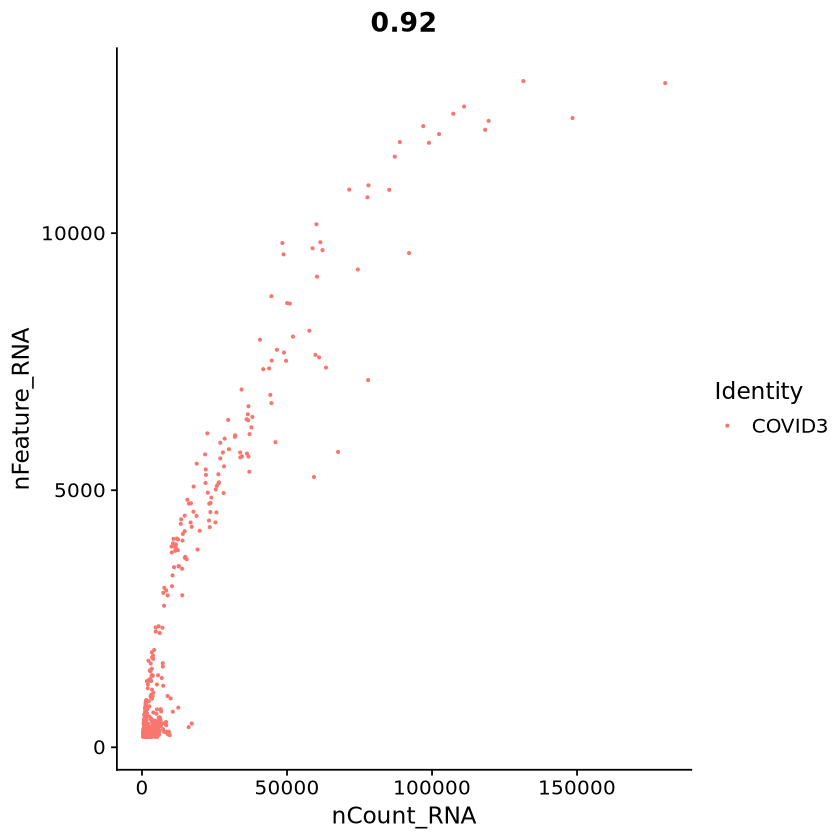

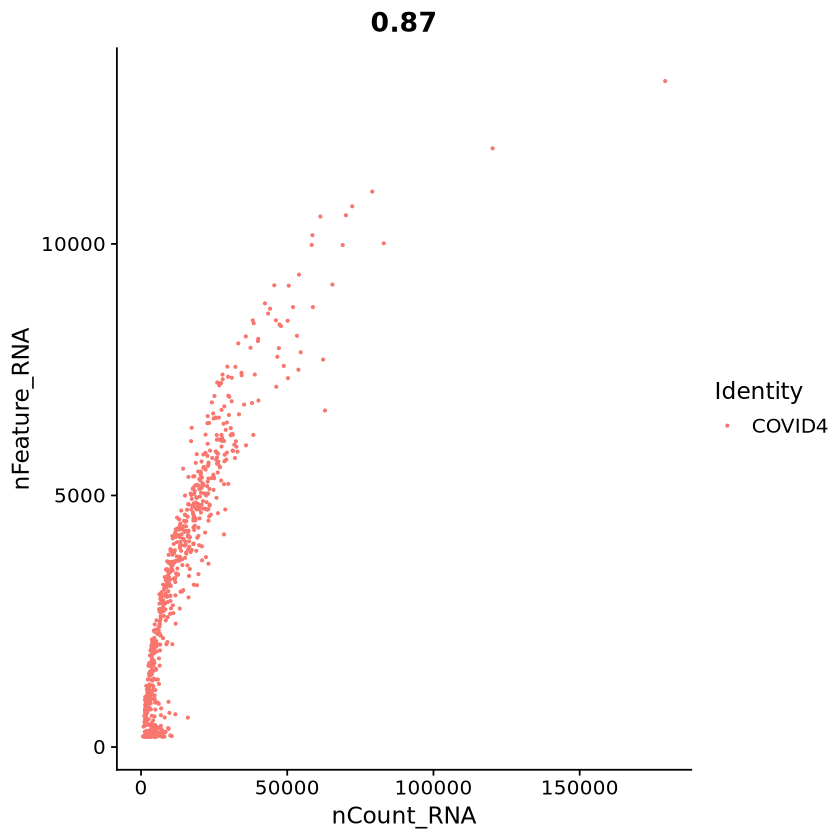

...

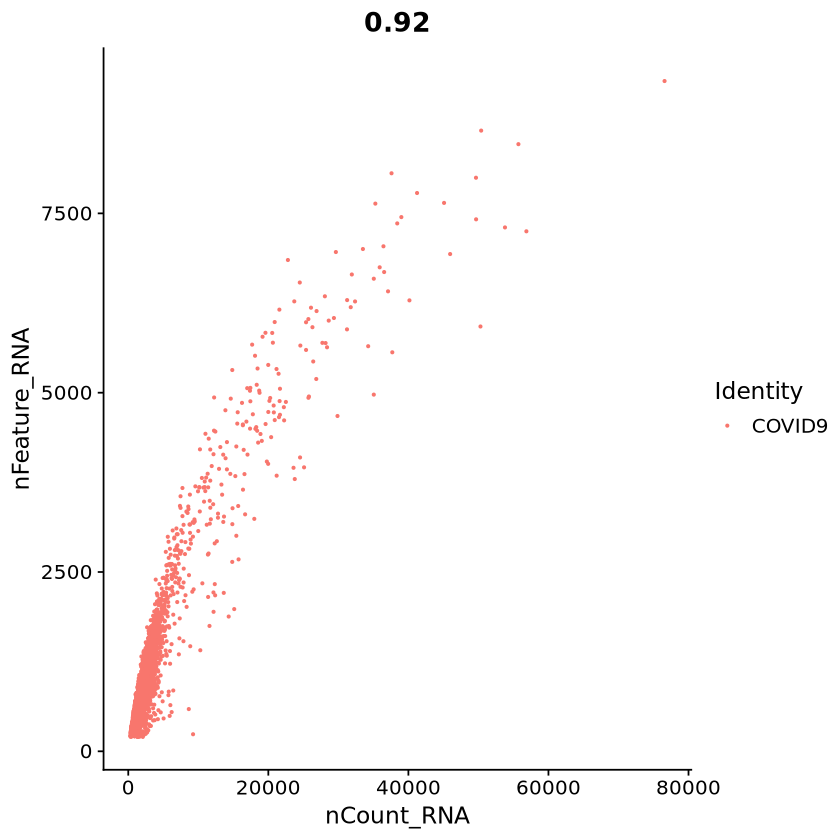

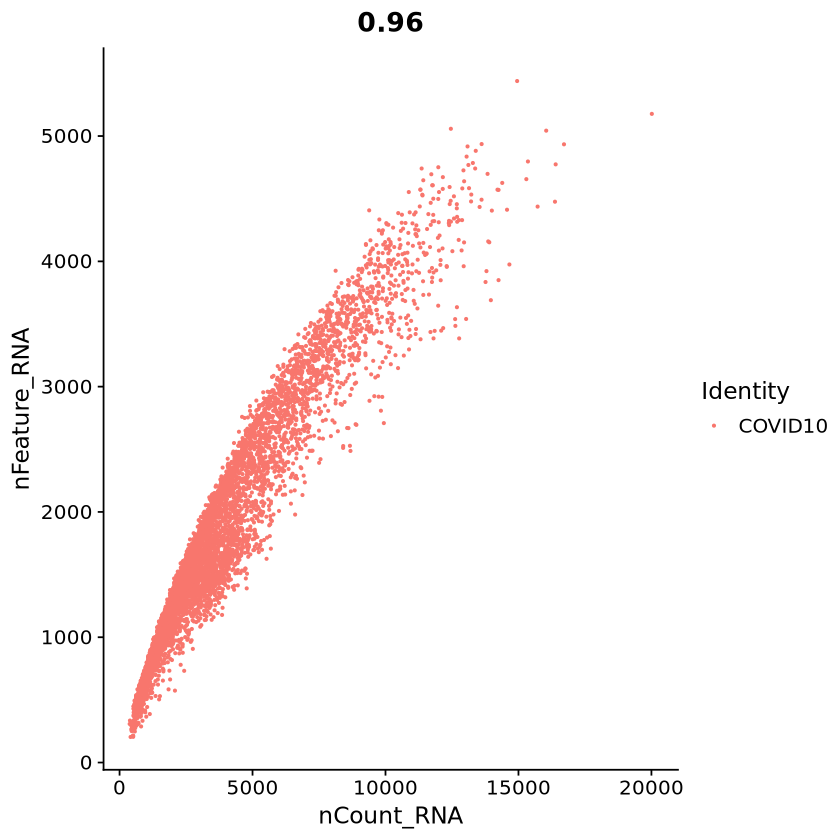

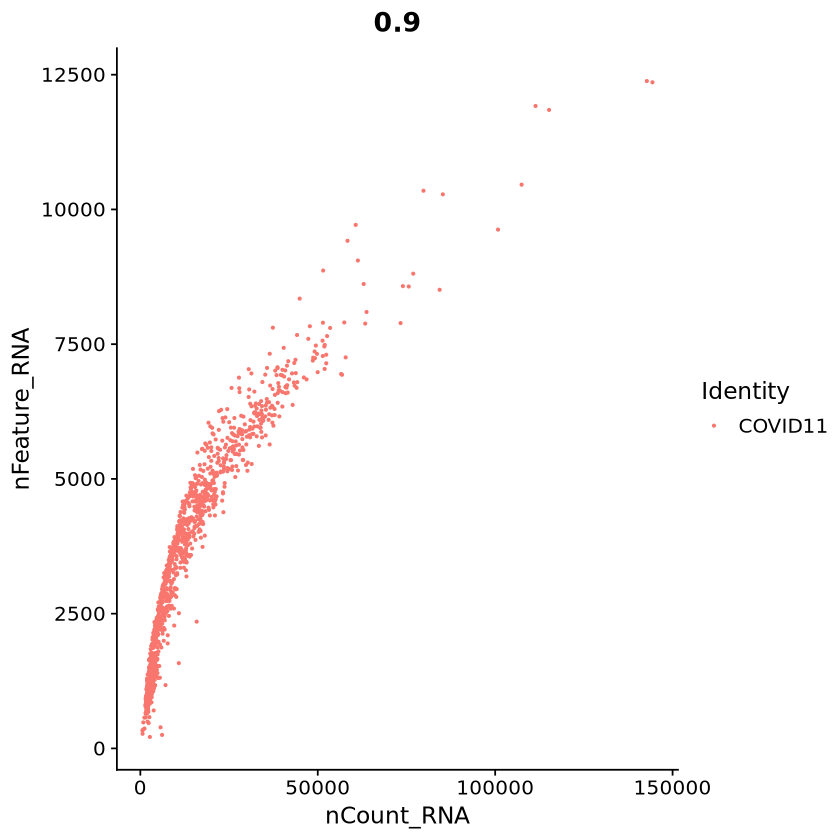

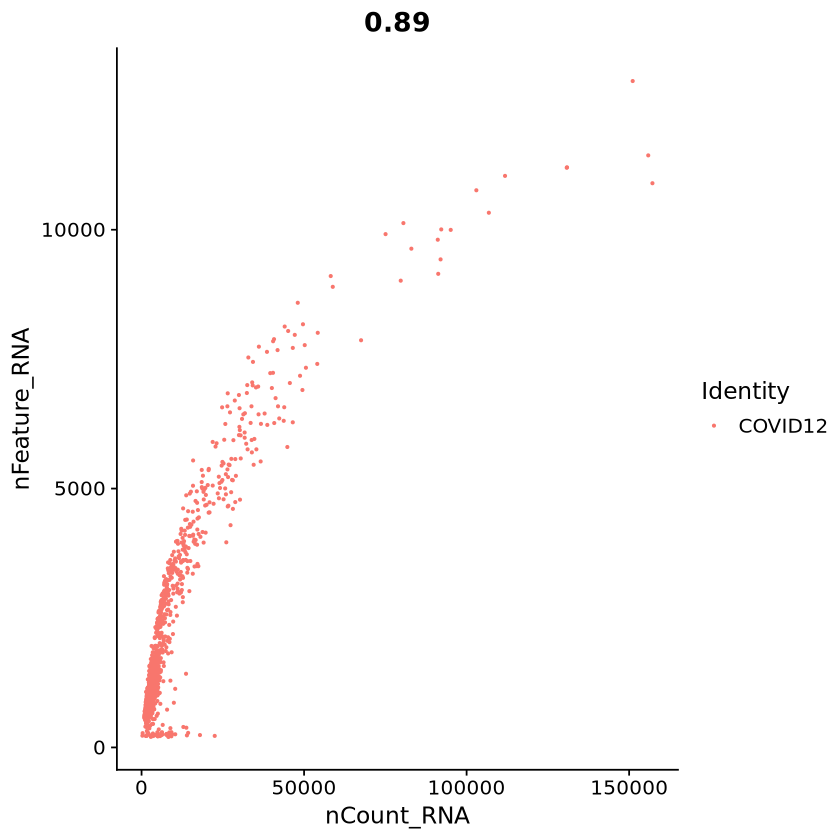

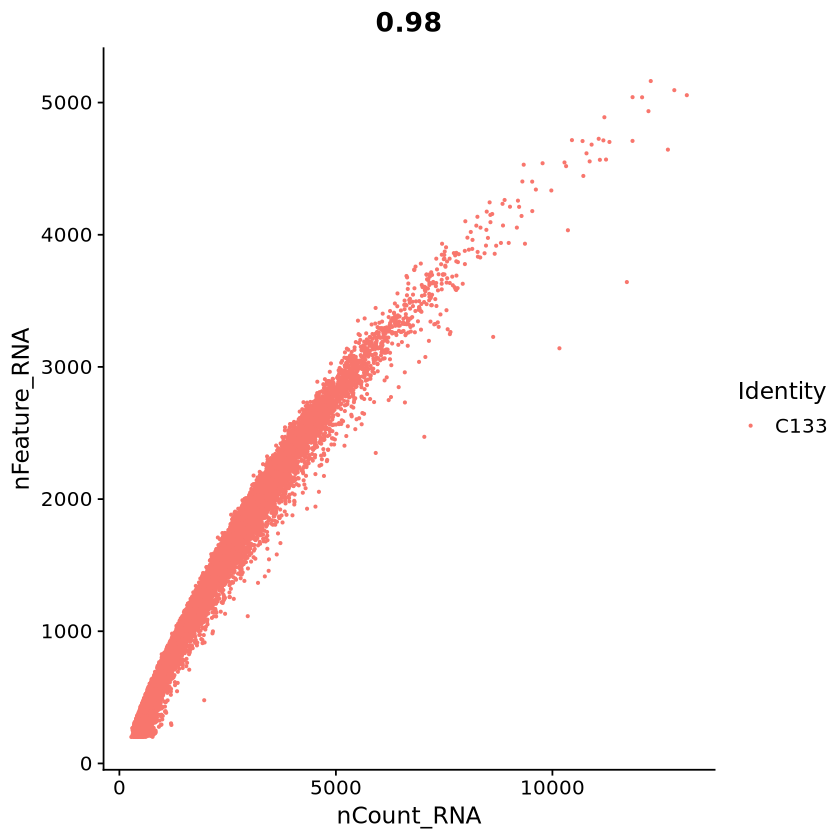

$COVID0

$COVID1

$COVID2

$COVID3

$COVID4

$COVID5

$COVID6

$COVID7

$COVID8

$COVID9

$COVID10

$COVID11

$COVID12

$C133

$C137

$C21


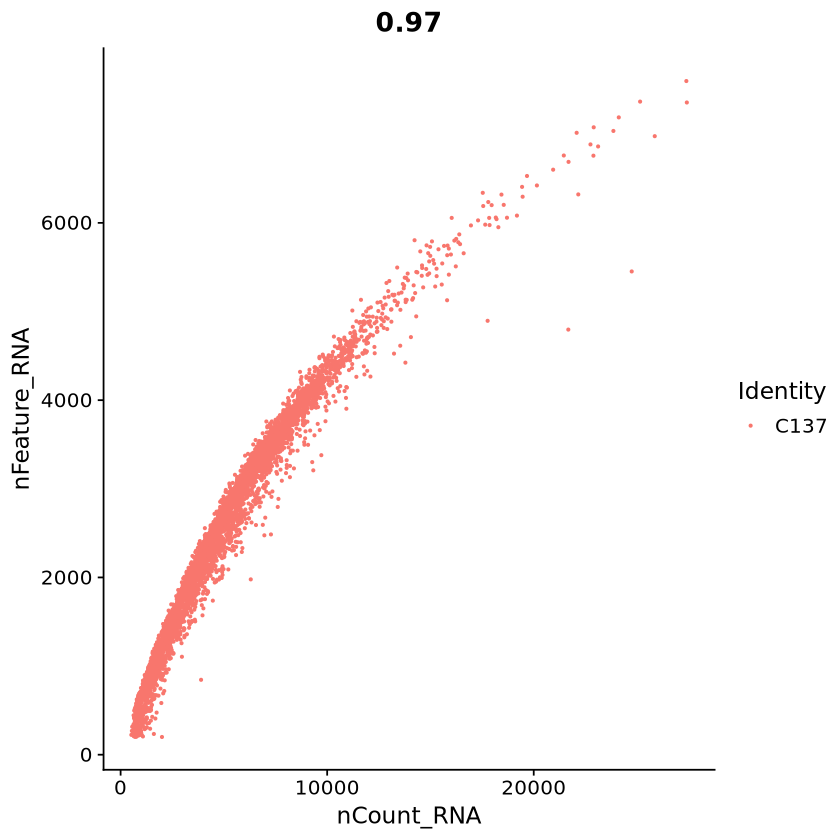

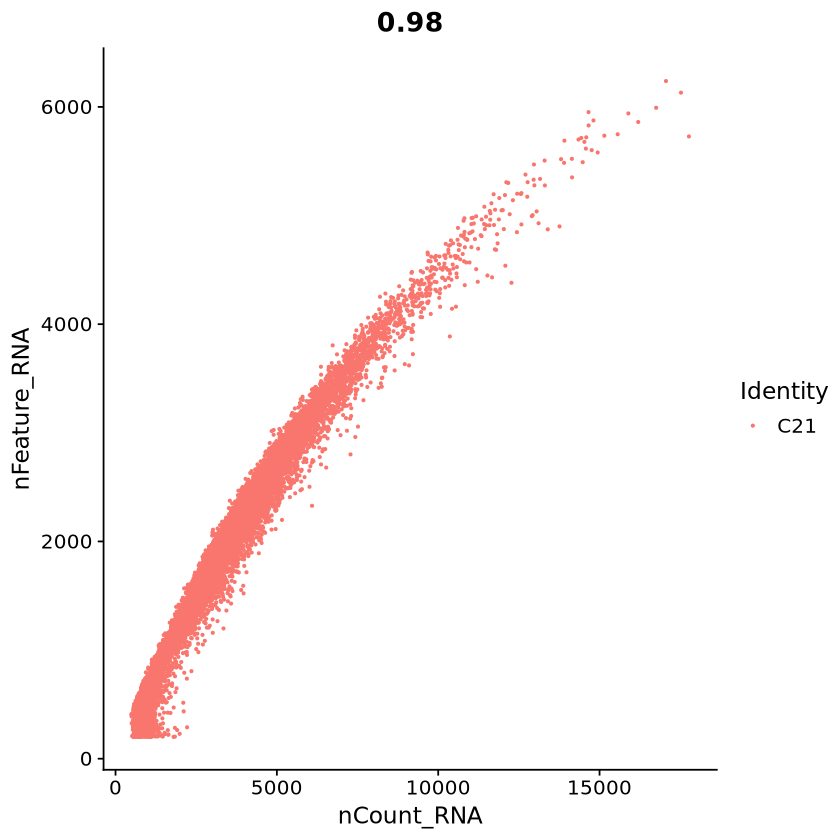

In [24]:
scatter_list

In [31]:
tresholds <- c(50000, 100000, 50000, 75000, 80000, 60000, 40000, 22000, 60000, 40000, 15000, 75000, 80000, 10000, 20000, 15000)

In [32]:
i = 1
for (sample in names(ont_list)){
    scatter_list[[i]] = FeatureScatter(ont_list[[sample]], "nCount_RNA", "nFeature_RNA", pt.size = 0.5) + geom_vline(xintercept = tresholds[i])
    i = i + 1
}

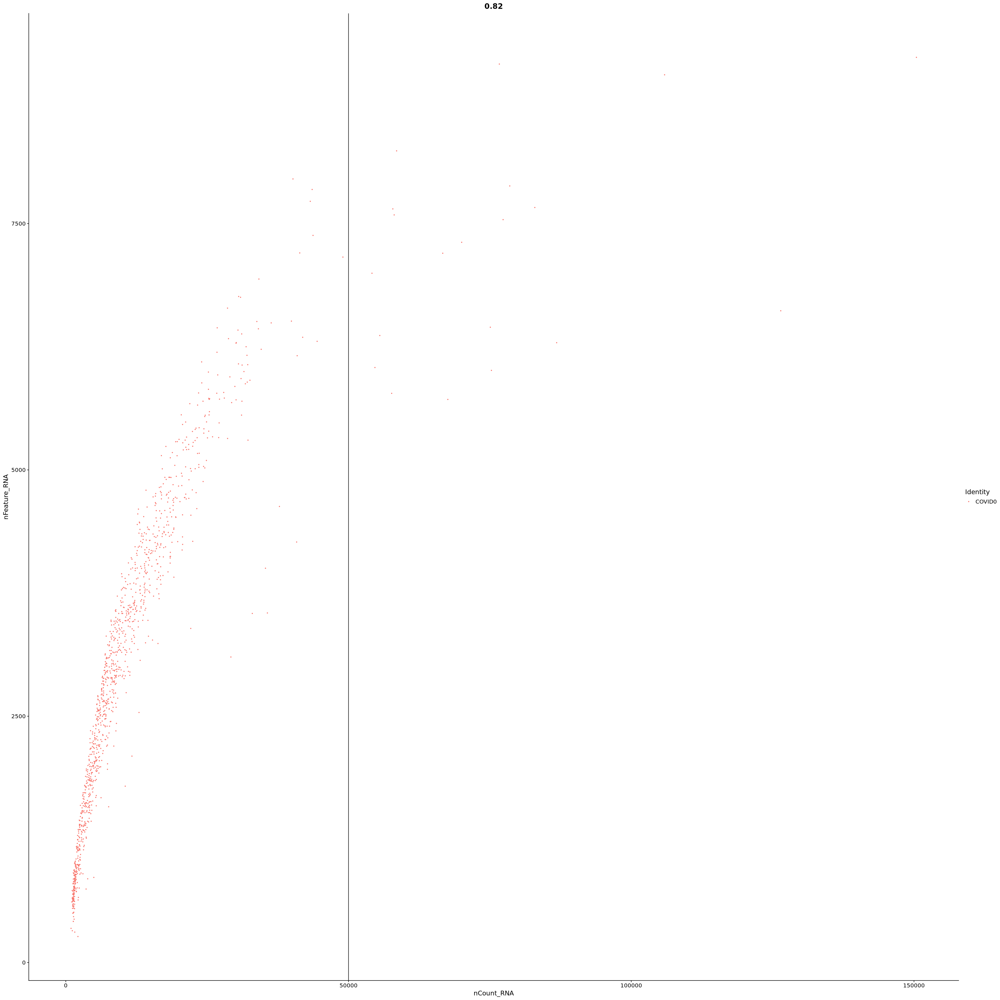

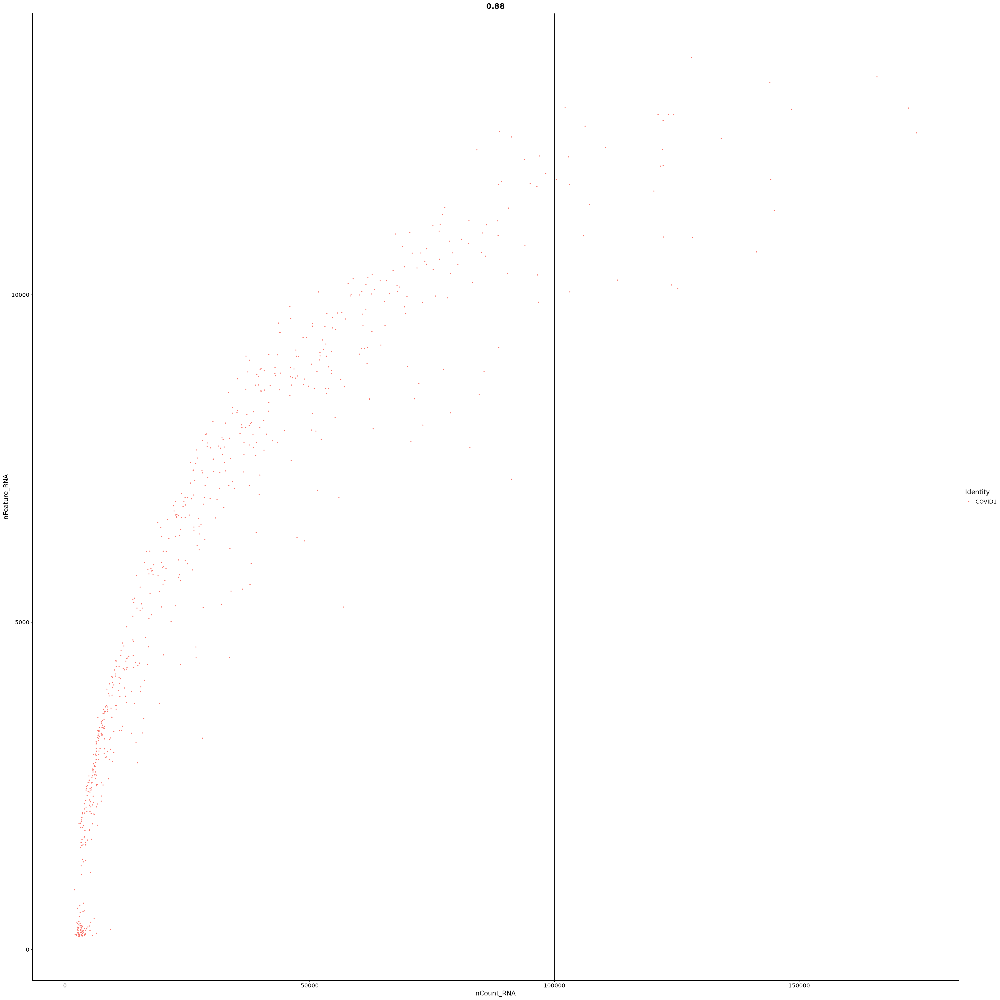

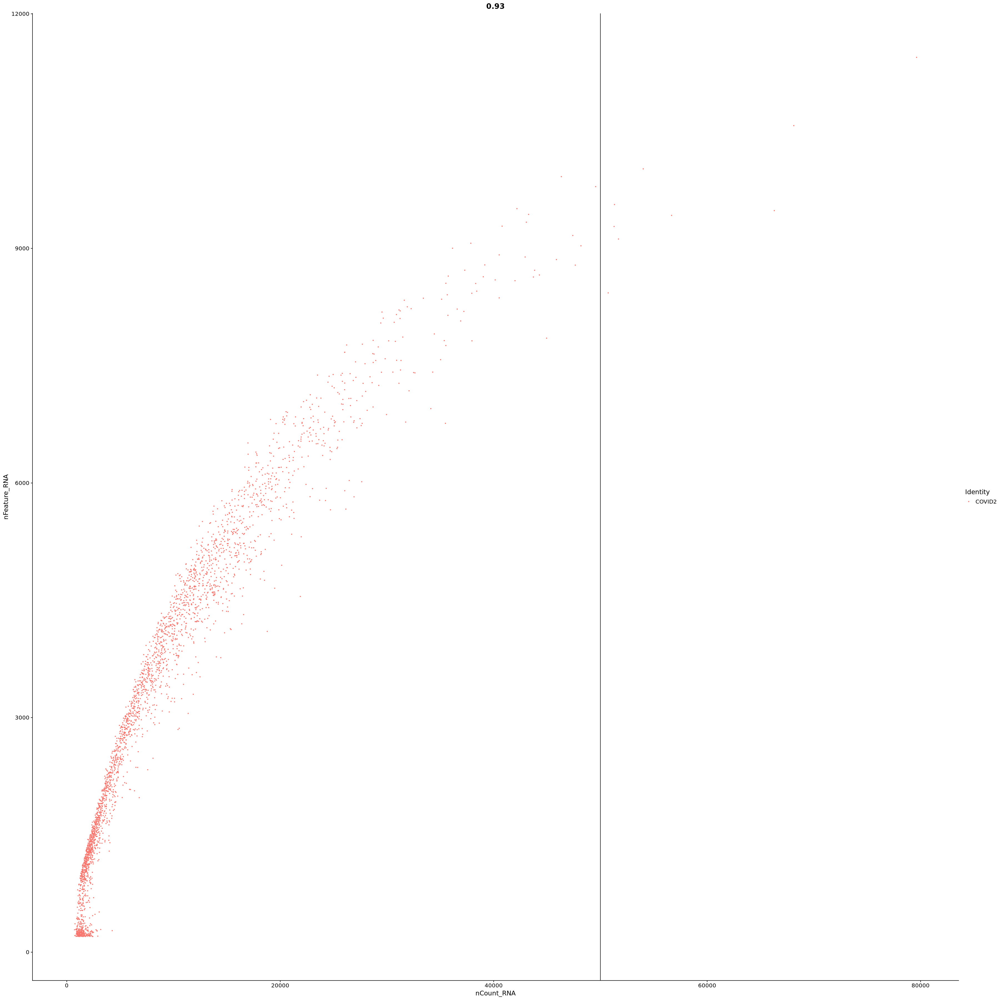

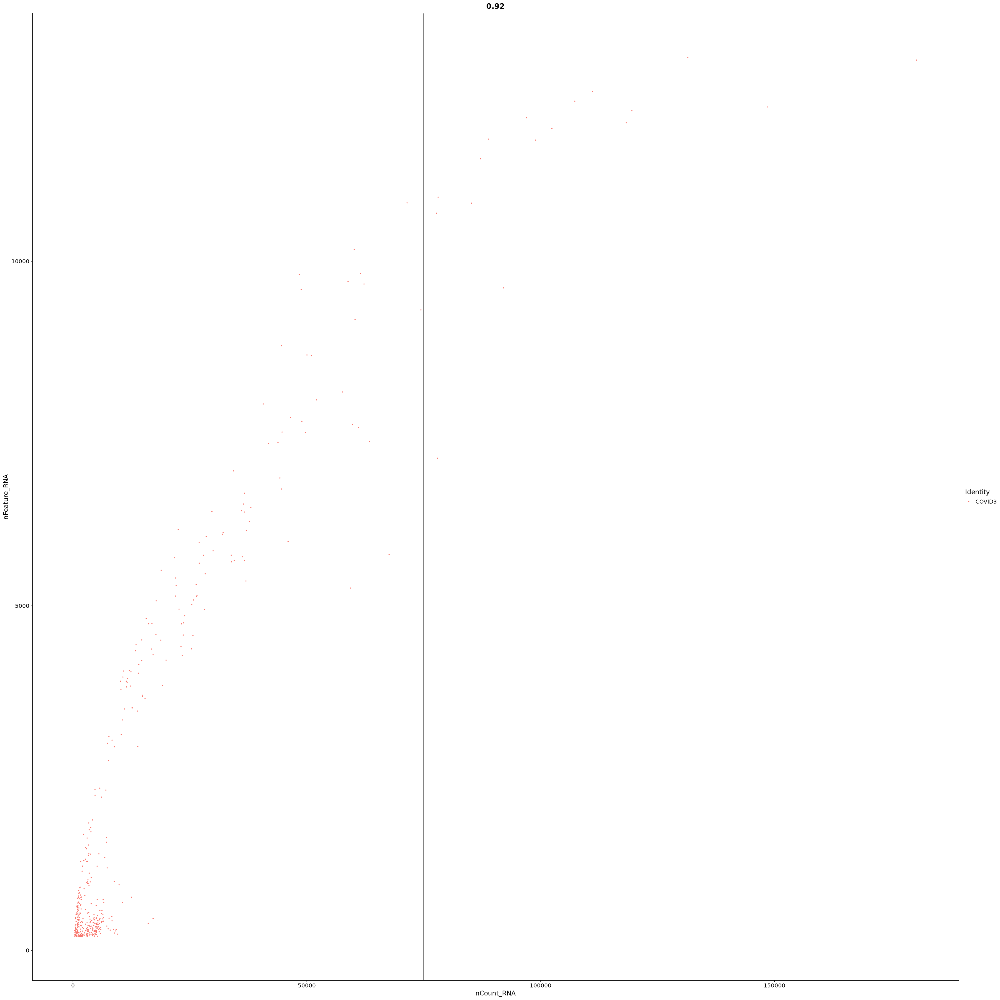

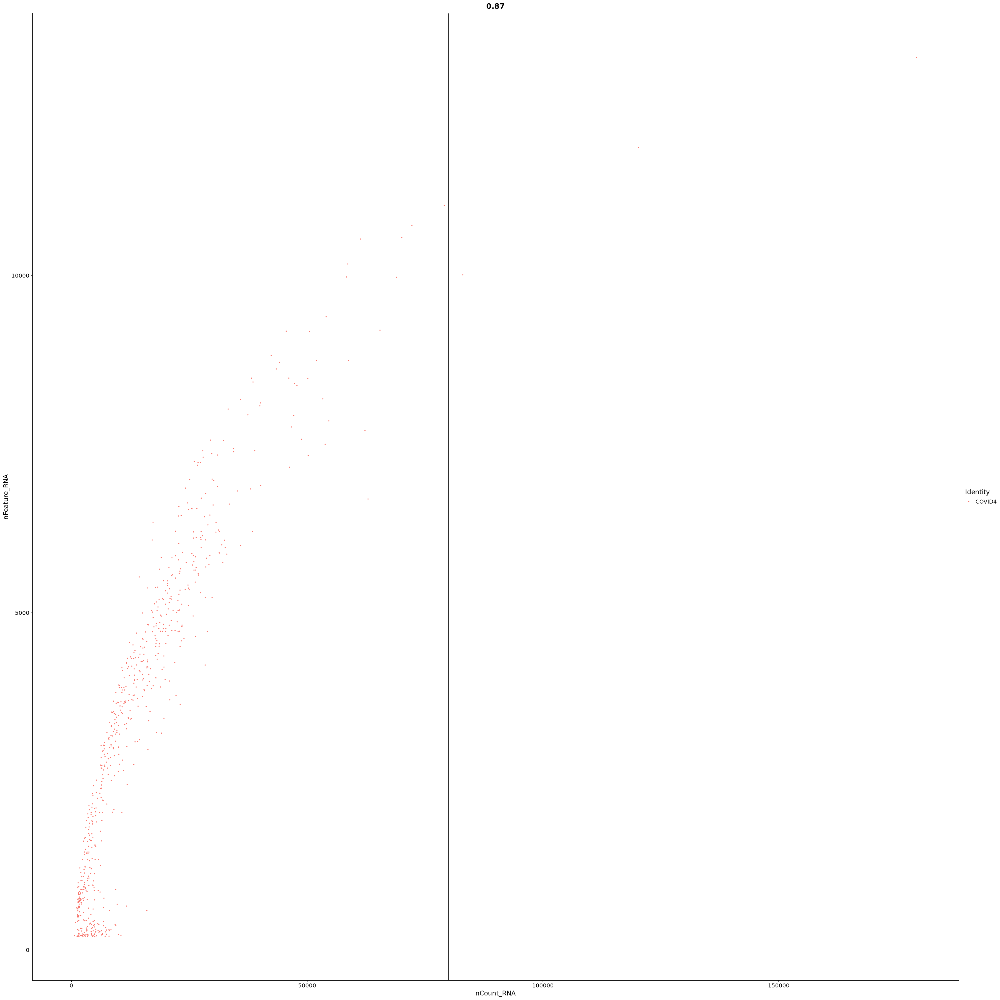

...

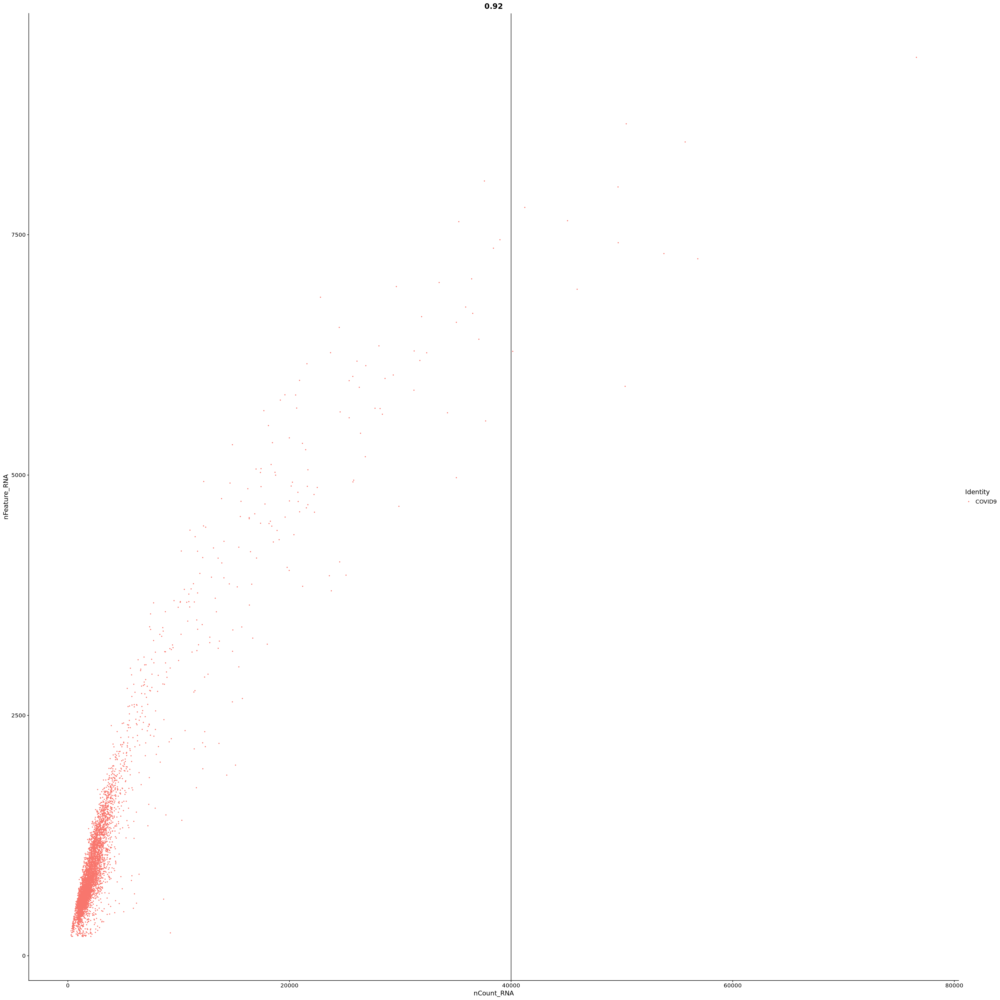

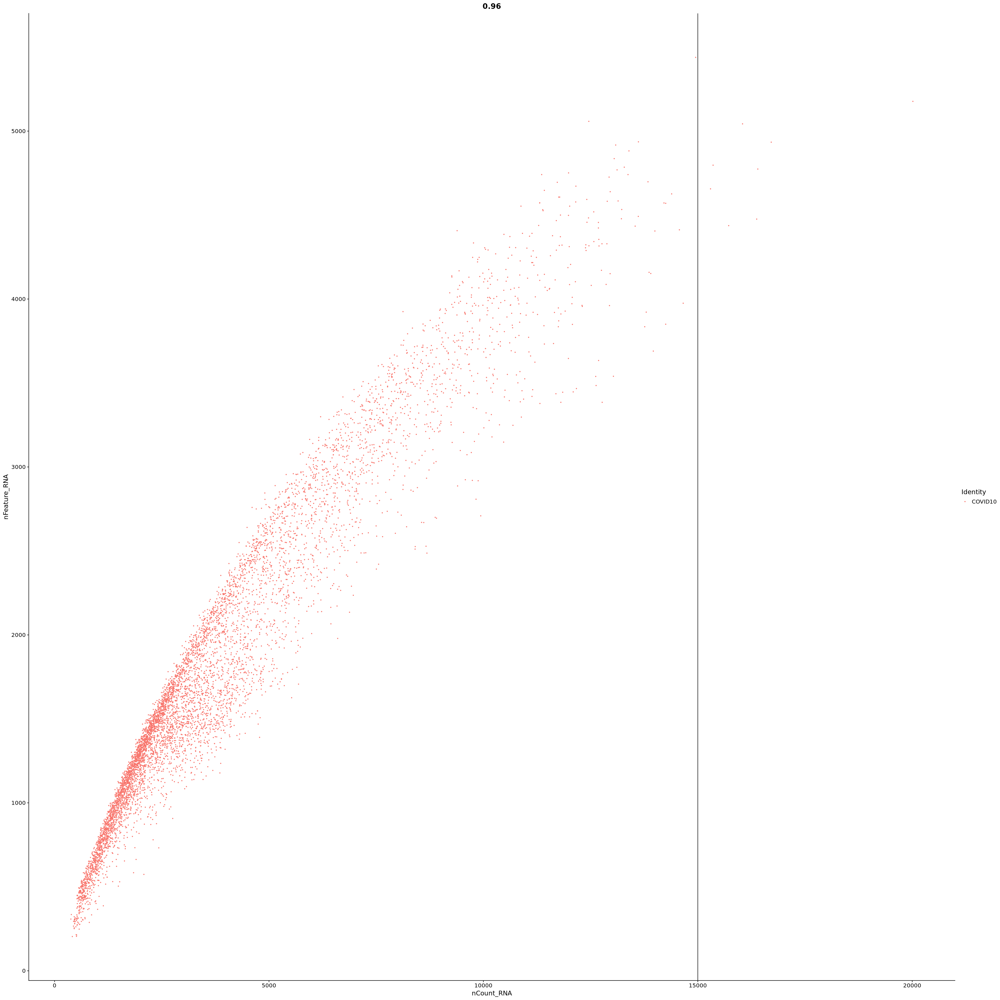

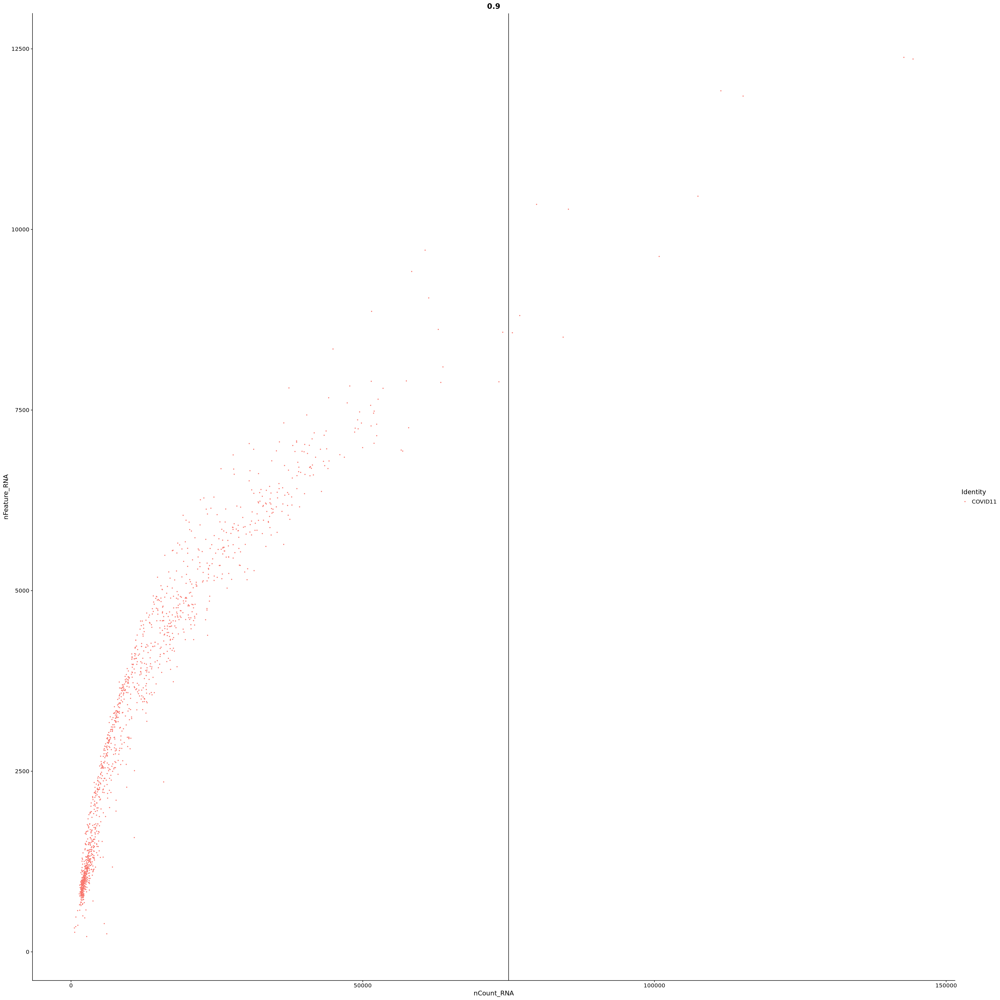

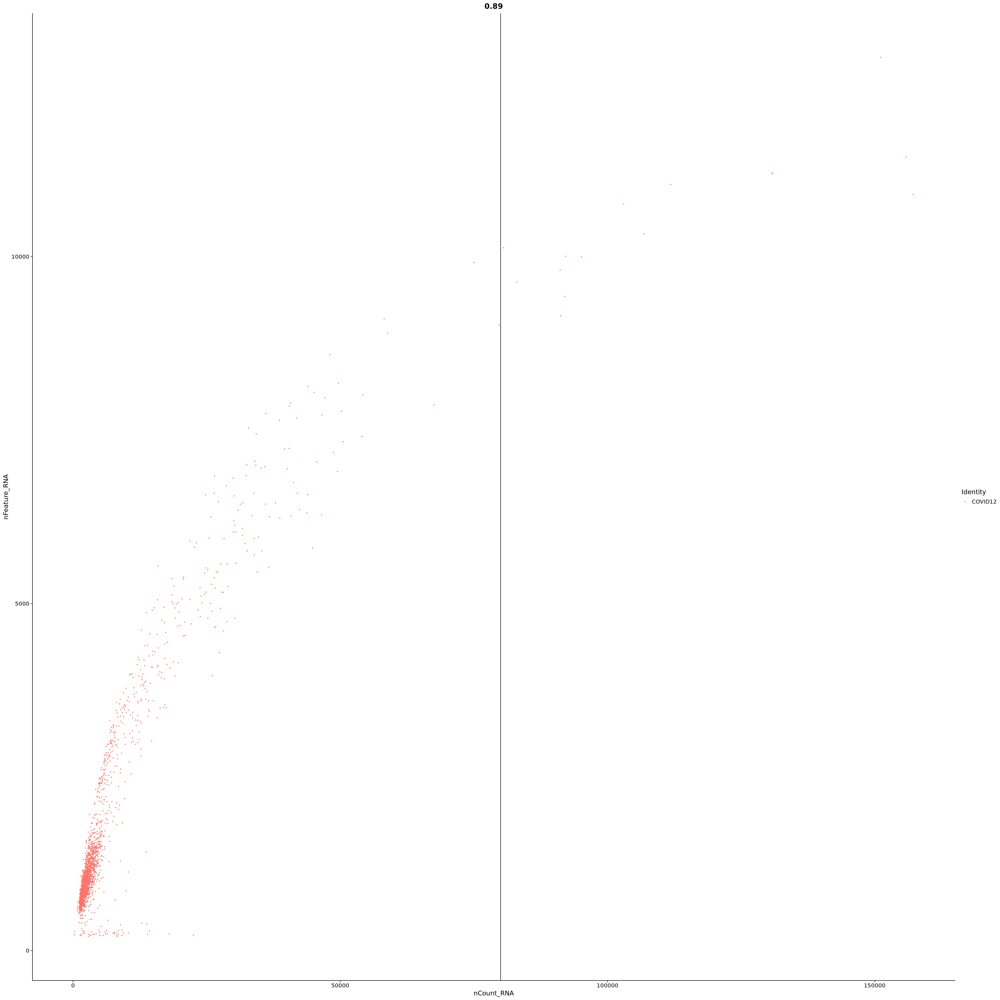

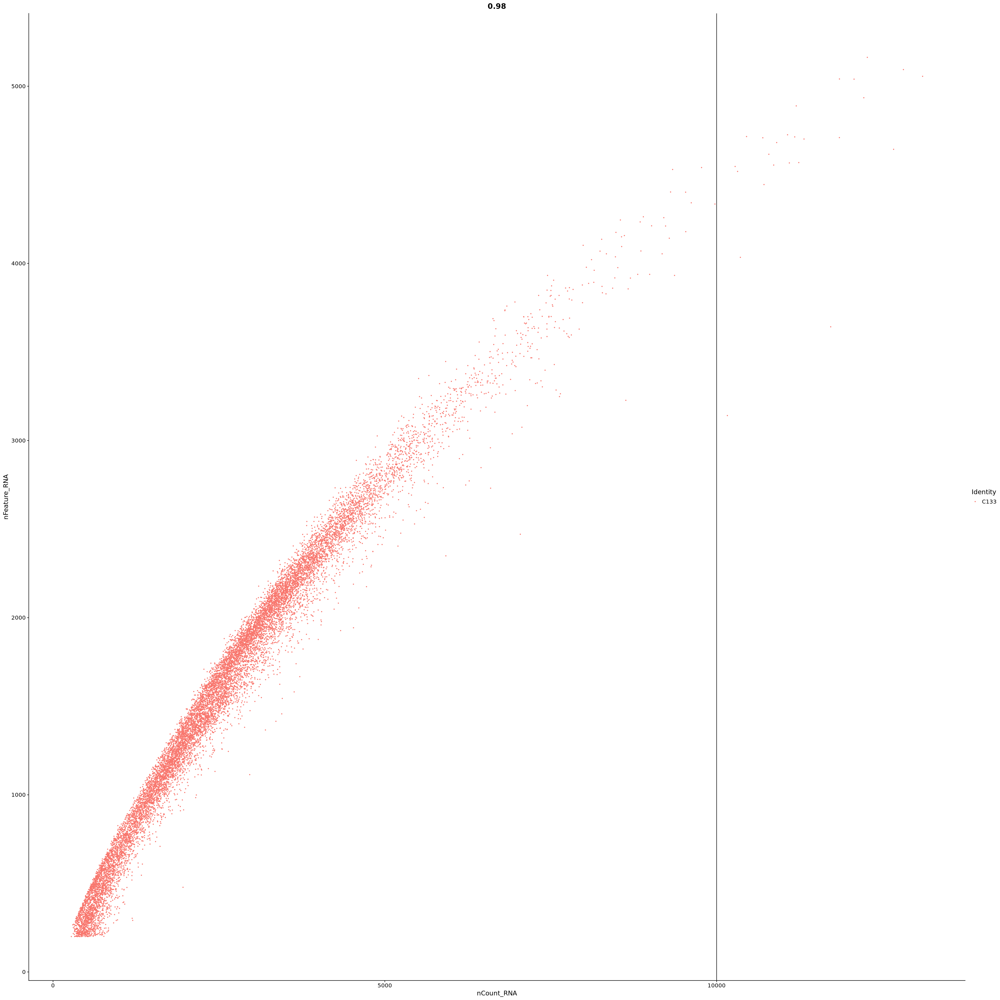

$COVID0

$COVID1

$COVID2

$COVID3

$COVID4

$COVID5

$COVID6

$COVID7

$COVID8

$COVID9

$COVID10

$COVID11

$COVID12

$C133

$C137

$C21


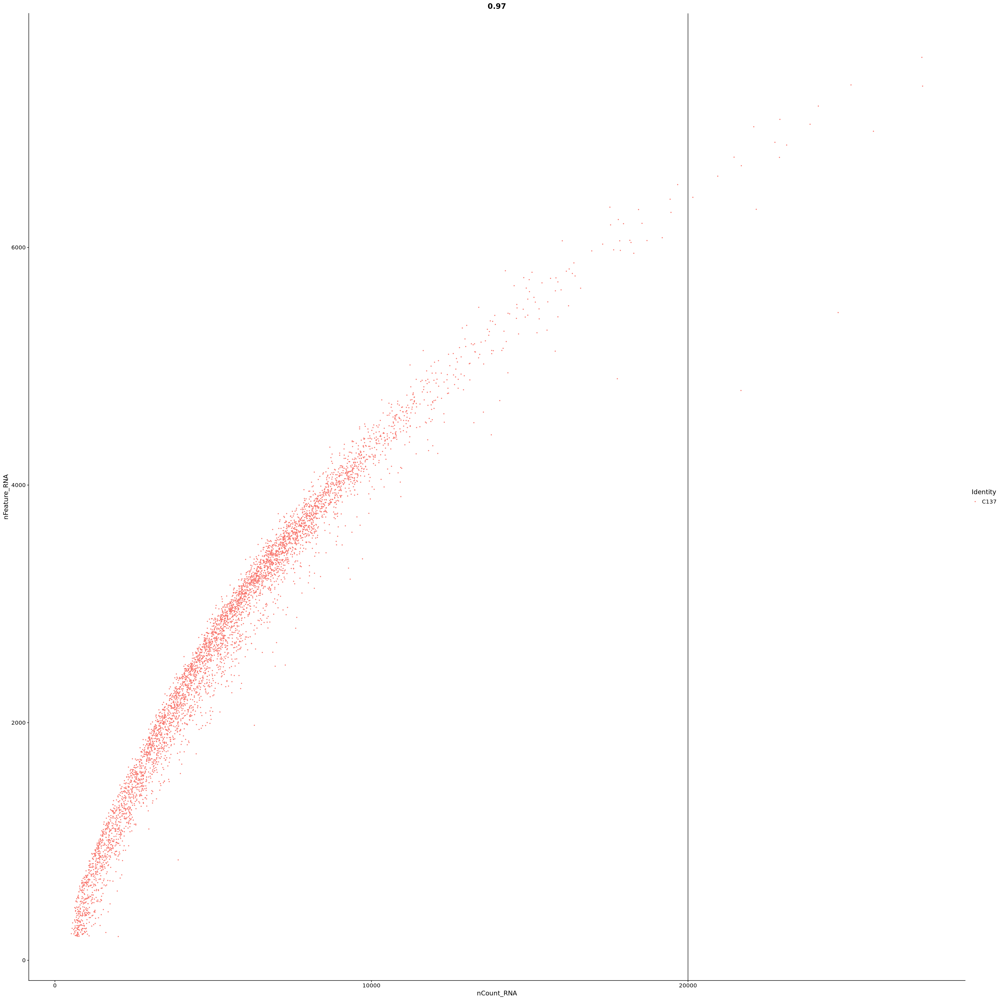

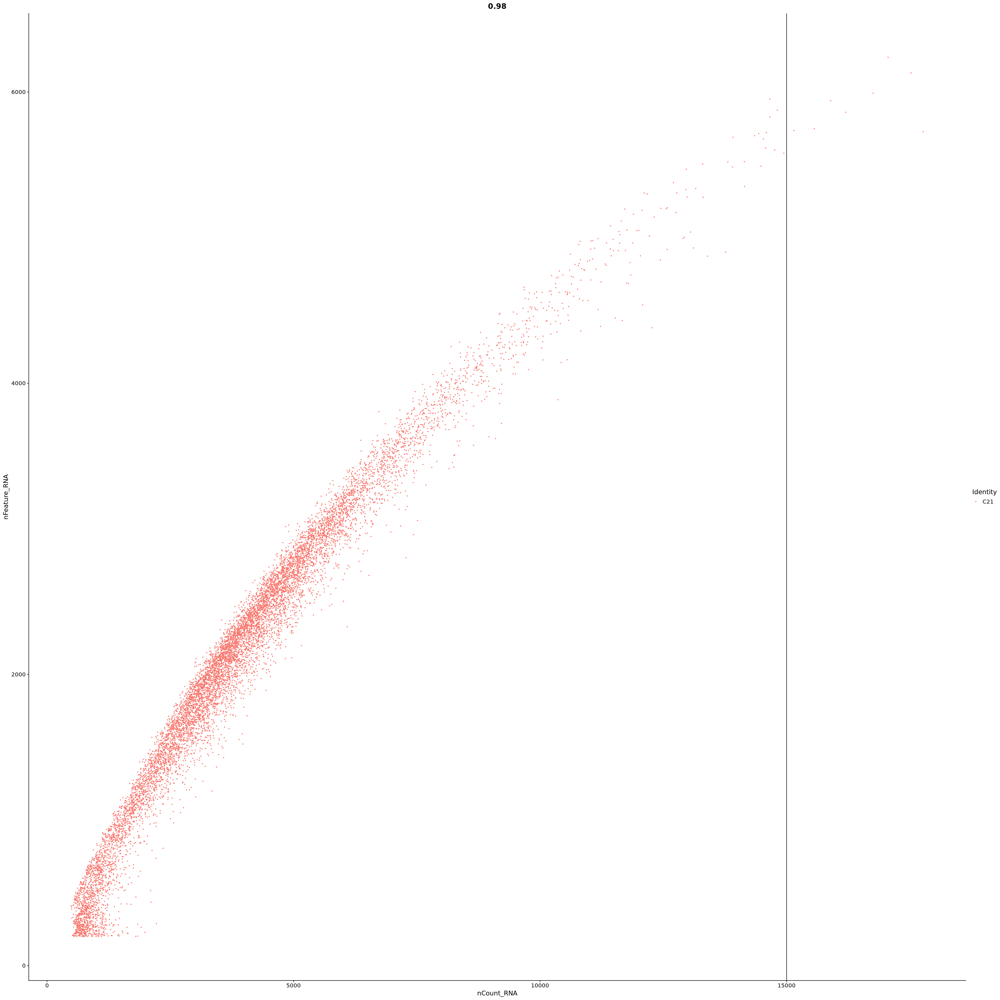

In [33]:
scatter_list

In [34]:
##filter according to manually determined thresholds

i <- 1
ont_list_filtered <- list()
for(sample in names(ont_list)){
    message(sample)
    tmp_filter <- WhichCells(ont_list[[sample]], expression = nCount_RNA < tresholds[i])
    message('#Cells remainging after first filtering:', length(tmp_filter))
    ont_list_filtered[[sample]] <- subset(ont_list[[sample]], cells = tmp_filter, subset = percent.mt < 15)
    i <- i + 1
}

COVID0

#Cells remainging after first filtering:1168

COVID1

#Cells remainging after first filtering:657

COVID2

#Cells remainging after first filtering:2887

COVID3

#Cells remainging after first filtering:414

COVID4

#Cells remainging after first filtering:695

COVID5

#Cells remainging after first filtering:824

COVID6

#Cells remainging after first filtering:384

COVID7

#Cells remainging after first filtering:2627

COVID8

#Cells remainging after first filtering:2375

COVID9

#Cells remainging after first filtering:5872

COVID10

#Cells remainging after first filtering:7075

COVID11

#Cells remainging after first filtering:1354

COVID12

#Cells remainging after first filtering:2773

C133

#Cells remainging after first filtering:14589

C137

#Cells remainging after first filtering:5004

C21

#Cells remainging after first filtering:10708



In [10]:
ont_list

$COVID0
An object of class Seurat 
85552 features across 1188 samples within 2 assays 
Active assay: RNA (25121 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID1
An object of class Seurat 
92294 features across 689 samples within 2 assays 
Active assay: RNA (26320 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID2
An object of class Seurat 
88429 features across 2896 samples within 2 assays 
Active assay: RNA (25180 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID3
An object of class Seurat 
89739 features across 431 samples within 2 assays 
Active assay: RNA (26046 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID4
An object of class Seurat 
88063 features across 698 samples within 2 assays 
Active assay: RNA (25607 features, 0 variable features)
 1 layer present: counts
 1 other assay pres

In [12]:
ont_list_filtered

$COVID0
An object of class Seurat 
85552 features across 1157 samples within 2 assays 
Active assay: RNA (25121 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID1
An object of class Seurat 
92294 features across 561 samples within 2 assays 
Active assay: RNA (26320 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID2
An object of class Seurat 
88429 features across 2307 samples within 2 assays 
Active assay: RNA (25180 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID3
An object of class Seurat 
89739 features across 208 samples within 2 assays 
Active assay: RNA (26046 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID4
An object of class Seurat 
88063 features across 488 samples within 2 assays 
Active assay: RNA (25607 features, 0 variable features)
 1 layer present: counts
 1 other assay pres

# Data integration

## CCA integration

In [29]:
####### NS samples ######
seurat_NS = ont_list_filtered[c('COVID0', 'COVID1', 'COVID2', 'COVID3', 'COVID4', 'COVID5', 'COVID6','COVID9', 'COVID11', 'C133', 'C137', 'C21')]

##Scale and normalize
for(sample in names(seurat_NS)){
    seurat_NS[[sample]] = NormalizeData(object = seurat_NS[[sample]])
    seurat_NS[[sample]] = ScaleData(object = seurat_NS[[sample]])
}


##Find intergration features
features = SelectIntegrationFeatures(object.list = seurat_NS, nfeatures = 5000)

##Find itegration anchors
anchors = FindIntegrationAnchors(object.list = seurat_NS, anchor.features = features)

##Integrate data
NS_combined_seurat <- IntegrateData(anchorset = anchors)


##Scale again, compute PCA,UMAP, Neighbors and Clusters
DefaultAssay(NS_combined_seurat) <- "integrated"

NS_combined_seurat <- ScaleData(NS_combined_seurat, verbose = FALSE)
NS_combined_seurat <- RunPCA(NS_combined_seurat, npcs = 90, verbose = FALSE)
NS_combined_seurat <- RunUMAP(NS_combined_seurat, reduction = "pca", dims = 1:15)
NS_combined_seurat <- FindNeighbors(NS_combined_seurat, reduction = "pca", dims = 1:15)
NS_combined_seurat <- FindClusters(NS_combined_seurat, resolution = 0.8)

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

Normalizing layer: counts

Centering and scaling data matrix

No variable features found for object1 in the object.list. Running FindVariableFeatures ...

Finding variable features for layer counts

No variable features found for object2 in the object.list. Running FindVariableFeatures ...

Finding variable features 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 37211
Number of edges: 1267109

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8880
Number of communities: 20
Elapsed time: 5 seconds


## Harmony integration

In [8]:
ont_list_filtered

$COVID0
An object of class Seurat 
85552 features across 1157 samples within 2 assays 
Active assay: RNA (25121 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID1
An object of class Seurat 
92294 features across 561 samples within 2 assays 
Active assay: RNA (26320 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID2
An object of class Seurat 
88429 features across 2307 samples within 2 assays 
Active assay: RNA (25180 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID3
An object of class Seurat 
89739 features across 208 samples within 2 assays 
Active assay: RNA (26046 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID4
An object of class Seurat 
88063 features across 488 samples within 2 assays 
Active assay: RNA (25607 features, 0 variable features)
 1 layer present: counts
 1 other assay pres

In [10]:
options(future.globals.maxSize = 1000 * 1024^2)

In [213]:
NS_ont_list_filtered = ont_list_filtered[c('COVID0', 'COVID1', 'COVID2', 'COVID3', 'COVID4', 'COVID5', 'COVID6','COVID9', 'COVID11', 'C133', 'C137', 'C21')]

In [214]:
NS_ont_list_filtered

$COVID0
An object of class Seurat 
85552 features across 1157 samples within 2 assays 
Active assay: RNA (25121 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID1
An object of class Seurat 
92294 features across 561 samples within 2 assays 
Active assay: RNA (26320 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID2
An object of class Seurat 
88429 features across 2307 samples within 2 assays 
Active assay: RNA (25180 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID3
An object of class Seurat 
89739 features across 208 samples within 2 assays 
Active assay: RNA (26046 features, 0 variable features)
 1 layer present: counts
 1 other assay present: Transcript

$COVID4
An object of class Seurat 
88063 features across 488 samples within 2 assays 
Active assay: RNA (25607 features, 0 variable features)
 1 layer present: counts
 1 other assay pres

In [224]:
merged_NS <- merge(x = NS_ont_list_filtered[[1]], y = NS_ont_list_filtered[c(2:length(NS_ont_list_filtered))])

Warning message:
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [225]:
# run standard anlaysis workflow
merged_NS <- NormalizeData(merged_NS)
merged_NS <- FindVariableFeatures(merged_NS)
merged_NS <- ScaleData(merged_NS)
merged_NS <- RunPCA(merged_NS)

Normalizing layer: counts.COVID0

Normalizing layer: counts.COVID1

Normalizing layer: counts.COVID2

Normalizing layer: counts.COVID3

Normalizing layer: counts.COVID4

Normalizing layer: counts.COVID5

Normalizing layer: counts.COVID6

Normalizing layer: counts.COVID9

Normalizing layer: counts.COVID11

Normalizing layer: counts.C133

Normalizing layer: counts.C137

Normalizing layer: counts.C21

Finding variable features for layer counts.COVID0

Finding variable features for layer counts.COVID1

Finding variable features for layer counts.COVID2

Finding variable features for layer counts.COVID3

Finding variable features for layer counts.COVID4

Finding variable features for layer counts.COVID5

Finding variable features for layer counts.COVID6

Finding variable features for layer counts.COVID9

Finding variable features for layer counts.COVID11

Finding variable features for layer counts.C133

Finding variable features for layer counts.C137

Finding variable features for layer coun

In [138]:
merged_NS

An object of class Seurat 
160487 features across 35880 samples within 2 assays 
Active assay: RNA (32460 features, 2000 variable features)
 25 layers present: counts.COVID0, counts.COVID1, counts.COVID2, counts.COVID3, counts.COVID4, counts.COVID5, counts.COVID6, counts.COVID9, counts.COVID11, counts.C133, counts.C137, counts.C21, data.COVID0, data.COVID1, data.COVID2, data.COVID3, data.COVID4, data.COVID5, data.COVID6, data.COVID9, data.COVID11, data.C133, data.C137, data.C21, scale.data
 1 other assay present: Transcript
 1 dimensional reduction calculated: pca

In [11]:
#for(sample in names(NS_ont_list_filtered)){
#    message(sample)
#    NS_ont_list_filtered[[sample]] <- SCTransform(NS_ont_list_filtered[[sample]], vars.to.regress = "percent.mt", return.only.var.genes = FALSE)
#}

#var.features <- SelectIntegrationFeatures(object.list = NS_ont_list_filtered, nfeatures = 3000)
#merged_NS <- merge(x = NS_ont_list_filtered[[1]], y = NS_ont_list_filtered[c(2:length(NS_ont_list_filtered))])
#VariableFeatures(merged_NS) <- var.features


COVID0

Running SCTransform on assay: RNA

Running SCTransform on layer: counts

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 19741 by 1157

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 1157 cells

Found 10 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 19741 genes

Computing corrected count matrix for 19741 genes

Calculating gene attributes

Wall clock passed: Time difference of 10.05828 secs

Determine variable features

Regressing out percent.mt

Centering data matrix

Set default assay to SCT

COVID1

Running SCTransform on assay: RNA

Running SCTransform on layer: counts

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 22456 by 561

Model formula is y ~ log_umi

Get N

In [13]:
merged_NS$orig.ident |> unique()

[1] "COVID0"  "COVID1"  "COVID2"  "COVID3"  "COVID4"  "COVID5"  "COVID6" 
 [8] "COVID9"  "COVID11" "C133"    "C137"    "C21"

In [42]:
library(harmony)

Loading required package: Rcpp



In [43]:
merged_NS

An object of class Seurat 
160487 features across 35880 samples within 2 assays 
Active assay: RNA (32460 features, 2000 variable features)
 25 layers present: counts.COVID0, counts.COVID1, counts.COVID2, counts.COVID3, counts.COVID4, counts.COVID5, counts.COVID6, counts.COVID9, counts.COVID11, counts.C133, counts.C137, counts.C21, data.COVID0, data.COVID1, data.COVID2, data.COVID3, data.COVID4, data.COVID5, data.COVID6, data.COVID9, data.COVID11, data.C133, data.C137, data.C21, scale.data
 1 other assay present: Transcript
 1 dimensional reduction calculated: pca

In [226]:
merged_NS = RunHarmony(merged_NS, group.by.vars = "orig.ident", assay.use = 'RNA')

Transposing data matrix

Initializing state using k-means centroids initialization

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony converged after 6 iterations



In [227]:
merged_NS

An object of class Seurat 
160487 features across 35880 samples within 2 assays 
Active assay: RNA (32460 features, 2000 variable features)
 25 layers present: counts.COVID0, counts.COVID1, counts.COVID2, counts.COVID3, counts.COVID4, counts.COVID5, counts.COVID6, counts.COVID9, counts.COVID11, counts.C133, counts.C137, counts.C21, data.COVID0, data.COVID1, data.COVID2, data.COVID3, data.COVID4, data.COVID5, data.COVID6, data.COVID9, data.COVID11, data.C133, data.C137, data.C21, scale.data
 1 other assay present: Transcript
 2 dimensional reductions calculated: pca, harmony

In [228]:
# re-join layers after integration
merged_NS <- JoinLayers(merged_NS)
DefaultAssay(merged_NS) = "RNA"

merged_NS <- RunUMAP(merged_NS, reduction = "harmony", dims = 1:30, reduction.name = "umap.harmony")
merged_NS <- FindNeighbors(merged_NS, reduction = "harmony", dims = 1:30) %>% FindClusters(resolution = 1)

15:07:56 UMAP embedding parameters a = 0.9922 b = 1.112

15:07:56 Read 35880 rows and found 30 numeric columns

15:07:56 Using Annoy for neighbor search, n_neighbors = 30

15:07:56 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:07:59 Writing NN index file to temp file /tmp/Rtmpi70JsN/file1842667dfc98f

15:07:59 Searching Annoy index using 1 thread, search_k = 3000

15:08:08 Annoy recall = 100%

15:08:08 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

15:08:10 Initializing from normalized Laplacian + noise (using RSpectra)

15:08:11 Commencing optimization for 200 epochs, with 1588614 positive edges

15:08:24 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35880
Number of edges: 1256555

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8728
Number of communities: 25
Elapsed time: 6 seconds


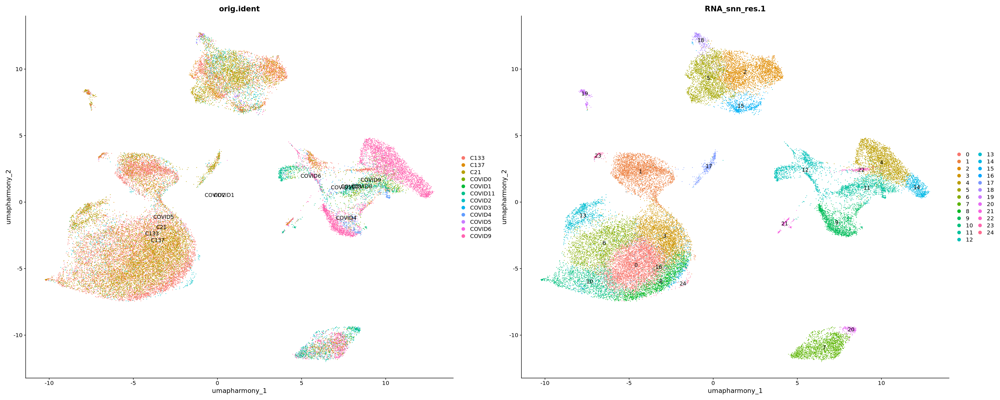

In [229]:
options(repr.plot.height = 12, repr.plot.width = 30)
DimPlot(merged_NS, reduction = "umap.harmony", group.by = c("orig.ident", 'RNA_snn_res.1'), label = TRUE)

In [29]:
dir <- "/sc-projects/sc-proj-dh-promethion/FLAMES_covid19/data_home/"
saveRDS(merged_NS, paste0(dir,"NS_IntegratedONT_SCT.rds"))

# Filter and annotate

In [3]:
#dir <- "/sc-projects/sc-proj-dh-promethion/FLAMES_covid19/data_home/"
#merged_NS = readRDS(paste0(dir,"NS_IntegratedONT_SCT.rds"))

In [2]:
dir <- "/sc-projects/sc-proj-dh-promethion/ONT_sc-wf_COVID/seurat_data/"
lr_NS = readRDS(paste0(dir,"NS_IntegratedONT.rds"))

In [231]:
#NS_combined_seurat = merged_NS

In [4]:
NS_combined_seurat = lr_NS

In [5]:
cellType_dict <- c('B cell'= 'B cell','Bcell'= 'B cell','Plasma'= 'B cell',
                   'T'='T cell','Tcell'='T cell','Tcell.CD4'='T cell','Tcell.CD8'='T cell','Treg'='T cell', 'CTL'='T cell',
                   'NK'='NK', 'NKT'='NK', 'NKT-p'='NKT',
                   'Macrophage'='MoMa','MoMa'='MoMa','moMa'='MoMa','nrMa'='MoMa','rMa'='MoMa',
                   'mDC'='Dendritic','moDC'='Dendritic','pDC'='Dendritic',
                   'Neu'='Neutrophil',
                   'Basal'='Basal',
                   'Club'='Secretory','Goblet'='Secretory','Secretory'='Secretory','Secretory-diff'='Secretory','Sec_diff'='Secretory','IRC'='Secretory',
                   'FOXN4'='FOXN4',
                   'Cil_acute_phase'='Ciliated','Cil_diff'='Ciliated','Ciliated'='Ciliated','Ciliated-diff'='Ciliated',
                   'Ionocyte'='Ionocyte',
                   'Squamous'='Squamous',
                   'MC'='Mast', 'MC_Basophil'='Mast',
                   'Mitotic'='Mitotic',
                   'unknown'='Unknown1',
                   'unknown_epithelial'='Unknown2',
                   'outliers_epithelial'='Unknown3',
                   'lowRNA'='Unknown4',
                   'NotInSRs' = 'NotInSRs'
                  )

collapsedCellTypes <- (NS_combined_seurat[[]] %>%
  mutate(sr_annotation_collapsed = sapply(short_read_annotation, function(x) cellType_dict[[x]]))) %>% select(sr_annotation_collapsed)
                                        
NS_combined_seurat <- AddMetaData(NS_combined_seurat, collapsedCellTypes, col.name= 'sr_annotation_collapsed')

In [6]:
head(NS_combined_seurat[[]])

,orig.ident,nCount_RNA,nFeature_RNA,nCount_Transcript,nFeature_Transcript,short_read_annotation,percent.mt,unintegrated_clusters,seurat_clusters,RNA_snn_res.1,sr_annotation_collapsed,RNA_snn_res.0.5,RNA_snn_res.1.5,RNA_snn_res.2,RNA_snn_res.3,newAnno
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<dbl>,<fct>,<fct>,<fct>,<chr>,<fct>,<fct>,<fct>,<fct>,<chr>
AAACCCACAGTGGTGA_1,COVID0,41378,7202,22817,5298,nrMa,2.419160,18,23,4,MoMa,4,4,2,23,MoMa
AAACCCATCCCTCGAT_1,COVID0,3394,1521,1816,775,nrMa,3.506187,18,31,4,MoMa,4,4,2,31,Neutrophil
AAACGCTGTACGGTTT_1,COVID0,18243,4925,7459,2966,nrMa,1.880173,18,18,10,MoMa,7,11,10,18,MoMa
AAAGAACAGAAACTAC_1,COVID0,10574,3332,5606,1798,nrMa,1.446945,18,31,4,MoMa,4,4,10,31,Neutrophil
AAAGAACCACTCACTC_1,COVID0,10463,3311,5912,1949,nrMa,1.338048,17,37,8,MoMa,6,9,8,37,MoMa
AAAGGATGTGTCCAAT_1,COVID0,1670,874,801,392,nrMa,1.137725,18,31,4,MoMa,4,4,10,31,MoMa


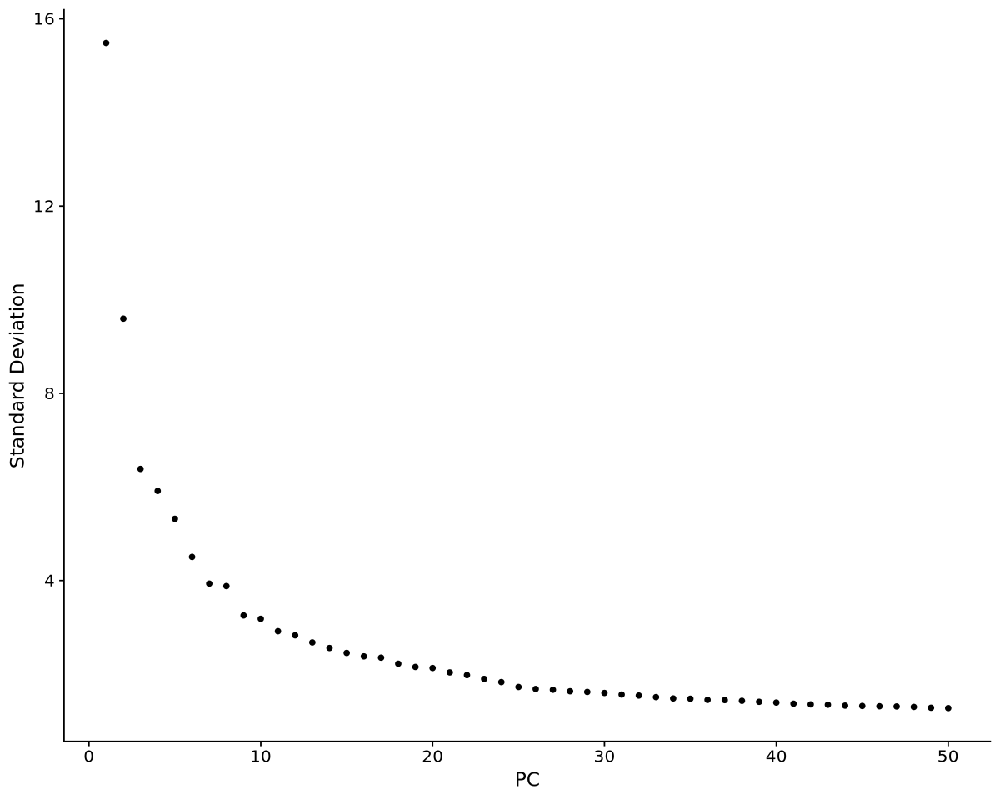

In [7]:
options(repr.plot.height = 8, repr.plot.width = 10)
ElbowPlot(NS_combined_seurat, reduction = "pca", ndim = 50)

In [8]:
NS_combined_seurat <- RunPCA(NS_combined_seurat, npcs = 90, verbose = FALSE)
NS_combined_seurat <- RunUMAP(NS_combined_seurat, reduction = "harmony", dims = 1:30)
NS_combined_seurat <- FindNeighbors(NS_combined_seurat, reduction = "harmony", dims = 1:30, ,reduction.name = "umap.harmony")
NS_combined_seurat <- FindClusters(NS_combined_seurat, resolution = c(0.5,1,1.5,2,3))

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
15:53:03 UMAP embedding parameters a = 0.9922 b = 1.112

15:53:03 Read 35880 rows and found 30 numeric columns

15:53:03 Using Annoy for neighbor search, n_neighbors = 30

15:53:03 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:53:07 Writing NN index file to temp file /tmp/RtmpUmThuP/file3c69a0707b44ca

15:53:07 Searching Annoy index using 1 thread, search_k = 3000

15:53:17 Annoy recall = 100%

15:53:17 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbor

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35880
Number of edges: 1256282

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9130
Number of communities: 19
Elapsed time: 8 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35880
Number of edges: 1256282

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8732
Number of communities: 25
Elapsed time: 8 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35880
Number of edges: 1256282

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8470
Number of communities: 31
Elapsed time: 8 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35880
Number of edges: 1256282

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8254
Number of communities: 37
Elapsed time: 8 seconds
Modulari

In [9]:
NS_combined_seurat

An object of class Seurat 
160487 features across 35880 samples within 2 assays 
Active assay: RNA (32460 features, 2000 variable features)
 3 layers present: data, counts, scale.data
 1 other assay present: Transcript
 5 dimensional reductions calculated: pca, umap.unintegrated, harmony, umap.harmony, umap

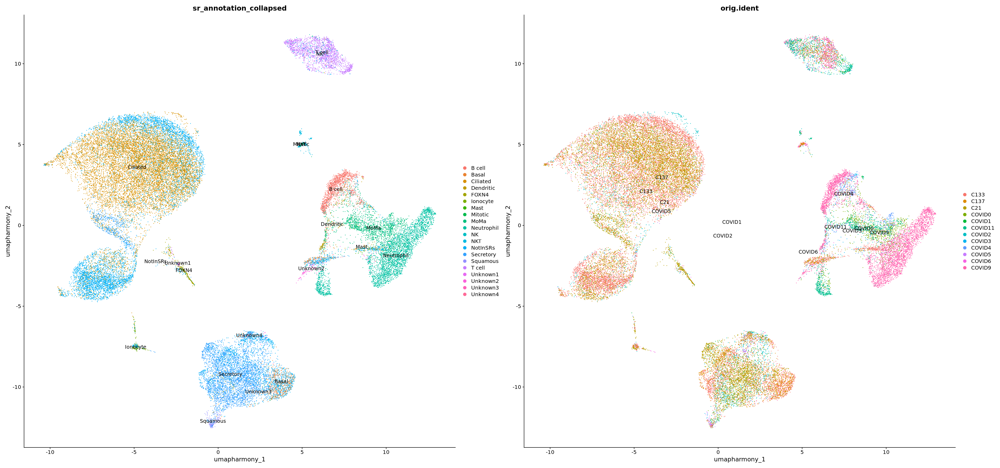

In [6]:
options(repr.plot.height = 15, repr.plot.width = 32)
DimPlot(NS_combined_seurat, reduction = "umap.harmony", group.by = c("sr_annotation_collapsed", "orig.ident"), , pt.size = .1, label = TRUE)

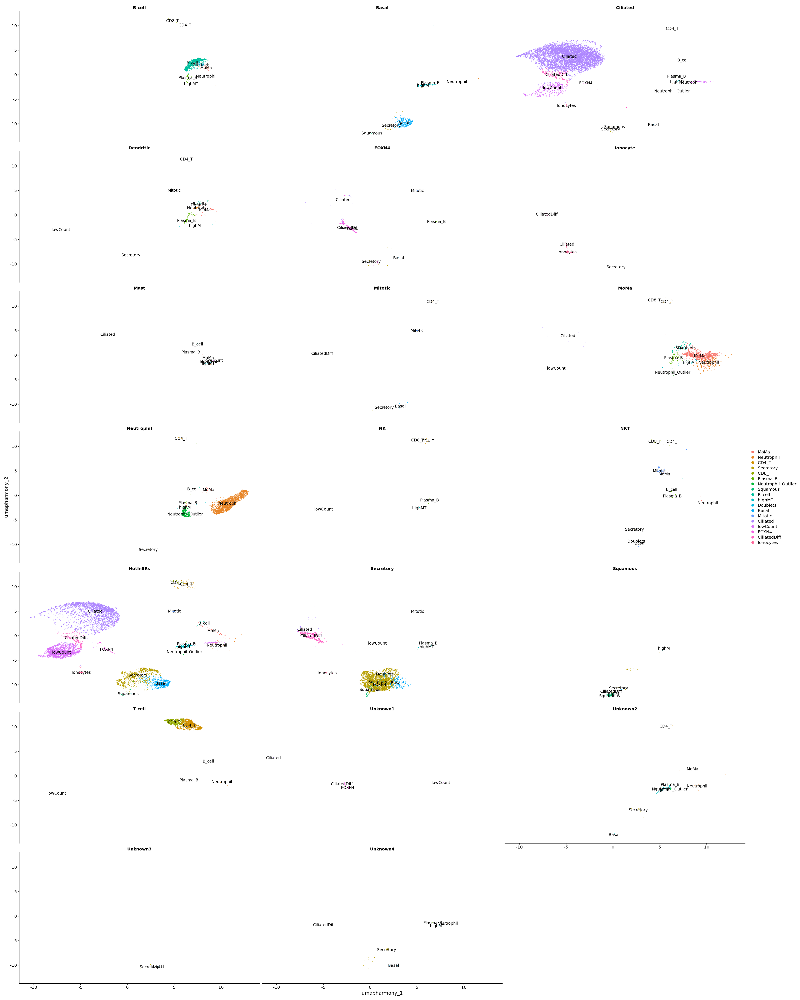

In [238]:
options(repr.plot.height = 40, repr.plot.width = 32)
DimPlot(NS_combined_seurat, reduction = "umap.harmony", split.by = "sr_annotation_collapsed", ncol = 3, pt.size = .1, label = TRUE)

In [14]:
head(NS_combined_seurat[[]])

,orig.ident,nCount_RNA,nFeature_RNA,nCount_Transcript,nFeature_Transcript,short_read_annotation,percent.mt,nCount_SCT,nFeature_SCT,unintegrated_clusters,seurat_clusters,SCT_snn_res.1,sr_annotation_collapsed,SCT_snn_res.0.5,SCT_snn_res.1.5,SCT_snn_res.2,SCT_snn_res.3
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<fct>,<fct>,<fct>,<chr>,<fct>,<fct>,<fct>,<fct>
AAACCCACAGTGGTGA_1,COVID0,41378,7202,22817,5298,nrMa,2.419160,7950,3364,13,0,5,MoMa,4,3,1,0
AAACCCATCCCTCGAT_1,COVID0,3394,1521,1816,775,nrMa,3.506187,6988,1593,13,0,5,MoMa,4,3,1,0
AAACGCTGTACGGTTT_1,COVID0,18243,4925,7459,2966,nrMa,1.880173,8389,3640,13,27,5,MoMa,4,3,1,27
AAAGAACAGAAACTAC_1,COVID0,10574,3332,5606,1798,nrMa,1.446945,8493,3312,13,0,5,MoMa,4,3,1,0
AAAGAACCACTCACTC_1,COVID0,10463,3311,5912,1949,nrMa,1.338048,8517,3289,13,17,10,MoMa,8,13,14,17
AAAGGATGTGTCCAAT_1,COVID0,1670,874,801,392,nrMa,1.137725,6594,1554,13,0,5,MoMa,4,3,1,0


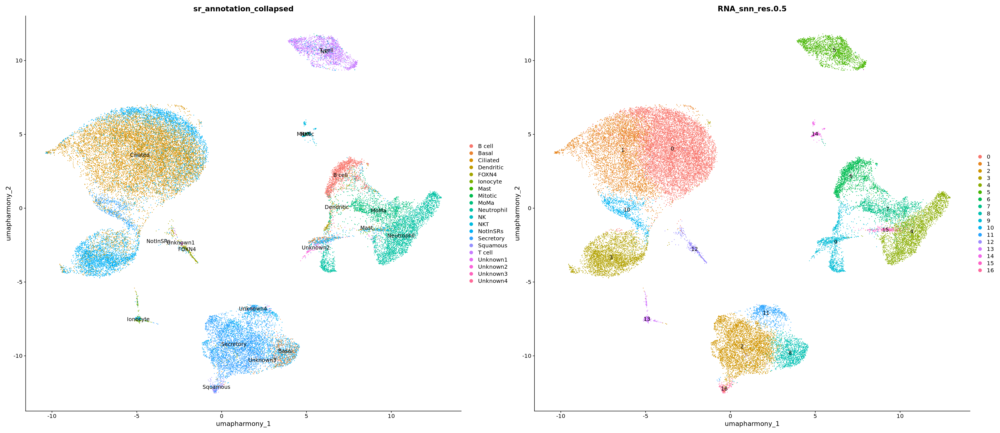

In [239]:
options(repr.plot.height = 13, repr.plot.width = 30)
DimPlot(NS_combined_seurat, reduction = "umap.harmony", group.by = c('sr_annotation_collapsed', 'RNA_snn_res.0.5'), pt.size = .1, label = TRUE)

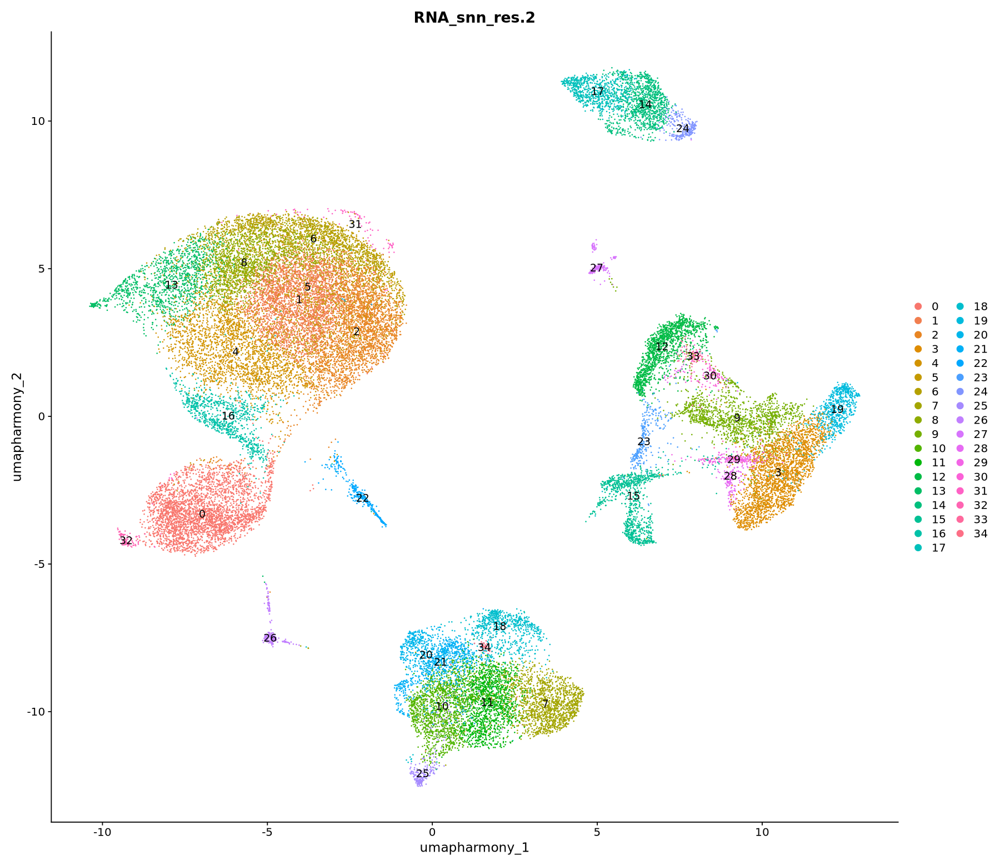

In [267]:
options(repr.plot.height = 13, repr.plot.width = 15)
DimPlot(NS_combined_seurat, reduction = "umap.harmony", group.by = c('RNA_snn_res.2'), pt.size = .1, label = TRUE)

In [261]:
table(NS_combined_seurat$`RNA_snn_res.3`, NS_combined_seurat$orig.ident)

    
     C133 C137  C21 COVID0 COVID1 COVID11 COVID2 COVID3 COVID4 COVID5 COVID6
  0   518  451  837      0     13       0     44      2      5     40      0
  1   712  394  490      0     21       1     54      2      4     30      1
  2   241  138  933      2     45       8    268      1      2      4     23
  3  1479   24  119      0      2       5      8      0      1      2      0
  4     1    1    0     71      3      10      0     10      0      1      2
  5   445  342  648      0     18       3     51      0      2     37      0
  6   987  158  284      0      9       0     69      2      8     18      1
  7   449   46  518     10     52       2    252      2     14     37      7
  8   664  117  384      0     11       0    101      0      1     29      0
  9   631   98  343      0     17       1    158      0      5     30      0
  10  639  457   57      5      2       1     31      2      0      6      5
  11  538  279  352      0      2       0     32      0      1      9  

In [282]:
Idents(NS_combined_seurat) = 'RNA_snn_res.3'

c_29 = FindMarkers(NS_combined_seurat, ident.1 = '29', ident.2 = c('4', '20', '23'), only.pos = TRUE)

c_neu = FindMarkers(NS_combined_seurat, ident.1 = c('4', '20', '23'), ident.2 = '29', only.pos = TRUE)

c_basal_outlier = FindMarkers(NS_combined_seurat, ident.1 = '28', ident.2 = '10', only.pos = TRUE)
c_basal = FindMarkers(NS_combined_seurat, ident.1 = '10', ident.2 = '28', only.pos = TRUE)

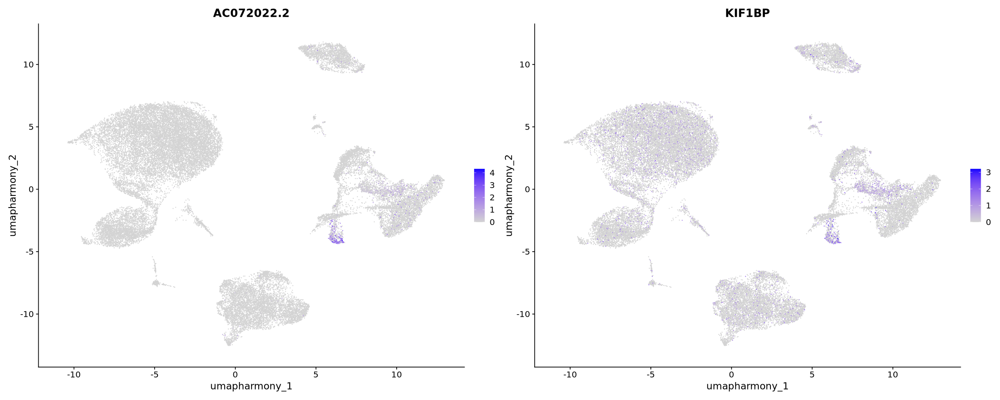

In [256]:
options(repr.plot.height = 8, repr.plot.width = 20)
FeaturePlot(NS_combined_seurat, features = c('AC072022.2', 'KIF1BP'), reduction = 'umap.harmony')

In [259]:
head(c_neu, 20)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
MT-CO1,9.112634e-147,1.4994408,0.985,0.509,2.957961e-142
GAPDH,1.462529e-114,2.4113187,0.836,0.410,4.747369e-110
RPS16,1.535282e-92,1.9280821,0.805,0.363,4.983524e-88
S100A12,6.439747e-86,2.8514335,0.779,0.416,2.090342e-81
SOD2,3.025541e-84,1.0139902,0.993,0.970,9.820907e-80
S100A11,2.219472e-80,0.9576668,0.994,0.929,7.204406e-76
S100A4,1.969445e-75,1.9458544,0.808,0.483,6.392819e-71
SRGN,1.175630e-72,0.9339619,0.989,0.929,3.816095e-68
S100A6,4.109757e-72,1.2798047,0.935,0.811,1.334027e-67


In [255]:
head(c_29, 10)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AC072022.2,7.137705e-189,4.244893,0.446,0.035,2.316899e-184
KIF1BP,2.147231e-153,5.288572,0.298,0.013,6.969911e-149
AC022973.4,3.683599e-120,7.844103,0.193,0.003,1.195696e-115
PIK3R6,6.505410e-116,3.803023,0.330,0.036,2.111656e-111
LINC00278,8.775578e-102,4.781487,0.277,0.028,2.848553e-97
RESF1,1.916271e-101,2.371295,0.760,0.335,6.220214e-97
DDX3Y,3.377799e-94,5.931823,0.191,0.010,1.096433e-89
NEAT1,2.417150e-93,1.144111,0.989,0.946,7.846068e-89
AC112496.1,1.083757e-91,8.437573,0.137,0.001,3.517875e-87


In [283]:
head(c_basal_outlier, 20)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
FP236383.3,1.237345e-24,5.1868360,0.153,0.025,4.016420e-20
SRGN,3.688557e-24,4.9604966,0.134,0.017,1.197306e-19
FCER1G,3.892451e-24,4.9612697,0.126,0.014,1.263490e-19
STPG4,4.807945e-23,6.2907153,0.139,0.022,1.560659e-18
ZEB2,4.528525e-21,6.4379285,0.098,0.008,1.469959e-16
VIM,3.677730e-20,5.0087263,0.118,0.017,1.193791e-15
KRT15,8.110788e-20,2.7782169,0.352,0.201,2.632762e-15
TYROBP,1.016707e-19,5.7015145,0.102,0.011,3.300232e-15
Z93241.1,1.191284e-19,5.7957524,0.088,0.007,3.866908e-15


In [284]:
head(c_basal, 20)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
KRT19,1.046135e-142,2.032668,0.969,0.434,3.395755e-138
SERPINB3,7.535271e-140,3.233160,0.854,0.167,2.445949e-135
HSPB1,3.755191e-116,2.366542,0.854,0.194,1.218935e-111
SLPI,1.257411e-107,1.654939,0.925,0.342,4.081555e-103
RPS18,3.439609e-91,1.355955,0.973,0.585,1.116497e-86
MT1X,8.389954e-85,1.732963,0.849,0.346,2.723379e-80
RPS16,8.056994e-84,1.323796,0.927,0.448,2.615300e-79
GABRP,8.117154e-81,2.354197,0.610,0.067,2.634828e-76
TFCP2L1,2.507091e-80,1.633159,0.780,0.177,8.138018e-76


In [266]:
for(gene in head(c_basal, 100) %>% rownames()){
    cat(gene, "\n")
}

FP236383.3 
SRGN 
FCER1G 
STPG4 
ZEB2 
VIM 
KRT15 
TYROBP 
Z93241.1 
HSPA1B 
AL445363.1 
DOCK2 
AC108134.2 
HIST1H3A 
PTPRC 
LMO4 
CXCL8 
IGKV3-11 
G0S2 
RASD1 
BCL2A1 
CHD3 
SLC2A3 
LINC01033 
POSTN 
ITGB4 
HSP90AA1 
CDH19 
SOX4 
SMC5 
NBEA 
LINC02562 
C12orf57 
CDH1 
EPB41L4A 
TRAPPC9 
ADM 
CCL3 
SERPINF1 
AGAP1 
UBE3C 
ITGAX 
ITGAM 
PRKDC 
TUBB3 
RDX 
CFL1 
OAT 
SCFD2 
GAS5 
CD48 
PLEKHH3 
USP53 
PPIA 
IGFBP2 
LAMTOR4 
SPATS2L 
S100A8 
LAPTM4A 
OPHN1 
MILR1 
SDCCAG8 
ZKSCAN1 
PUM3 
RNF217 
RALGAPA1 
FAM13A 
TENM4 
GOPC 
MGAT5 
CCL20 
SF3B2 
AC139795.2 
MICB 
C20orf194 
USP3 
OXR1 
ACYP2 
PDCD6IP 
SMAD4 
CCL4 
AC008014.1 
NFX1 
MAGI2 
QSER1 
PDZD2 
LINC02043 
ZC3H6 
CD52 
SETBP1 
PMAIP1 
XRN1 
CD83 
PDS5A 
EVA1C 
TAX1BP1 
SRSF11 
PTPN4 
MAP3K13 
KIF1B 


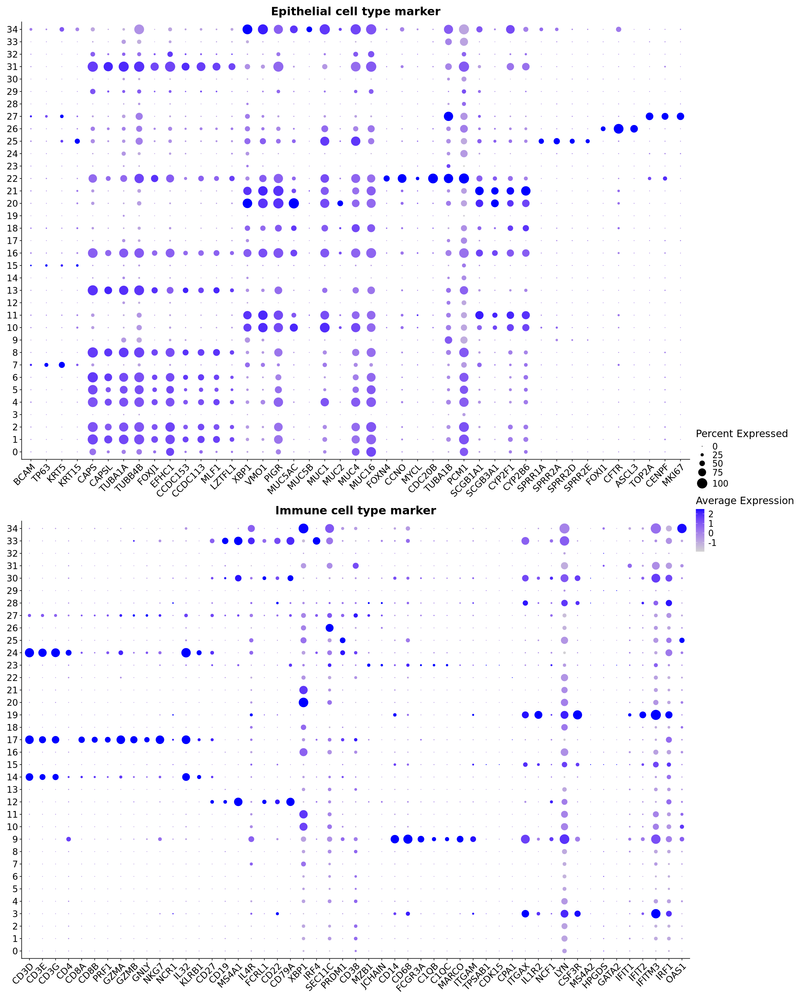

In [268]:
epi = c("BCAM","TP63","KRT5","KRT15", "CAPS", "CAPSL", "TUBA1A", "TUBB4B", "FOXJ1", "EFHC1", "CCDC153", "CCDC113", "MLF1", "LZTFL1",
        "XBP1", "VMO1", "PIGR", "MUC5AC", "MUC5B", "MUC1", "MUC2", "MUC4","MUC16",
        "FOXN4", "CCNO", "MYCL", "CDC20B", "TUBA1B", "PCM1",
        "SCGB1A1","SCGB3A1","CYP2F1", "CYP2B6", 
        "SPRR1A", "SPRR2A", "SPRR2D", "SPRR2E",
        "FOXI1", "CFTR", "ASCL3",
        "TOP2A", "CENPF", "MKI67")
immune = c("CD3D", "CD3E", "CD3G", "CD4",
          "CD8A", "CD8B", "PRF1", "GZMA", "GZMB", "GNLY", "NKG7", "NCR1",
          "IL32", "KLRB1",
          "CD27", "CD19", "MS4A1", "IL4R", "FCRL1", "CD22", "CD79A",
          'XBP1', 'IRF4', 'SEC11C', 'PRDM1', "CD38", 'MZB1', "JCHAIN",
          "CD14", "CD68", "FCGR3A", "C1QB", "C1QC", "MARCO", "ITGAM",
          "TPSAB1", "CDK15", "CPA1",
          "ITGAX", "IL1R2", "NCF1", "LYN", "CSF3R",
          "MS4A2", "HPGDS", "GATA2",
          "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")

DefaultAssay(NS_combined_seurat) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat, features = epi, dot.scale = 8, group.by = 'RNA_snn_res.2') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat, features = immune, dot.scale = 8, group.by = 'RNA_snn_res.2') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=20, repr.plot.height=25)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

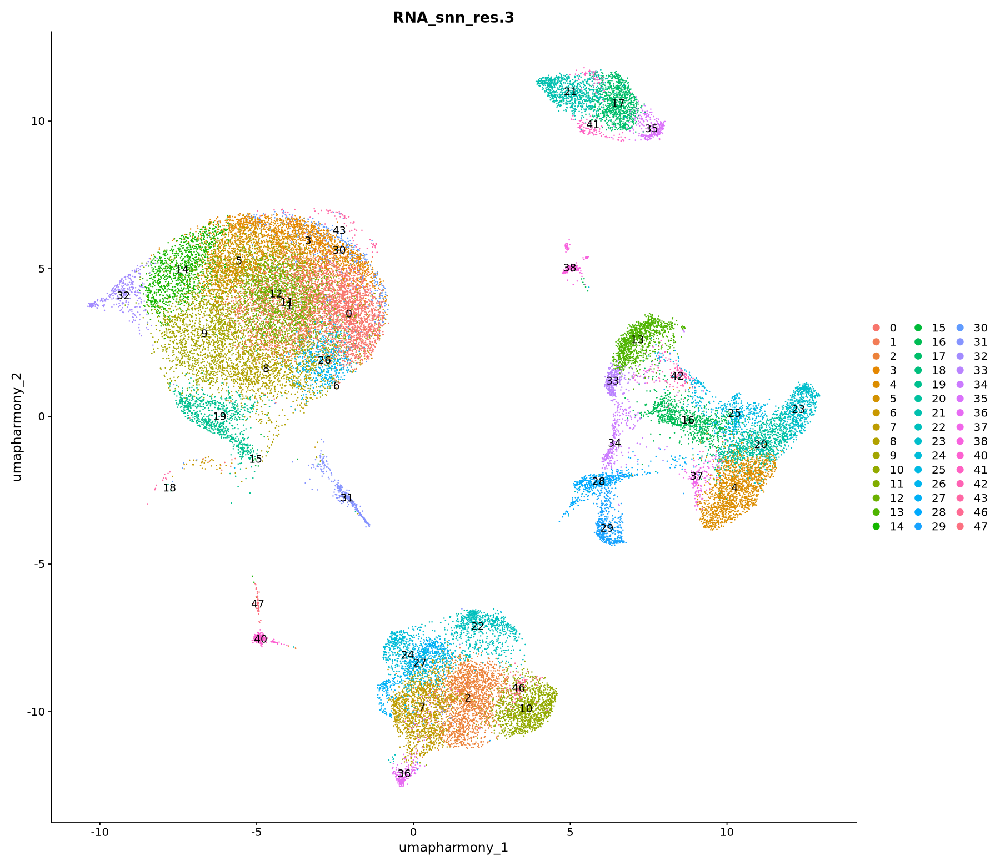

In [289]:
options(repr.plot.height = 13, repr.plot.width = 15)
DimPlot(NS_combined_seurat, reduction = "umap.harmony", group.by = c('RNA_snn_res.3'), pt.size = .1, label = TRUE)

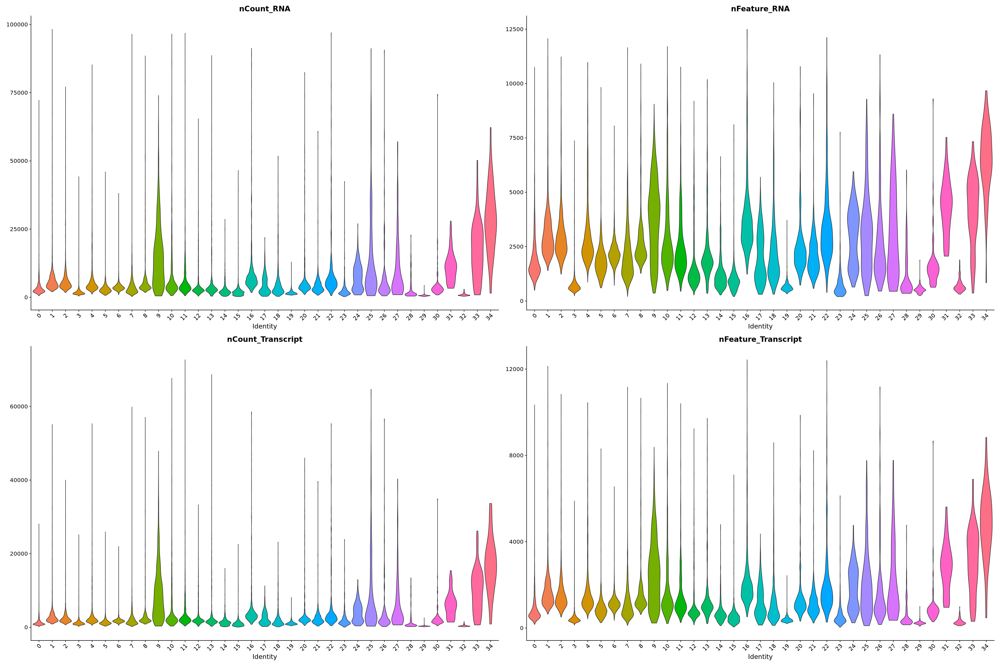

In [269]:
options(repr.plot.height = 20, repr.plot.width = 30)
VlnPlot(NS_combined_seurat, features = c("nCount_RNA", "nFeature_RNA", "nCount_Transcript", "nFeature_Transcript"), group.by = 'RNA_snn_res.2', ncol = 2, pt.size = 0)

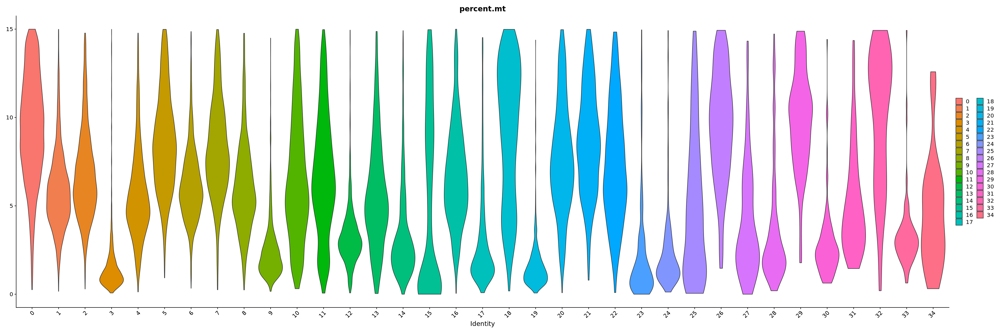

In [270]:
options(repr.plot.height = 10, repr.plot.width = 30)
VlnPlot(NS_combined_seurat, features = c("percent.mt"), group.by = 'RNA_snn_res.2',	ncol = 1, pt.size = 0)

In [210]:
epi = c("BCAM","TP63","KRT5","KRT15", "CAPS", "CAPSL", "TUBA1A", "TUBB4B", "FOXJ1", "EFHC1", "CCDC153", "CCDC113", "MLF1", "LZTFL1",
        "XBP1", "VMO1", "PIGR", "MUC5AC", "MUC5B", "MUC1", "MUC2", "MUC4","MUC16",
        "FOXN4", "CCNO", "MYCL", "CDC20B", "TUBA1B", "PCM1",
        "SCGB1A1","SCGB3A1","CYP2F1", "CYP2B6", 
        "SPRR1A", "SPRR2A", "SPRR2D", "SPRR2E",
        "FOXI1", "CFTR", "ASCL3",
        "TOP2A", "CENPF", "MKI67")
immune = c("CD3D", "CD3E", "CD3G", "CD4",
          "CD8A", "CD8B", "PRF1", "GZMA", "GZMB", "GNLY", "NKG7", "NCR1",
          "IL32", "KLRB1",
          "CD27", "CD19", "MS4A1", "IL4R", "FCRL1", "CD22", "CD79A",
          'XBP1', 'IRF4', 'SEC11C', 'PRDM1', "CD38", 'MZB1', "JCHAIN",
          "CD14", "CD68", "FCGR3A", "C1QB", "C1QC", "MARCO", "ITGAM",
          "TPSAB1", "CDK15", "CPA1",
          "ITGAX", "IL1R2", "NCF1", "LYN", "CSF3R",
          "MS4A2", "HPGDS", "GATA2",
          "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")

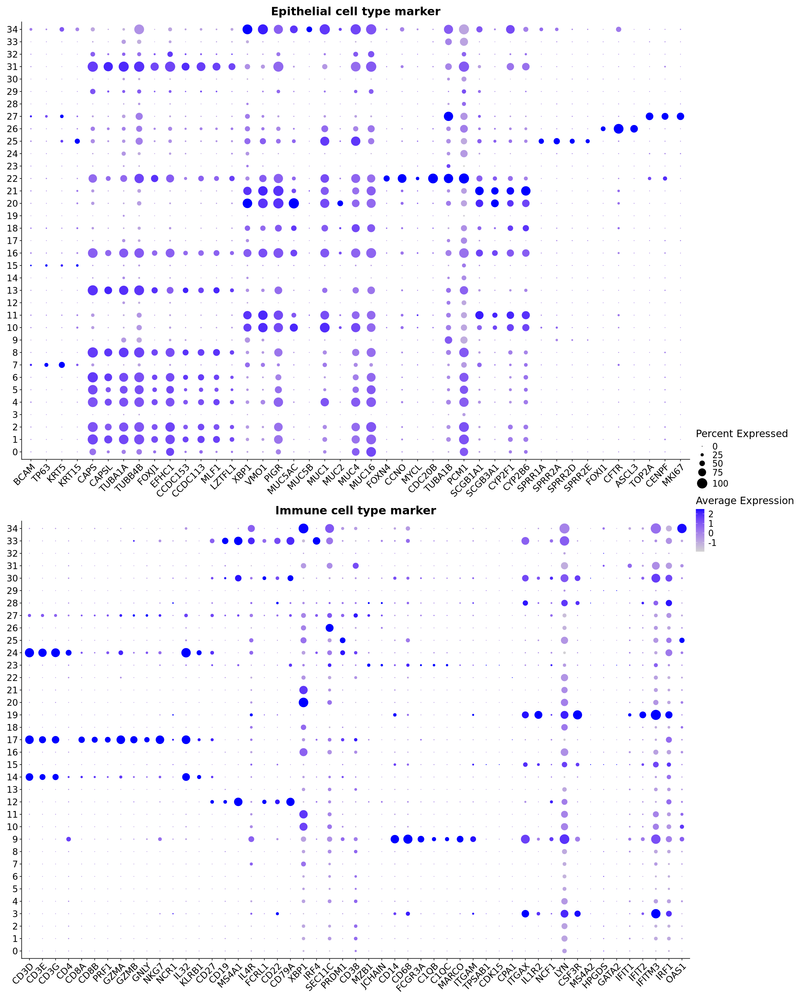

In [272]:
DefaultAssay(NS_combined_seurat) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat, features = epi, dot.scale = 8, group.by = 'RNA_snn_res.2') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat, features = immune, dot.scale = 8, group.by = 'RNA_snn_res.2') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=20, repr.plot.height=25)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

# First filter

In [11]:
dir <- "/sc-projects/sc-proj-dh-promethion/FLAMES_covid19/data_home/"
saveRDS(NS_combined_seurat, paste0(dir,"NS_IntegratedONT.rds"))

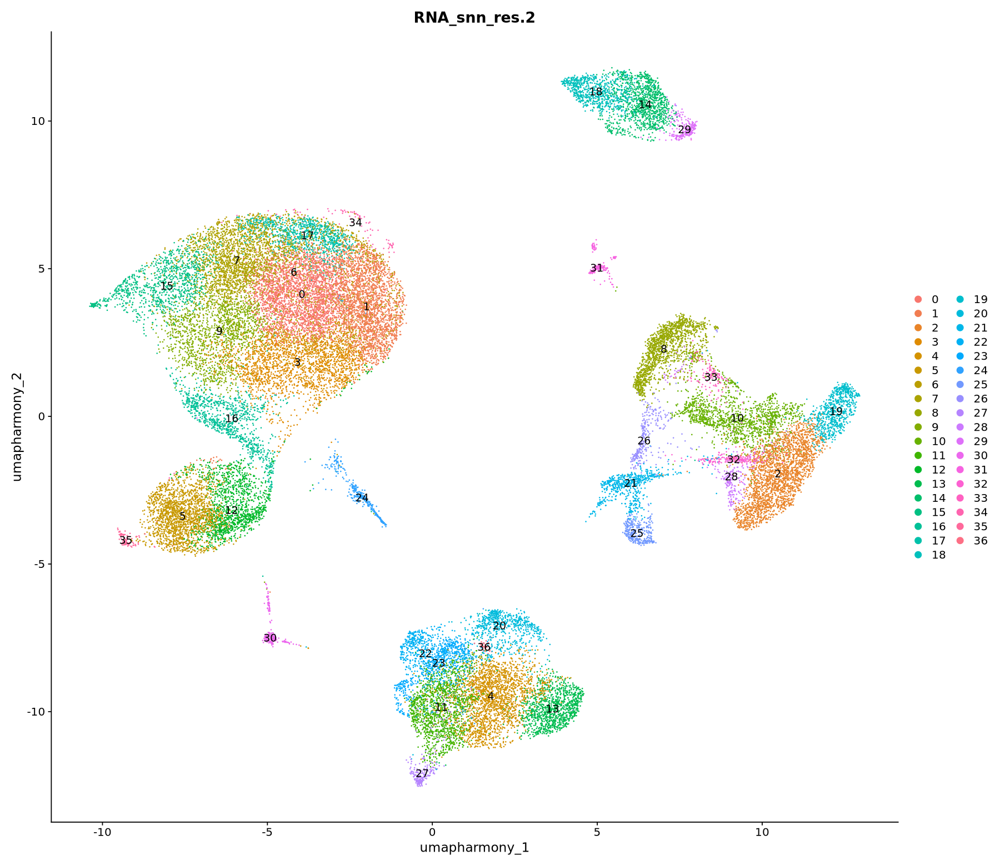

In [12]:
options(repr.plot.height = 13, repr.plot.width = 15)
DimPlot(NS_combined_seurat, reduction = "umap.harmony", group.by = c('RNA_snn_res.2'), pt.size = .1, label = TRUE)

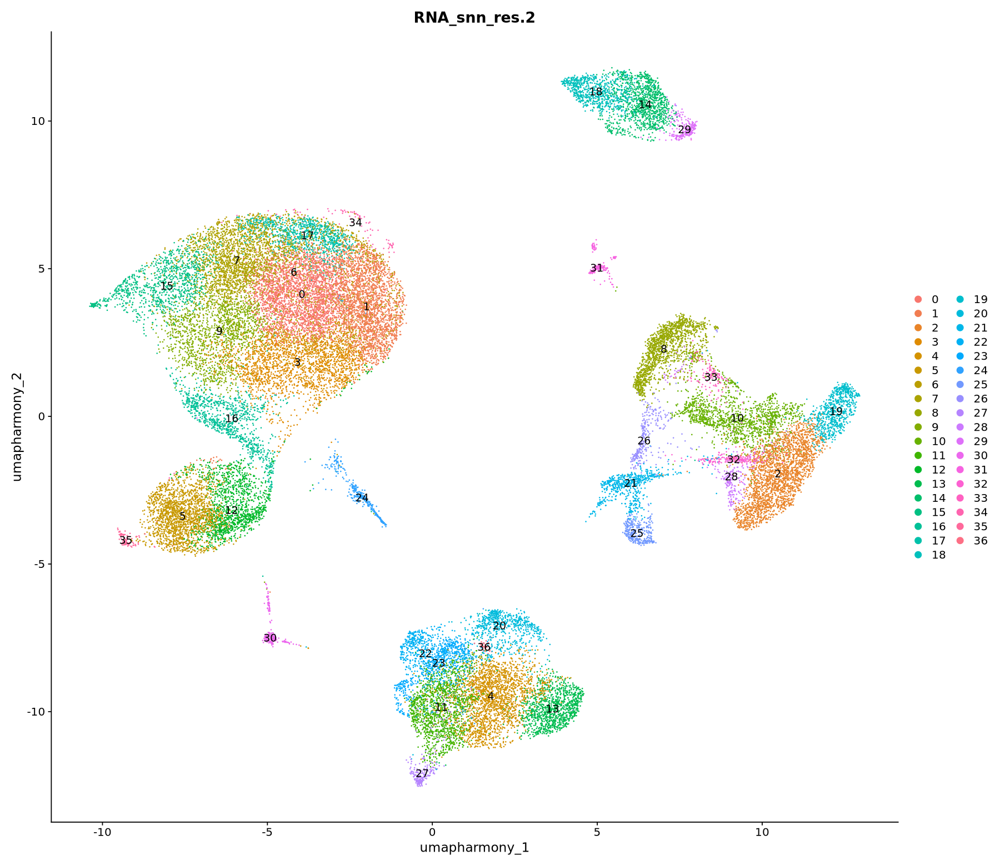

In [85]:
options(repr.plot.height = 13, repr.plot.width = 15)
DimPlot(NS_combined_seurat, reduction = "umap.harmony", group.by = c('RNA_snn_res.2'), pt.size = .1, label = TRUE)

In [13]:
filter_clusters = c('36', '33', ## doublets
                   '35', '32', '5', '12', ## low RNA
                    '21') ## basal, immune mix

In [14]:
NS_combined_seurat_filtered = NS_combined_seurat %>% subset(RNA_snn_res.2 %in% unique(NS_combined_seurat$`RNA_snn_res.2`)[!unique(NS_combined_seurat$`RNA_snn_res.2`) %in% filter_clusters])

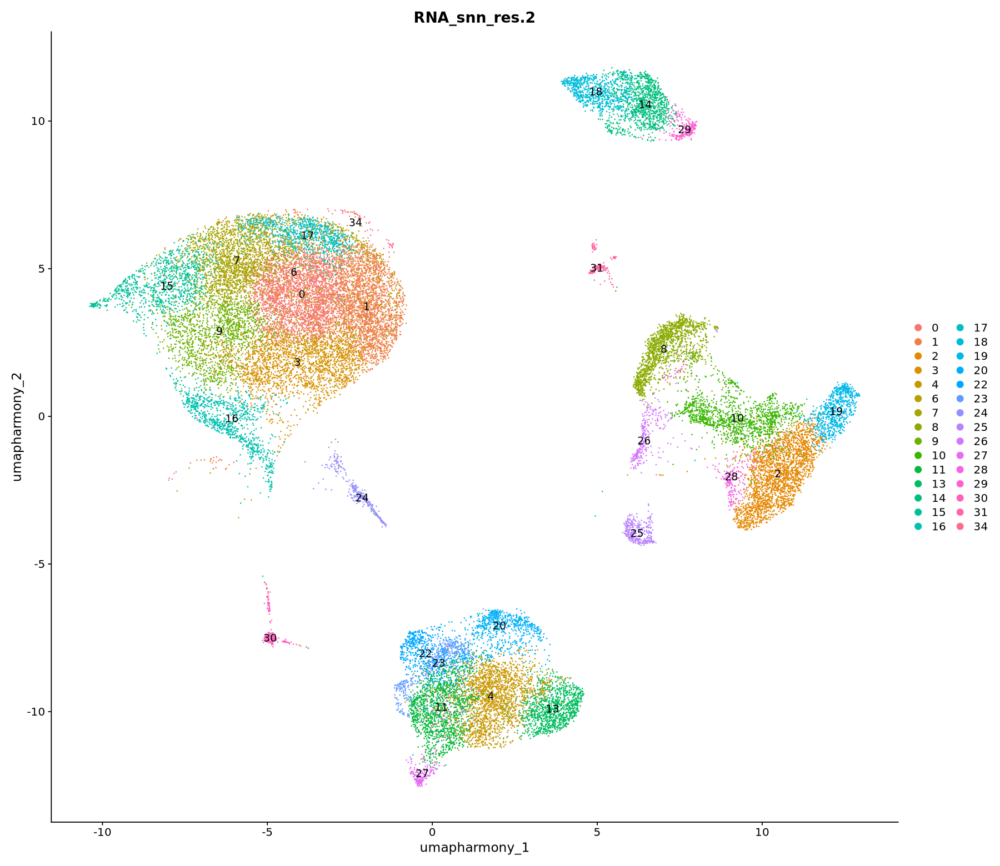

In [15]:
options(repr.plot.height = 13, repr.plot.width = 15)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c('RNA_snn_res.2'), pt.size = .1, label = TRUE)

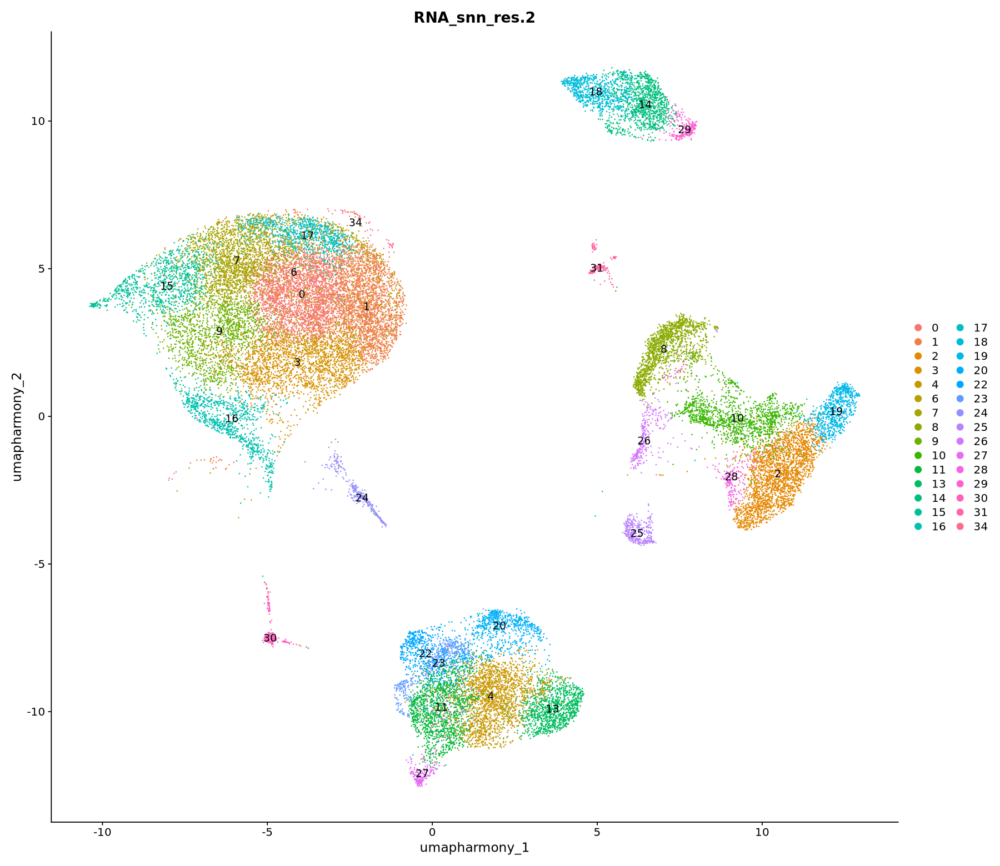

In [27]:
options(repr.plot.height = 13, repr.plot.width = 15)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c('RNA_snn_res.2'), pt.size = .1, label = TRUE)

In [16]:
NS_combined_seurat_filtered <- RunPCA(NS_combined_seurat_filtered, npcs = 90, verbose = FALSE)
NS_combined_seurat_filtered <- FindNeighbors(NS_combined_seurat_filtered, reduction = "harmony", dims = 1:30)
NS_combined_seurat_filtered <- FindClusters(NS_combined_seurat_filtered, resolution = c(0.5,1,1.5,2,3))

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 31546
Number of edges: 1093285

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9038
Number of communities: 18
Elapsed time: 9 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 31546
Number of edges: 1093285

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8638
Number of communities: 24
Elapsed time: 8 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 31546
Number of edges: 1093285

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8370
Number of communities: 29
Elapsed time: 6 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 31546
Number of edges: 1093285

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8165
Number of communities: 34
Elapsed time: 6 seconds
Modulari

In [17]:
NS_combined_seurat_filtered <- RunUMAP(NS_combined_seurat_filtered, reduction = "harmony", dims = 1:30, reduction.name = "umap.harmony")

15:59:41 UMAP embedding parameters a = 0.9922 b = 1.112

15:59:41 Read 31546 rows and found 30 numeric columns

15:59:41 Using Annoy for neighbor search, n_neighbors = 30

15:59:41 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:59:44 Writing NN index file to temp file /tmp/RtmpUmThuP/file3c69a04cb7b96

15:59:44 Searching Annoy index using 1 thread, search_k = 3000

15:59:53 Annoy recall = 100%

15:59:54 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

15:59:55 Initializing from normalized Laplacian + noise (using RSpectra)

15:59:57 Commencing optimization for 200 epochs, with 1392048 positive edges

16:00:13 Optimization finished



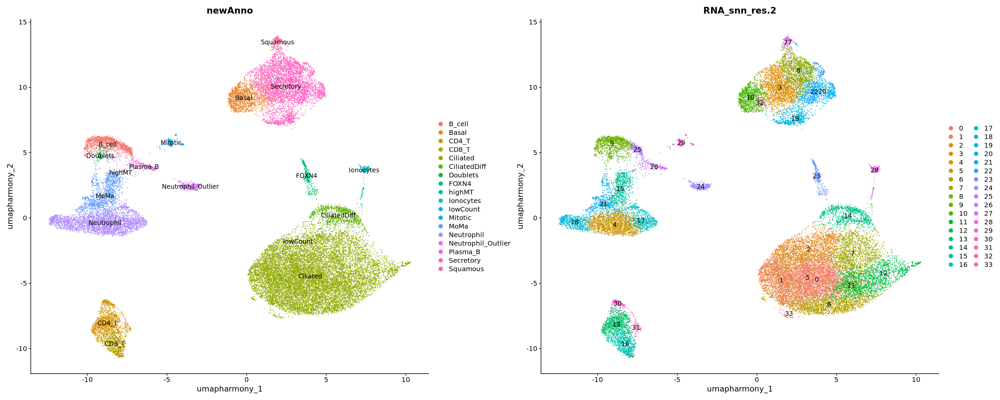

In [38]:
options(repr.plot.height = 10, repr.plot.width = 25)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c('newAnno', 'RNA_snn_res.2'), pt.size = .1, label = TRUE)

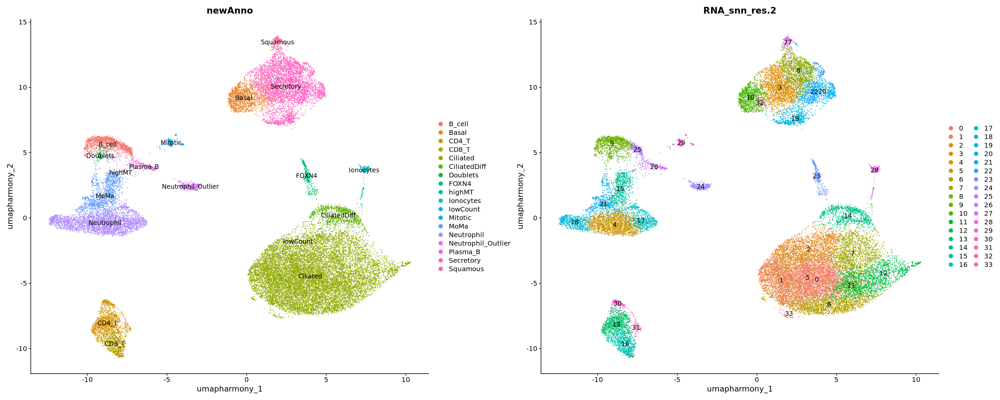

In [19]:
options(repr.plot.height = 10, repr.plot.width = 25)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c('newAnno', 'RNA_snn_res.2'), pt.size = .1, label = TRUE)

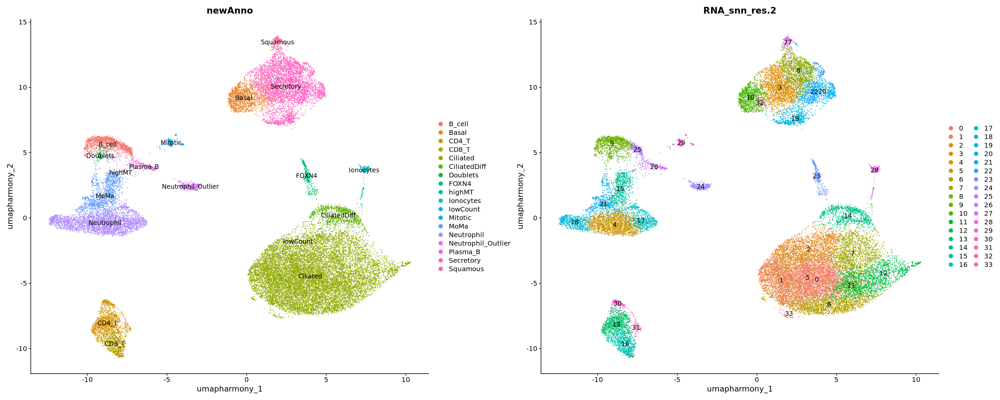

In [73]:
options(repr.plot.height = 10, repr.plot.width = 25)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c('newAnno', 'RNA_snn_res.2'), pt.size = .1, label = TRUE)

In [39]:
##res 1.5
newAnno_dict_precise = c('3' = 'Secretory_2', '9' = 'Secretory_3', '27' = 'Secretory_4', '17' = 'Secretory_5', '18' = 'Secretory_6',
                         '11' = 'BasalDiff', 
                         '24' = 'Squamous',
                         '0' = "Ciliated_1", '1' = "Ciliated_2", '2' = "Ciliated_3",  '5' = "Ciliated_4",  '6' = "Ciliated_5",  '10' = "Ciliated_6",  '13' = "Ciliated_7",
                         '28' = "Ciliated_Outlier", 
                         '14' = "CiliatedDiff", 
                         '19' = 'FOXN4',
                         '25' = 'Ionocytes', 
                         
                         '4' = "Neutrophil_1", '15' = "Neutrophil_2", '22' = "Neutrophil_3",
                         '20' = 'Neutrophil_Outlier', 
                         '8' = 'MoMa',
                         '7' = 'B_cell',
                         '21' = 'Plasma_B',
                         '26' = 'Mitotic',
                         '16' = 'CD8_T', '12' = 'CD4_T_1', '23' = 'CD4_T_2'
                       )

In [40]:
##res 0.5
newAnno_dict_collapsed = c('1' = 'Secretory', '10' = 'Secretory', '8' = 'BasalDiff', 
                 '16' = 'Squamous',
                 '0' = "Ciliated", '2' = "Ciliated", '4' = "Ciliated", '17' = "Ciliated", 
                 '9' = "CiliatedDiff", 
                 '12' = 'FOXN4',
                 '14' = 'Ionocytes', 
                 
                 '3' = "Neutrophil", '11' = 'Neutrophil_Outlier', 
                 '7' = 'MoMa',
                 '6' = 'B_cell',
                 '13' = 'Plasma_B',
                 '15' = 'Mitotic',
                 '5' = 'T_cell'
           )

In [41]:
##res 0.5
newAnno_dict = c('1' = 'Secretory_1', '10' = 'Secretory_2', '8' = 'BasalDiff', 
                 '16' = 'Squamous',
                 '0' = "Ciliated_1", '2' = "Ciliated_2", '4' = "Ciliated_3", '17' = "Ciliated_Outlier", 
                 '9' = "CiliatedDiff", 
                 '12' = 'FOXN4',
                 '14' = 'Ionocytes', 
                 
                 '3' = "Neutrophil_1", '11' = 'Neutrophil_Outlier', 
                 '7' = 'MoMa',
                 '6' = 'B_cell',
                 '13' = 'Plasma_B',
                 '15' = 'Mitotic',
                 '5' = 'T_cell'
           )

In [42]:
newAnno_coll = newAnno_dict_collapsed[as.character(NS_combined_seurat_filtered$`RNA_snn_res.0.5`)]
newAnno = newAnno_dict[as.character(NS_combined_seurat_filtered$`RNA_snn_res.0.5`)]
newAnno_prec = newAnno_dict_precise[as.character(NS_combined_seurat_filtered$`RNA_snn_res.1.5`)]

In [36]:
#newAnno[NS_combined_seurat_filtered$`RNA_snn_res.2` == 31] = 'MoMa_Outlier'
#newAnno[NS_combined_seurat_filtered$`RNA_snn_res.2` == 18] = 'CD8_T'
#newAnno[NS_combined_seurat_filtered$`RNA_snn_res.2` == 25] = 'Plasma_B'

In [24]:
NS_combined_seurat_filtered

An object of class Seurat 
160487 features across 31546 samples within 2 assays 
Active assay: RNA (32460 features, 2000 variable features)
 3 layers present: data, counts, scale.data
 1 other assay present: Transcript
 5 dimensional reductions calculated: pca, umap.unintegrated, harmony, umap.harmony, umap

In [43]:
NS_combined_seurat_filtered = AddMetaData(NS_combined_seurat_filtered, unname(newAnno), col.name = 'newAnno_0.5')
NS_combined_seurat_filtered = AddMetaData(NS_combined_seurat_filtered, unname(newAnno_prec), col.name = 'newAnno_1.5')
NS_combined_seurat_filtered = AddMetaData(NS_combined_seurat_filtered, unname(newAnno_coll), col.name = 'newAnno_collapsed')

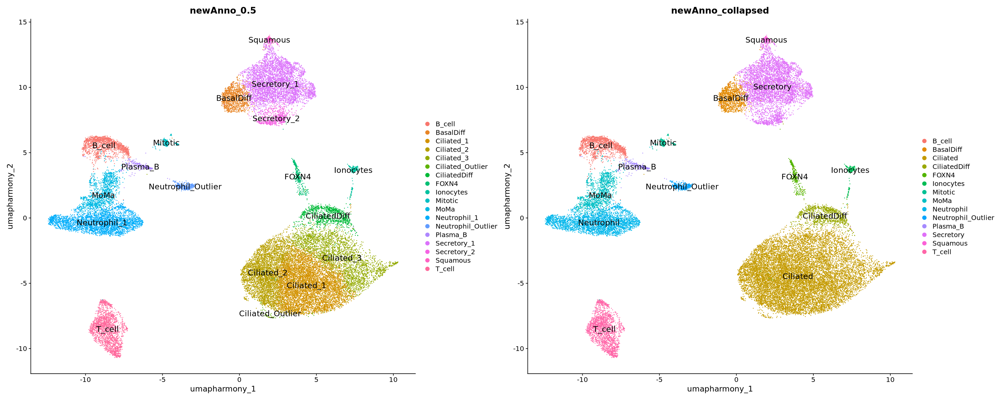

In [48]:
options(repr.plot.height = 10, repr.plot.width = 25)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c("newAnno_0.5", 'newAnno_collapsed') , pt.size = .1, label = TRUE, label.size = 5, ncol = 2)

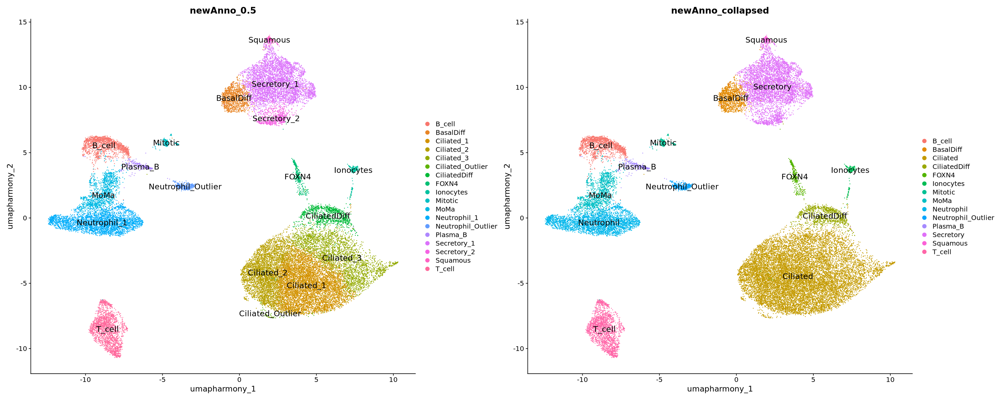

In [26]:
options(repr.plot.height = 10, repr.plot.width = 25)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c("newAnno_0.5", 'newAnno_collapsed') , pt.size = .1, label = TRUE, label.size = 5, ncol = 2)

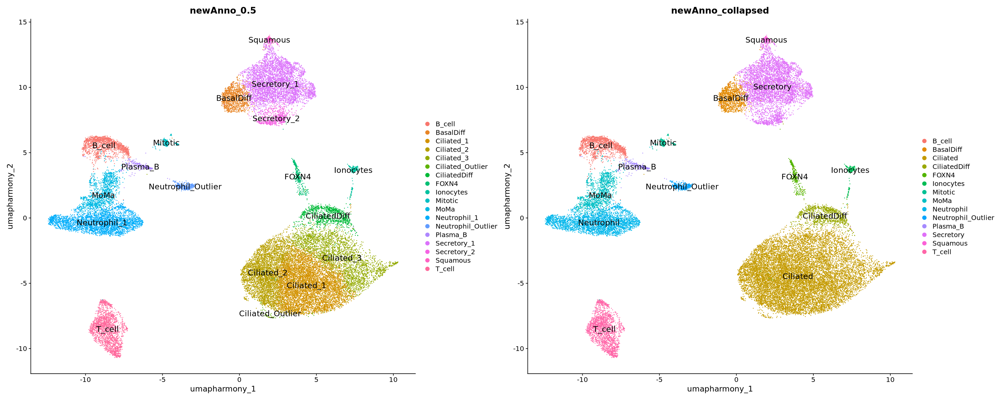

In [98]:
options(repr.plot.height = 10, repr.plot.width = 25)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c("newAnno_0.5", 'newAnno_collapsed') , pt.size = .1, label = TRUE, label.size = 5, ncol = 2)

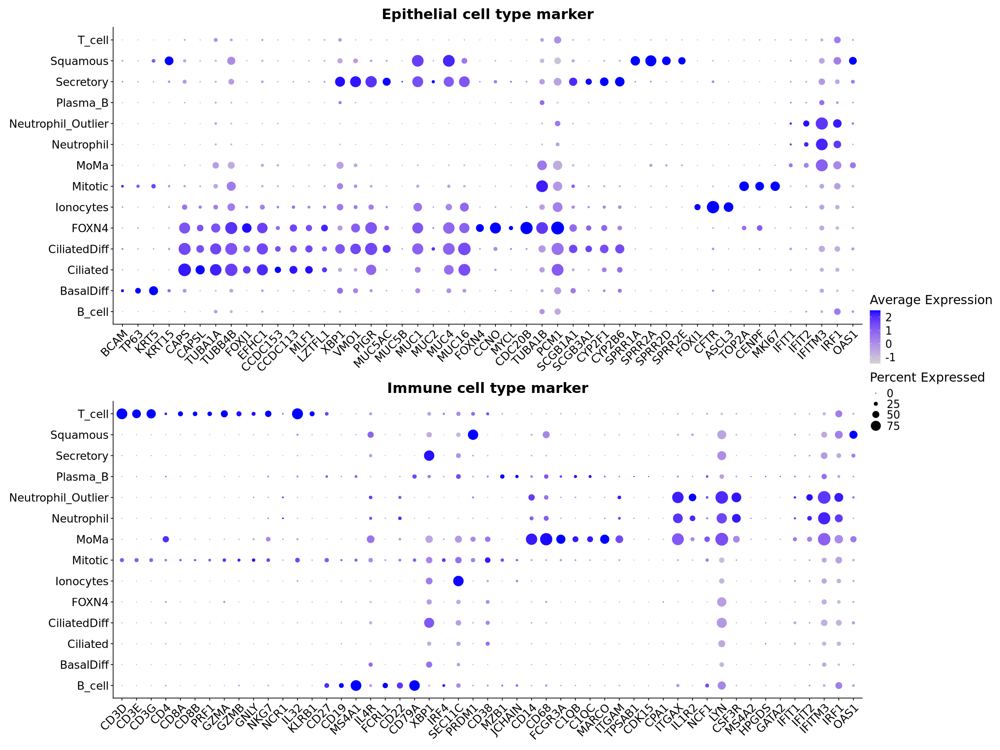

In [27]:
epi = c("BCAM","TP63","KRT5","KRT15", "CAPS", "CAPSL", "TUBA1A", "TUBB4B", "FOXJ1", "EFHC1", "CCDC153", "CCDC113", "MLF1", "LZTFL1",
        "XBP1", "VMO1", "PIGR", "MUC5AC", "MUC5B", "MUC1", "MUC2", "MUC4","MUC16",
        "FOXN4", "CCNO", "MYCL", "CDC20B", "TUBA1B", "PCM1",
        "SCGB1A1","SCGB3A1","CYP2F1", "CYP2B6", 
        "SPRR1A", "SPRR2A", "SPRR2D", "SPRR2E",
        "FOXI1", "CFTR", "ASCL3",
        "TOP2A", "CENPF", "MKI67", 
        "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")
immune = c("CD3D", "CD3E", "CD3G", "CD4",
          "CD8A", "CD8B", "PRF1", "GZMA", "GZMB", "GNLY", "NKG7", "NCR1",
          "IL32", "KLRB1",
          "CD27", "CD19", "MS4A1", "IL4R", "FCRL1", "CD22", "CD79A",
          'XBP1', 'IRF4', 'SEC11C', 'PRDM1', "CD38", 'MZB1', "JCHAIN",
          "CD14", "CD68", "FCGR3A", "C1QB", "C1QC", "MARCO", "ITGAM",
          "TPSAB1", "CDK15", "CPA1",
          "ITGAX", "IL1R2", "NCF1", "LYN", "CSF3R",
          "MS4A2", "HPGDS", "GATA2",
          "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")

DefaultAssay(NS_combined_seurat_filtered) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat_filtered, features = epi, dot.scale = 8, group.by = 'newAnno_collapsed') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat_filtered, features = immune, dot.scale = 8, group.by = 'newAnno_collapsed') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=20, repr.plot.height=15)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

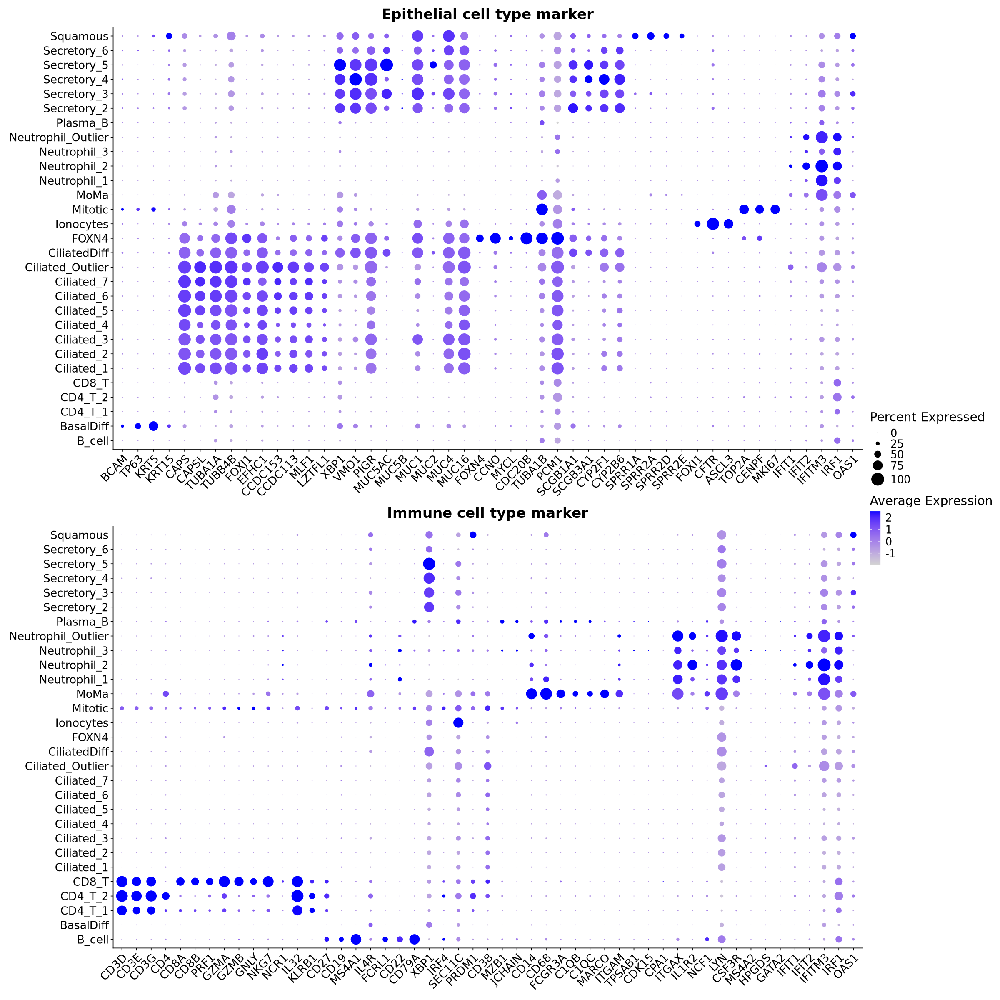

In [28]:
epi = c("BCAM","TP63","KRT5","KRT15", "CAPS", "CAPSL", "TUBA1A", "TUBB4B", "FOXJ1", "EFHC1", "CCDC153", "CCDC113", "MLF1", "LZTFL1",
        "XBP1", "VMO1", "PIGR", "MUC5AC", "MUC5B", "MUC1", "MUC2", "MUC4","MUC16",
        "FOXN4", "CCNO", "MYCL", "CDC20B", "TUBA1B", "PCM1",
        "SCGB1A1","SCGB3A1","CYP2F1", "CYP2B6", 
        "SPRR1A", "SPRR2A", "SPRR2D", "SPRR2E",
        "FOXI1", "CFTR", "ASCL3",
        "TOP2A", "CENPF", "MKI67", 
        "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")
immune = c("CD3D", "CD3E", "CD3G", "CD4",
          "CD8A", "CD8B", "PRF1", "GZMA", "GZMB", "GNLY", "NKG7", "NCR1",
          "IL32", "KLRB1",
          "CD27", "CD19", "MS4A1", "IL4R", "FCRL1", "CD22", "CD79A",
          'XBP1', 'IRF4', 'SEC11C', 'PRDM1', "CD38", 'MZB1', "JCHAIN",
          "CD14", "CD68", "FCGR3A", "C1QB", "C1QC", "MARCO", "ITGAM",
          "TPSAB1", "CDK15", "CPA1",
          "ITGAX", "IL1R2", "NCF1", "LYN", "CSF3R",
          "MS4A2", "HPGDS", "GATA2",
          "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")

DefaultAssay(NS_combined_seurat_filtered) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat_filtered, features = epi, dot.scale = 8, group.by = 'newAnno_1.5') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat_filtered, features = immune, dot.scale = 8, group.by = 'newAnno_1.5') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=20, repr.plot.height=20)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

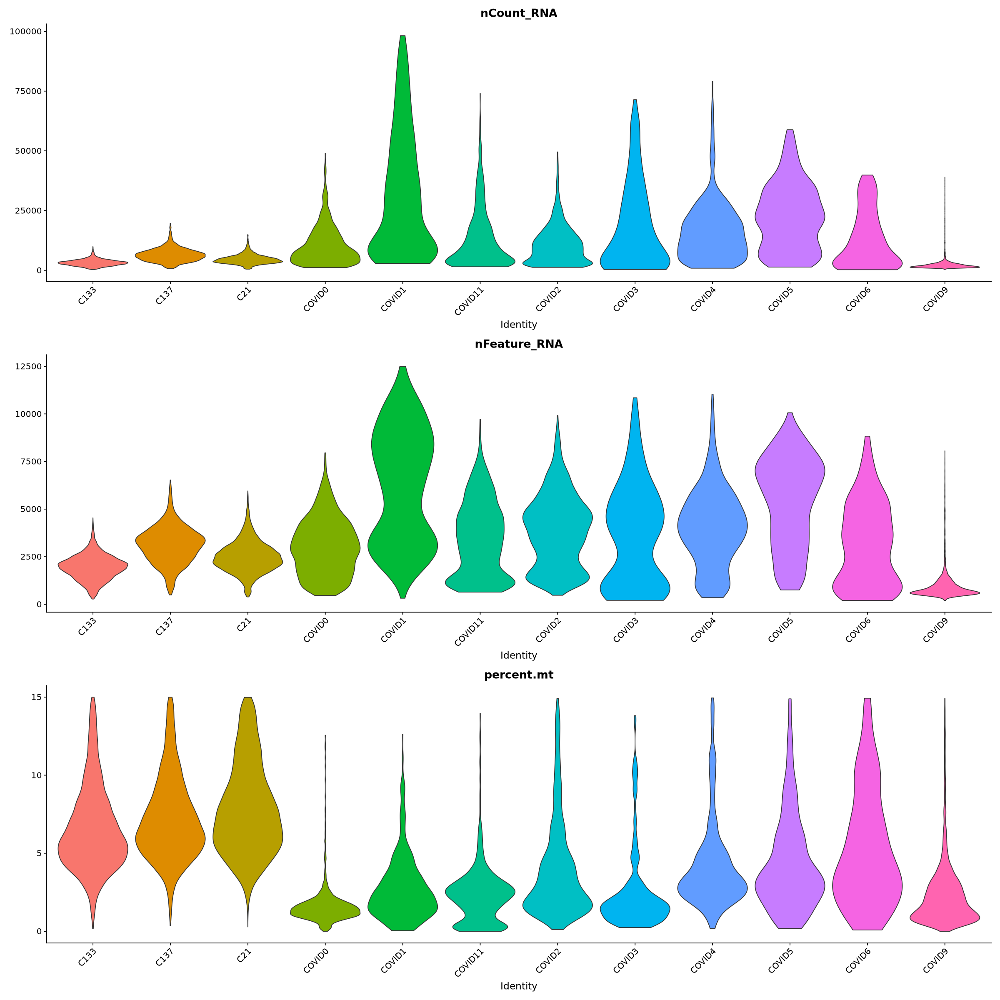

In [29]:
options(repr.plot.height = 20, repr.plot.width = 20)
VlnPlot(NS_combined_seurat_filtered, features = c("nCount_RNA", "nFeature_RNA", "percent.mt"), group.by = 'orig.ident',	ncol = 1, pt.size = 0)

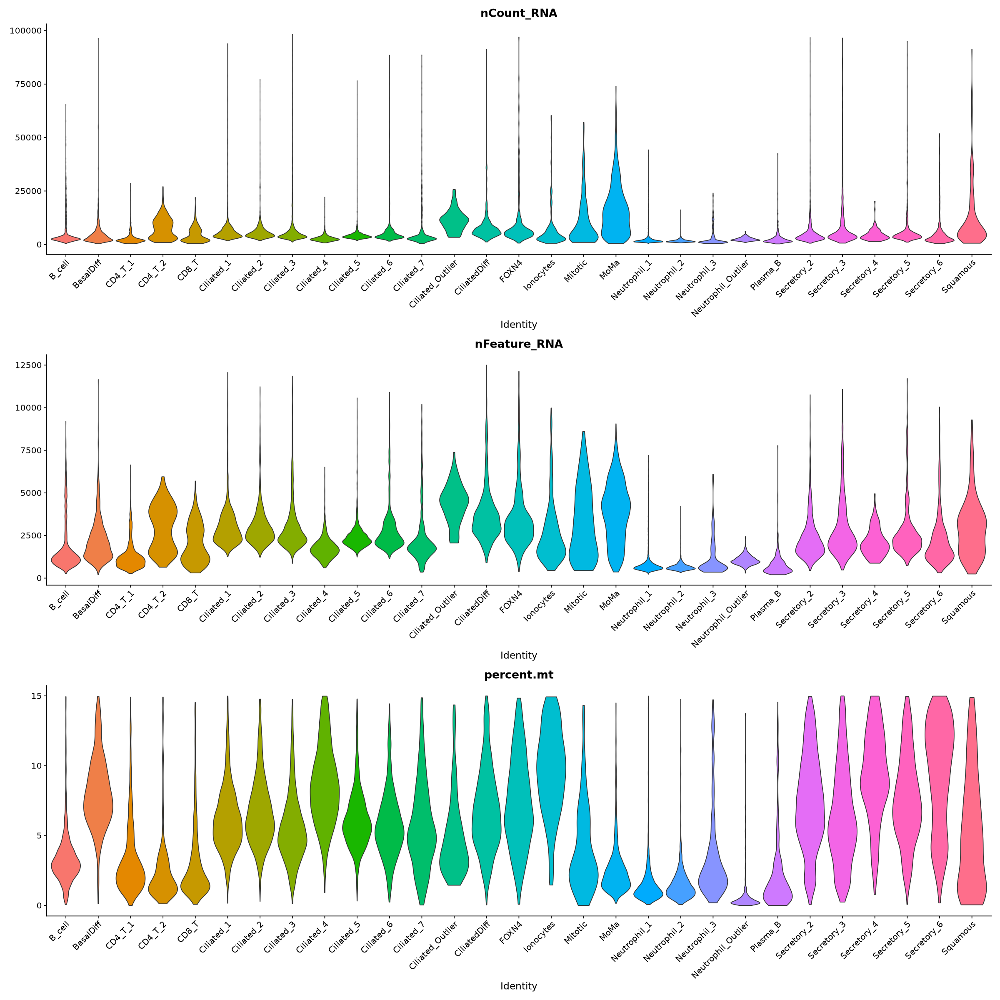

In [113]:
options(repr.plot.height = 20, repr.plot.width = 20)
VlnPlot(NS_combined_seurat_filtered, features = c("nCount_RNA", "nFeature_RNA", "percent.mt"), group.by = 'newAnno_1.5',	ncol = 1, pt.size = 0)

In [30]:
dir <- "/sc-projects/sc-proj-dh-promethion/ONT_sc-wf_COVID/seurat_data/"
saveRDS(NS_combined_seurat_filtered, paste0(dir,"NS_IntegratedONT_Filtered_New.rds"))

## Get markers genes

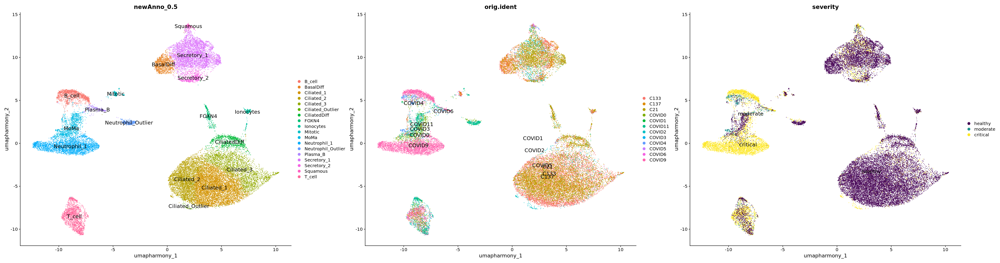

In [5]:
options(repr.plot.height = 10, repr.plot.width = 38)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c("newAnno_0.5", 'orig.ident', 'severity') , pt.size = .1, label = TRUE, label.size = 5, ncol = 3)

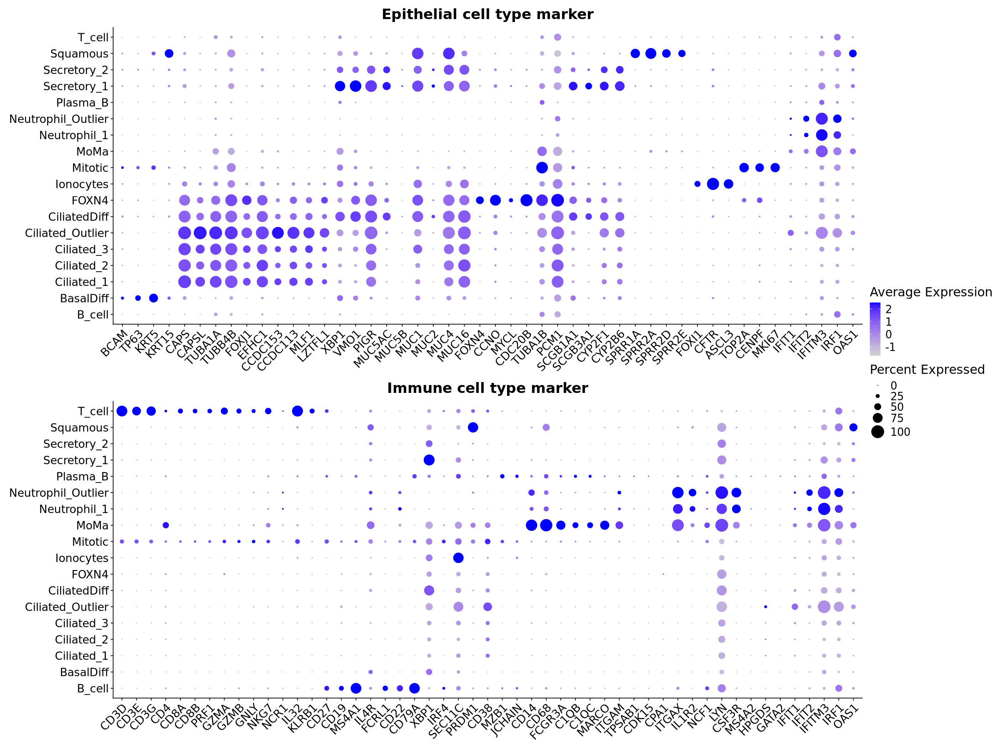

In [112]:
epi = c("BCAM","TP63","KRT5","KRT15", "CAPS", "CAPSL", "TUBA1A", "TUBB4B", "FOXJ1", "EFHC1", "CCDC153", "CCDC113", "MLF1", "LZTFL1",
        "XBP1", "VMO1", "PIGR", "MUC5AC", "MUC5B", "MUC1", "MUC2", "MUC4","MUC16",
        "FOXN4", "CCNO", "MYCL", "CDC20B", "TUBA1B", "PCM1",
        "SCGB1A1","SCGB3A1","CYP2F1", "CYP2B6", 
        "SPRR1A", "SPRR2A", "SPRR2D", "SPRR2E",
        "FOXI1", "CFTR", "ASCL3",
        "TOP2A", "CENPF", "MKI67", 
        "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")
immune = c("CD3D", "CD3E", "CD3G", "CD4",
          "CD8A", "CD8B", "PRF1", "GZMA", "GZMB", "GNLY", "NKG7", "NCR1",
          "IL32", "KLRB1",
          "CD27", "CD19", "MS4A1", "IL4R", "FCRL1", "CD22", "CD79A",
          'XBP1', 'IRF4', 'SEC11C', 'PRDM1', "CD38", 'MZB1', "JCHAIN",
          "CD14", "CD68", "FCGR3A", "C1QB", "C1QC", "MARCO", "ITGAM",
          "TPSAB1", "CDK15", "CPA1",
          "ITGAX", "IL1R2", "NCF1", "LYN", "CSF3R",
          "MS4A2", "HPGDS", "GATA2",
          "IFIT1", "IFIT2", "IFITM3", "IRF1", "OAS1")

DefaultAssay(NS_combined_seurat_filtered) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat_filtered, features = epi, dot.scale = 8, group.by = 'newAnno_0.5') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat_filtered, features = immune, dot.scale = 8, group.by = 'newAnno_0.5') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=20, repr.plot.height=15)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

In [104]:
Idents(NS_combined_seurat_filtered) = 'newAnno_0.5'

In [108]:
immune_types = c("Neutrophil_1", 'MoMa', 'B_cell', 'Plasma_B', 'T_cell')

In [109]:
neu_out = FindMarkers(NS_combined_seurat_filtered, ident.1 = 'Neutrophil_Outlier', ident.2 = immune_types, only.pos = TRUE)

In [111]:
head(neu_out, 20) %>% rownames()

[1] "AC072022.2" "CARD17"     "AC004917.1" "MXD1"       "FCGR3B"    
 [6] "NEAT1"      "GAB2"       "MARCKS"     "LITAF"      "FNDC3B"    
[11] "ACSL1"      "AC112496.1" "RNF149"     "FGF13"      "LCP2"      
[16] "DOCK4"      "CPD"        "AC005050.3" "TLR2"       "CLEC7A"

In [115]:
plasma = FindMarkers(NS_combined_seurat_filtered, ident.1 = 'Plasma_B', only.pos = TRUE)

In [116]:
head(plasma, 20) %>% rownames()

[1] "MZB1"     "IGKC"     "JCHAIN"   "IGHGP"    "IGLV3-1"  "IGLV6-57"
 [7] "DPEP1"    "IGLV3-19" "IGHG2"    "LGALS1"   "IGLC1"    "IGHA1"   
[13] "RPL10"    "RPLP1"    "IGLV2-23" "HLA-DPB1" "IGLC2"    "TPT1"    
[19] "CD79A"    "RPL13"

In [364]:
head(c_neu_outlier, 20)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AC072022.2,3.653352e-191,4.208048,0.443,0.036,1.185878e-186
KIF1BP,3.296181e-148,4.834521,0.296,0.016,1.069940e-143
AC022973.4,4.390129e-118,7.405966,0.191,0.005,1.425036e-113
PIK3R6,4.161605e-108,3.607405,0.326,0.041,1.350857e-103
RESF1,2.906886e-100,2.357522,0.751,0.334,9.435753e-96
LINC00278,1.787677e-98,4.320992,0.274,0.030,5.802798e-94
AC112496.1,6.919822e-94,8.232275,0.136,0.001,2.246174e-89
DDX3Y,5.607357e-86,5.335717,0.189,0.013,1.820148e-81
MXD1,7.848828e-85,1.793188,0.828,0.528,2.547729e-80


In [6]:
library(dplyr)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [4]:
critical = c('COVID0','COVID2', 'COVID5', 'COVID6', 'COVID9', 'COVID11')
moderate = c('COVID1','COVID3', 'COVID4')
healthy = c('C133', 'C137', 'C21')
severity = ifelse(NS_combined_seurat_filtered[[]][['orig.ident']] %in% critical, 'critical', 
                  ifelse(NS_combined_seurat_filtered[[]][['orig.ident']] %in% moderate, 'moderate', 'healthy'))
severity <- factor(severity,
    levels = c('healthy','moderate', 'critical'), ordered = TRUE)
NS_combined_seurat_filtered = AddMetaData(NS_combined_seurat_filtered, severity, col.name = 'severity')

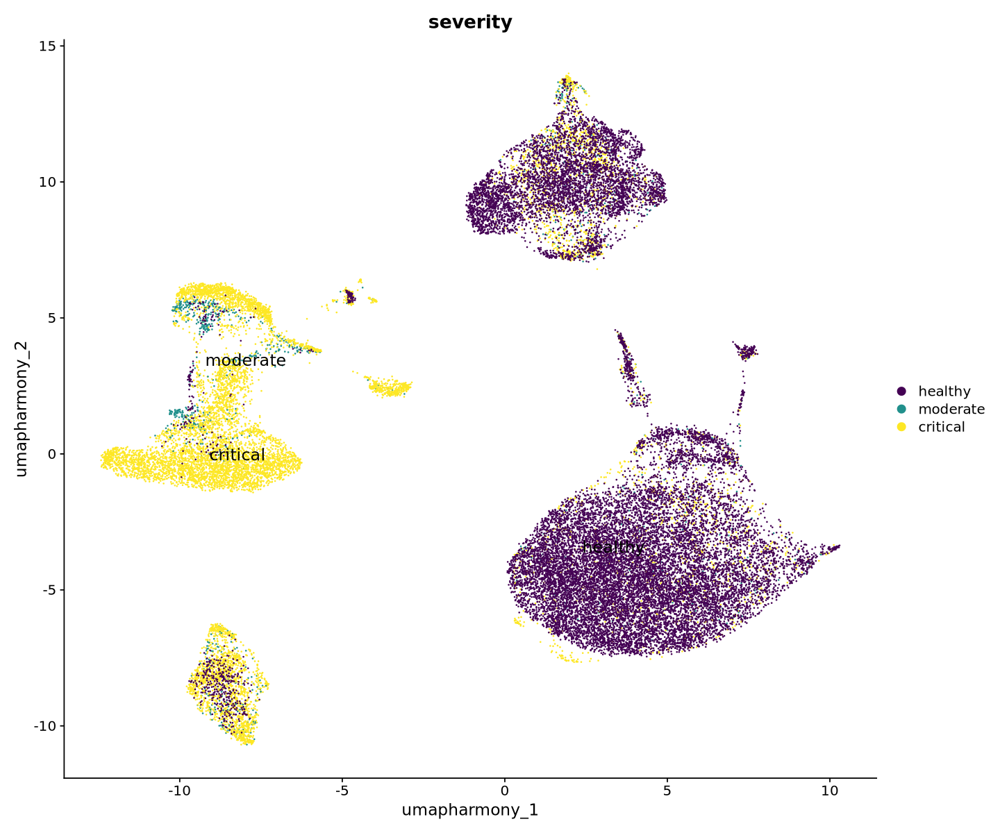

In [8]:
options(repr.plot.height = 10, repr.plot.width = 12)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c("severity") , pt.size = .1, label = TRUE, label.size = 5, ncol = 1)

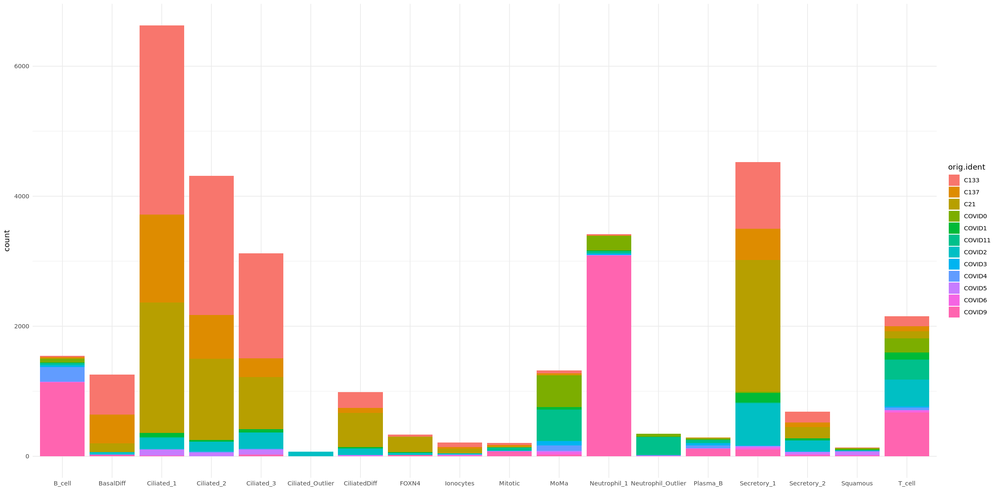

In [124]:
options(repr.plot.height = 10, repr.plot.width = 20)
NS_combined_seurat_filtered[[]] %>% ggplot() + geom_bar(aes(x=newAnno_0.5, fill = orig.ident)) + theme_minimal() + xlab('')

# New Filter

In [27]:
dir <- "/sc-projects/sc-proj-dh-promethion/ONT_sc-wf_COVID/seurat_data/"
NS_combined_seurat = readRDS(paste0(dir,"NS_IntegratedONT.rds"))

In [1]:
dir <- "/sc-projects/sc-proj-dh-promethion/ONT_sc-wf_COVID/seurat_data/"
NS_combined_seurat_filtered = readRDS(paste0(dir,"NS_IntegratedONT_Filtered_New.rds"))

In [2]:
NS_combined_seurat_filtered

An object of class Seurat 
160487 features across 31546 samples within 2 assays 
Active assay: RNA (32460 features, 2000 variable features)
 3 layers present: data, counts, scale.data
 1 other assay present: Transcript
 6 dimensional reductions calculated: pca, umap.unintegrated, harmony, umap.harmony, umap, umap.harmony.adapted

In [29]:
unique(NS_combined_seurat_filtered$severity)

[1] critical moderate healthy 
Levels: healthy moderate critical

In [45]:
#NS_combined_seurat_filtered$newAnno_collapsed2 = ifelse(startsWith(NS_combined_seurat_filtered$newAnno_collapsed, "Neu"), #"Neutrophil_combined", NS_combined_seurat_filtered$newAnno_collapsed)

In [6]:
critical = c('COVID0','COVID2', 'COVID5', 'COVID6', 'COVID9', 'COVID11')
moderate = c('COVID1','COVID3', 'COVID4')
healthy = c('C133', 'C137', 'C21')
severity = ifelse(NS_combined_seurat_filtered[[]][['orig.ident']] %in% critical, 'critical', 
                  ifelse(NS_combined_seurat_filtered[[]][['orig.ident']] %in% moderate, 'moderate', 'healthy'))
severity <- factor(severity,
    levels = c('healthy','moderate', 'critical'), ordered = TRUE)
NS_combined_seurat_filtered = AddMetaData(NS_combined_seurat_filtered, severity, col.name = 'severity')

In [7]:
immune = c('Neutrophil', 'MoMa', 'B_cell', 'T_cell', 'Plasma_B', 'Neutrophil_Outlier')
epithelium = c('Secretory', 'Squamous', 'Mitotic', 'Ciliated', 'FOXN4', 'CiliatedDiff', 'BasalDiff', 'Ionocytes', 'Mitotic')

NS_combined_seurat_filtered$celltype = ifelse(NS_combined_seurat_filtered$newAnno_collapsed %in% immune, "immune", "epithelium")
#NS_combined_seurat_filtered$celltype[NS_combined_seurat_filtered$newAnno_collapsed=="Mitotic"] = 'Mitotic'

In [8]:
NS_combined_seurat_filtered$condition = ifelse(NS_combined_seurat_filtered$severity == 'healthy', 'Control', 'COVID-19')

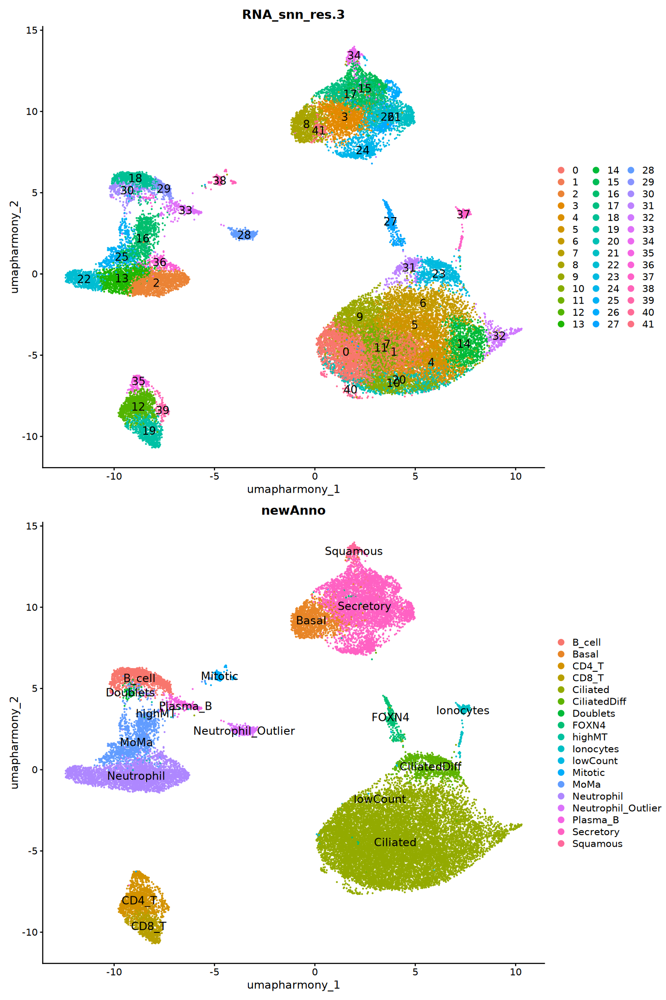

In [9]:
options(repr.plot.height = 18, repr.plot.width = 12)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c("RNA_snn_res.3", "newAnno") , pt.size = .1, label = TRUE, label.size = 5, ncol = 1)

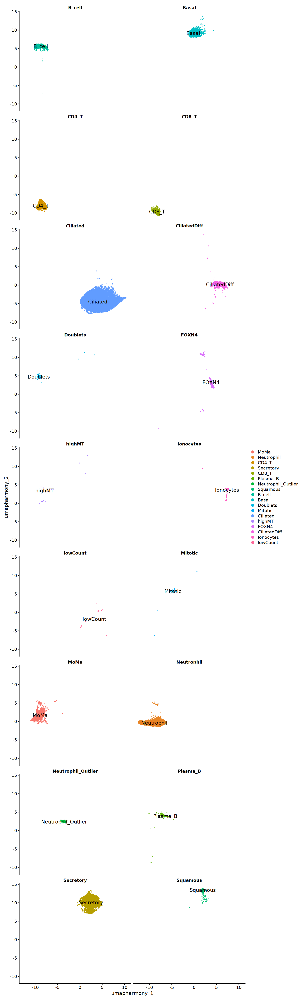

In [47]:
options(repr.plot.height = 40, repr.plot.width = 12)
Idents(NS_combined_seurat_filtered) = "newAnno"
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", split.by = c("newAnno") , pt.size = .1, label = TRUE, label.size = 5, ncol = 2)

In [ ]:
ct_levels = c('Neutrophil', "Neutrophil_Outlier" 'MoMa', 'B_cell', 
              'CD4_T', 'CD8_T', 'T_lowComplexity' , ## immune levels
              'Basal', 'Secretory', 'FOXN4', 'IFN_high', 'CiliatedDiff_Stress', 'CiliatedDiff',
              'Ciliated', 'Ionocyte', 'Mitotic', 'Squamous' ##epithelial levels
              )

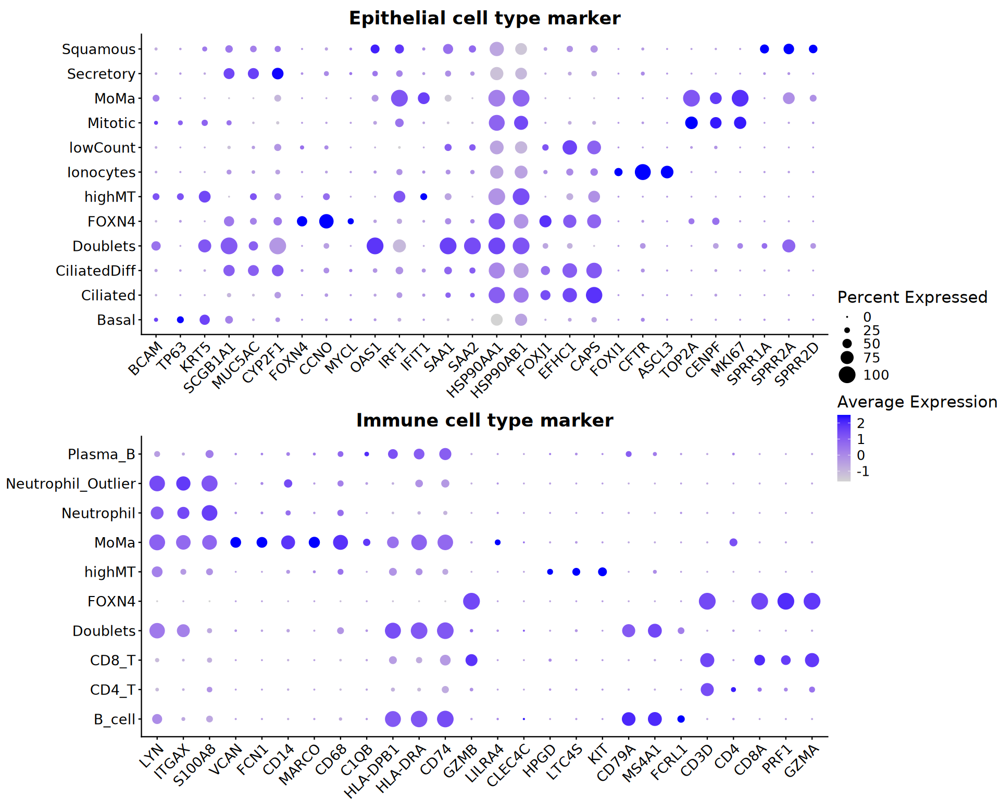

In [43]:
epi = c("BCAM","TP63","KRT5",                             ## Basal
        "SCGB1A1", "MUC5AC", "CYP2F1",                    ## Secretory
        "FOXN4", "CCNO", "MYCL",                          ## FOXN4
        "OAS1", "IRF1", "IFIT1",                          ## highIFN
        "SAA1", "SAA2", "HSP90AA1", "HSP90AB1",           ## Stressed Ciliated 
        "FOXJ1", "EFHC1", "CAPS",                         ## Ciliated
        "FOXI1", "CFTR", "ASCL3",                         ## Ionocytes
        "TOP2A", "CENPF", "MKI67",                         ## Mitotic
        "SPRR1A", "SPRR2A", "SPRR2D"                     ## Squamous
        )

immune = c("LYN", "ITGAX", "S100A8",                      ## Neutrophil
           "VCAN", "FCN1", "CD14",                        ## Monocyte            
           "MARCO", "CD68", "C1QB",                       ## Macrophage
           "HLA-DPB1", "HLA-DRA", "CD74",                 ## cDCs
           "GZMB", "LILRA4", "CLEC4C",                    ## pDC
           "HPGD", "LTC4S", "KIT",                        ## Mast
           "CD79A", "MS4A1", "FCRL1",                     ## B cells
           "CD3D",                                        ## Tcell
           "CD4",                                         ## CD4                     
           "CD8A",                                         ## CD8 
           "PRF1", "GZMA"                                 ## CD8
            )       

DefaultAssay(NS_combined_seurat_filtered) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat_filtered %>% subset(celltype == 'epithelium'), features = epi, dot.scale = 8, group.by = 'newAnno') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat_filtered %>% subset(celltype == 'immune'), features = immune, dot.scale = 8, group.by = 'newAnno') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=16, repr.plot.height=13)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

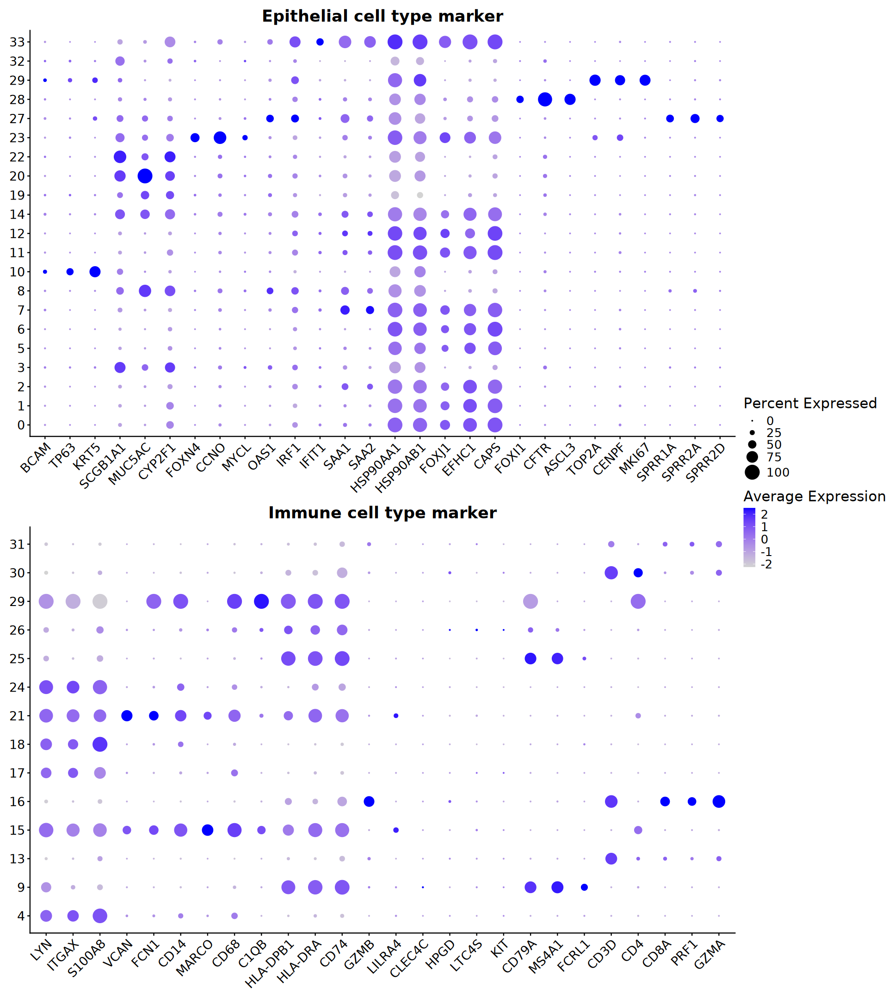

In [50]:
epi = c("BCAM","TP63","KRT5",                             ## Basal
        "SCGB1A1", "MUC5AC", "CYP2F1",                    ## Secretory
        "FOXN4", "CCNO", "MYCL",                          ## FOXN4
        "OAS1", "IRF1", "IFIT1",                          ## highIFN
        "SAA1", "SAA2", "HSP90AA1", "HSP90AB1",           ## Stressed Ciliated 
        "FOXJ1", "EFHC1", "CAPS",                         ## Ciliated
        "FOXI1", "CFTR", "ASCL3",                         ## Ionocytes
        "TOP2A", "CENPF", "MKI67",                         ## Mitotic
        "SPRR1A", "SPRR2A", "SPRR2D"                     ## Squamous
        )

immune = c("LYN", "ITGAX", "S100A8",                      ## Neutrophil
           "VCAN", "FCN1", "CD14",                        ## Monocyte            
           "MARCO", "CD68", "C1QB",                       ## Macrophage
           "HLA-DPB1", "HLA-DRA", "CD74",                 ## cDCs
           "GZMB", "LILRA4", "CLEC4C",                    ## pDC
           "HPGD", "LTC4S", "KIT",                        ## Mast
           "CD79A", "MS4A1", "FCRL1",                     ## B cells
           "CD3D",                                        ## Tcell
           "CD4",                                         ## CD4                     
           "CD8A",                                         ## CD8 
           "PRF1", "GZMA"                                 ## CD8
            )       

DefaultAssay(NS_combined_seurat_filtered) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat_filtered %>% subset(celltype == 'epithelium'), features = epi, dot.scale = 8, group.by = 'RNA_snn_res.2') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat_filtered %>% subset(celltype == 'immune'), features = immune, dot.scale = 8, group.by = 'RNA_snn_res.2') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type marker") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=16, repr.plot.height=18)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

In [ ]:
options(repr.plot.width=20, repr.plot.height=7)
VlnPlot(NS_combined_seurat_filtered, group.by = "newAnno" , features = c('nCount_RNA', 'nFeature_RNA', 'percent.mt'), pt.size = 0)

In [63]:
##res 0.5
newAnno_dict = c('3' = 'Secretory', '8' = 'Secretory', '20' = 'Secretory', '22' = 'Secretory', '19' = 'Secretory','32' = 'Secretory',
                 '10' = 'Basal', 
                 '27' = 'Squamous',
                 '0' = "Ciliated", '1' = "Ciliated", '2' = "Ciliated", '5' = "Ciliated", '6' = "Ciliated", '7' = "Ciliated", '11' = "Ciliated", '12' = "Ciliated", '33' = 'Ciliated',

                 '14' = "CiliatedDiff", 
                 '23' = 'FOXN4',
                 '28' = 'Ionocyte',
                 '29' = 'Mitotic',
                 '4' = "Neutrophil",'17' = "Neutrophil",'18' = "Neutrophil",
                 '24' = 'Neutrophil_Outlier', 
                 '21' = 'MoMa','15' = 'MoMa',
                 '9' = 'B_cell','25' = 'B_cell',
                 '26' = 'Mast_cell',
                 '13' = 'CD4_T', '30' = 'CD4_T',
                 '31' = 'CD4_T', '16' = 'CD8_T'
           )

In [64]:
NS_combined_seurat_filtered = AddMetaData(NS_combined_seurat_filtered, unname(newAnno_dict[as.character(NS_combined_seurat_filtered$`RNA_snn_res.2`)]), col.name = 'finalAnno')

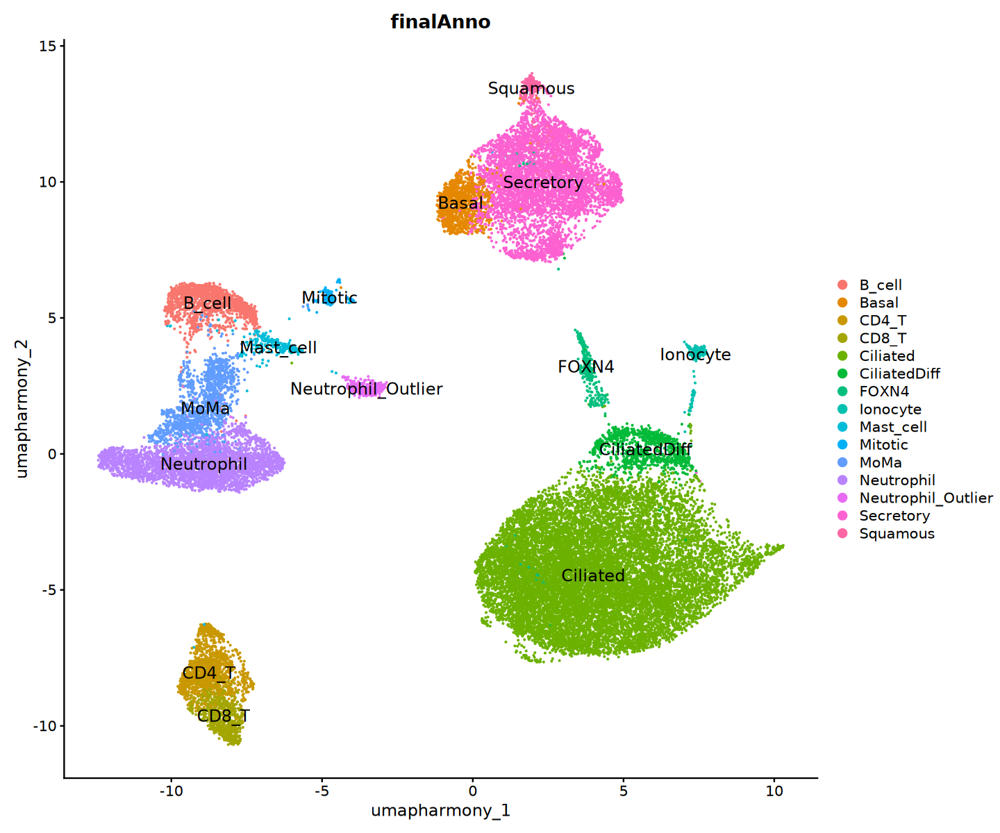

In [65]:
options(repr.plot.height = 10, repr.plot.width = 12)
DimPlot(NS_combined_seurat_filtered, reduction = "umap.harmony", group.by = c("finalAnno") , pt.size = .1, label = TRUE, label.size = 5, ncol = 1)

In [66]:
immune = c('Neutrophil', 'Neutrophil_Outlier', 'MoMa', 'Mast_cell', 'B_cell', 
              'CD4_T', 'CD8_T')
epithelium = c('Basal', 'Secretory', 'Ciliated', 'CiliatedDiff', 'FOXN4',
              'Ciliated', 'Ionocyte', 'Mitotic', 'Squamous')


NS_combined_seurat_filtered$celltype = ifelse(NS_combined_seurat_filtered$finalAnno %in% immune, 'immune', 'epithelium')

In [67]:
ct_levels = c('Neutrophil', 'Neutrophil_Outlier', 'MoMa', 'Mast_cell', 'B_cell', 
              'CD4_T', 'CD8_T' , ## immune levels
              'Basal', 'Secretory', 'CiliatedDiff', 'FOXN4',
              'Ciliated', 'Ionocyte', 'Mitotic', 'Squamous' ##epithelial levels
              )
NS_combined_seurat_filtered$finalAnno = factor(NS_combined_seurat_filtered$finalAnno, 
                                             levels = ct_levels)

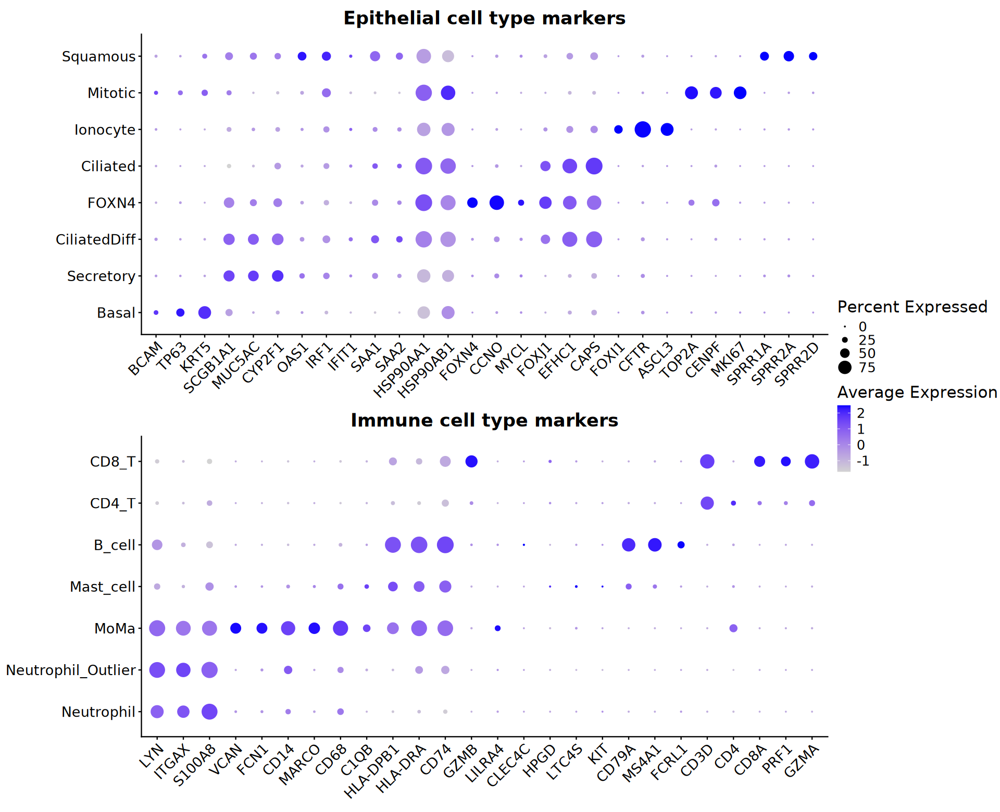

In [68]:
epi = c("BCAM","TP63","KRT5",                             ## Basal
        "SCGB1A1", "MUC5AC", "CYP2F1",                    ## Secretory
        "OAS1", "IRF1", "IFIT1",                          ## highIFN
        "SAA1", "SAA2", "HSP90AA1", "HSP90AB1",           ## Stressed Ciliated 
        "FOXN4", "CCNO", "MYCL",                          ## FOXN4
        "FOXJ1", "EFHC1", "CAPS",                         ## Ciliated
        "FOXI1", "CFTR", "ASCL3",                         ## Ionocytes
        "TOP2A", "CENPF", "MKI67",                         ## Mitotic
        "SPRR1A", "SPRR2A", "SPRR2D"                     ## Squamous
        )

immune = c("LYN", "ITGAX", "S100A8",                      ## Neutrophil
           "VCAN", "FCN1", "CD14",                        ## Monocyte            
           "MARCO", "CD68", "C1QB",                       ## Macrophage
           "HLA-DPB1", "HLA-DRA", "CD74",                 ## cDCs
           "GZMB", "LILRA4", "CLEC4C",                    ## pDC
           "HPGD", "LTC4S", "KIT",                        ## Mast
           "CD79A", "MS4A1", "FCRL1",                     ## B cells
           "CD3D",                                        ## Tcell
           "CD4",                                         ## CD4                     
           "CD8A",                                         ## CD8 
           "PRF1", "GZMA"                                 ## CD8
            )     

DefaultAssay(NS_combined_seurat_filtered) <- "RNA"

plt_epi = DotPlot(NS_combined_seurat_filtered %>% subset(celltype == 'epithelium'), features = epi, dot.scale = 8, group.by = 'finalAnno') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Epithelial cell type markers") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18)) 

plt_immun = DotPlot(NS_combined_seurat_filtered %>% subset(celltype == 'immune'), features = immune, dot.scale = 8, group.by = 'finalAnno') + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1, size = 16), 
          axis.text.y = element_text(size = 16)) +
    ggtitle("Immune cell type markers") +
    theme(axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          plot.title = element_text(hjust = 0.5),
          text = element_text(size = 18),
          legend.position='none')

options(repr.plot.width=16, repr.plot.height=13)

combi_plt2 <- (plt_epi/plt_immun) + plot_layout(guide='collect') #& theme(legend.position = 'bottom')
combi_plt2

In [54]:
DefaultAssay(NS_combined_seurat_filtered) = 'Transcript'

In [55]:
NS_combined_seurat_filtered

An object of class Seurat 
160487 features across 31546 samples within 2 assays 
Active assay: Transcript (128027 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 5 dimensional reductions calculated: pca, umap.unintegrated, harmony, umap.harmony, umap

In [94]:
NS_combined_seurat_filtered = NormalizeData(NS_combined_seurat_filtered, assay = 'Transcript')

In [95]:
NS_combined_seurat_filtered

An object of class Seurat 
160487 features across 31546 samples within 2 assays 
Active assay: Transcript (128027 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 5 dimensional reductions calculated: pca, umap.unintegrated, harmony, umap.harmony, umap

In [58]:
DefaultAssay(NS_combined_seurat_filtered) = 'RNA'
neu_out_markers = FindMarkers(NS_combined_seurat_filtered, ident.1 = 'Neutrophil_Outlier', ident.2 = 'Neutrophil', only.pos = TRUE)

In [61]:
head(neu_out_markers, 20) |> rownames()

[1] "AC072022.2" "KIF1BP"     "AC022973.4" "AC112496.1" "PIK3R6"    
 [6] "MXD1"       "E2F3-IT1"   "RESF1"      "DDX3Y"      "PLXDC2"    
[11] "AL137789.1" "CFLAR-AS1"  "LY6E"       "LINC00278"  "AC009032.1"
[16] "CARD17"     "CMTM1"      "PSAP"       "PICALM"     "AC090970.1"

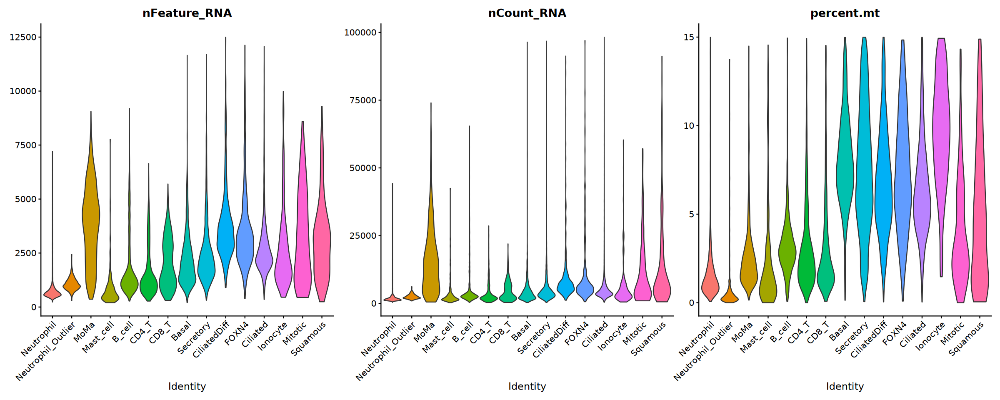

In [69]:
options(repr.plot.height = 8, repr.plot.width = 20)
VlnPlot(NS_combined_seurat_filtered, features = c('nFeature_RNA', 'nCount_RNA', 'percent.mt'), group.by = 'finalAnno', pt.size = 0) #& ylim(c(0,5000))

In [70]:
dir <- "/sc-projects/sc-proj-dh-promethion/ONT_sc-wf_COVID/seurat_data/"
saveRDS(NS_combined_seurat_filtered, paste0(dir,"NS_IntegratedONT_Filtered_New.rds"))